<a href="https://colab.research.google.com/github/olszewskip/musings/blob/master/Copy_of_vae_adventures_7.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
import itertools
from keras.preprocessing.image import ImageDataGenerator
from keras.layers import Dense, Input, Dropout, BatchNormalization
from keras.layers import Conv2D, MaxPooling2D, Flatten, Lambda
from keras.layers import Reshape, UpSampling2D, Conv2DTranspose
from keras.layers import LeakyReLU, ELU
from keras.layers import concatenate, add
from keras.models import Sequential, Model
from keras.datasets import mnist
from keras.losses import sparse_categorical_crossentropy, categorical_crossentropy, mse, binary_crossentropy
from keras.metrics import sparse_categorical_accuracy
from keras.optimizers import Adam, Adamax, Nadam
from IPython.display import SVG
from keras.utils.vis_utils import plot_model, model_to_dot
from keras.utils import to_categorical
from keras import backend as K
from keras.callbacks import Callback
import numpy as np
import matplotlib.pyplot as plt
import os

Using TensorFlow backend.


In [0]:
from google.colab import drive
drive.mount('/content/gdrive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3Aietf%3Awg%3Aoauth%3A2.0%3Aoob&scope=email%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdocs.test%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fdrive.photos.readonly%20https%3A%2F%2Fwww.googleapis.com%2Fauth%2Fpeopleapi.readonly&response_type=code

Enter your authorization code:
··········
Mounted at /content/gdrive


In [0]:
working_dir = os.path.join("/content/gdrive/My Drive/Colab Notebooks/Sign_Language/")
github_data_dir = os.path.join(working_dir, "data/ardamavi/Dataset")

os.listdir(github_data_dir)

['0', '5', '3', '6', '2', '9', '4', '7', '8', '1']

In [0]:
image_dim = 100

image_shape = (image_dim, image_dim, 3)

latent_dim = 128

Define data-generators that will augment the images. We do not leave any images for "testing", however defined. We just wanna have fun with this project.

In [0]:
data_gen = ImageDataGenerator(rescale=1/255,\
                              rotation_range=30,\
                              height_shift_range=0.05,\
                              width_shift_range=0.05,\
                              zoom_range=0.05)
Xy_gen =\
data_gen.flow_from_directory(github_data_dir,
                             target_size = (image_dim, image_dim),
                             batch_size = 32,
                             shuffle=True,
                             class_mode='sparse',
                             seed=123)

def get_images_classes_gen():
  while True:
    images, classes = next(Xy_gen)
    yield [images, classes], None

images_classes_gen = get_images_classes_gen()
    
def get_images_gen():
  while True:
    images, _ = next(Xy_gen)
    yield images, None
    
images_gen = get_images_gen()

Found 2062 images belonging to 10 classes.


Also, put some images into RAM, to have a fixed sample to play with and evaluate on.

In [0]:
# maybe restart me several times, dunno...

image_batches = []
class_batches = []

for _ in range(100):
  images, labels = next(Xy_gen)
  image_batches.append(images)
  class_batches.append(labels)
    
sample_images = np.concatenate(image_batches)
sample_classes = np.concatenate(class_batches)

Xy_gen.reset()

In [0]:
sample_images.shape, sample_classes.shape

((3182, 100, 100, 3), (3182,))

Define the wide-to-narrow piece: the encoder.

In [0]:
# image encoder

real_images = Input(shape=image_shape, name='real_images')
x = Conv2D(filters=32,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='valid')(real_images)
x = LeakyReLU(alpha=0.2)(x)
x = Conv2D(filters=64,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='valid')(x)
x = LeakyReLU(alpha=0.2)(x)
x = Conv2D(filters=128,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='valid')(x)
x = LeakyReLU(alpha=0.2)(x)
x = Conv2D(filters=256,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='valid')(x)
x = LeakyReLU(alpha=0.2)(x)

y = Conv2D(filters=32,
           kernel_size=3,
           activation='elu',
           padding='same')(real_images)
y = MaxPooling2D(2)(y)
y = Conv2D(filters=64,
           kernel_size=3,
           activation='elu',
           padding='same')(y)
y = MaxPooling2D(2)(y)
y = Conv2D(filters=128,
           kernel_size=3,
           activation='elu',
           padding='same')(y)
y = MaxPooling2D(2)(y)
y = Conv2D(filters=256,
           kernel_size=3,
           activation='elu',
           padding='valid')(y)
y = MaxPooling2D(2)(y)

assert(K.int_shape(y) == K.int_shape(x))
narrow_shape = K.int_shape(x)

x = concatenate([x, y])

x = Flatten()(x)

z_mean = Dense(latent_dim,\
               activation=None,\
               name='z_mean')(x)
z_log_sigma2 = Dense(latent_dim,\
                     activation=None,\
                     name='z_log_sigma2')(x)

encoder = Model(inputs=real_images,\
                outputs=[z_mean, z_log_sigma2],
                name='encoder')

W0715 07:23:06.324092 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0715 07:23:06.380076 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0715 07:23:06.382182 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.

W0715 07:23:06.491583 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3976: The name tf.nn.max_pool is deprecated. Please use tf.nn.max_pool2d instead.



In [0]:
encoder.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
real_images (InputLayer)        (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 49, 49, 32)   896         real_images[0][0]                
__________________________________________________________________________________________________
conv2d_5 (Conv2D)               (None, 100, 100, 32) 896         real_images[0][0]                
__________________________________________________________________________________________________
leaky_re_lu_1 (LeakyReLU)       (None, 49, 49, 32)   0           conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_poolin

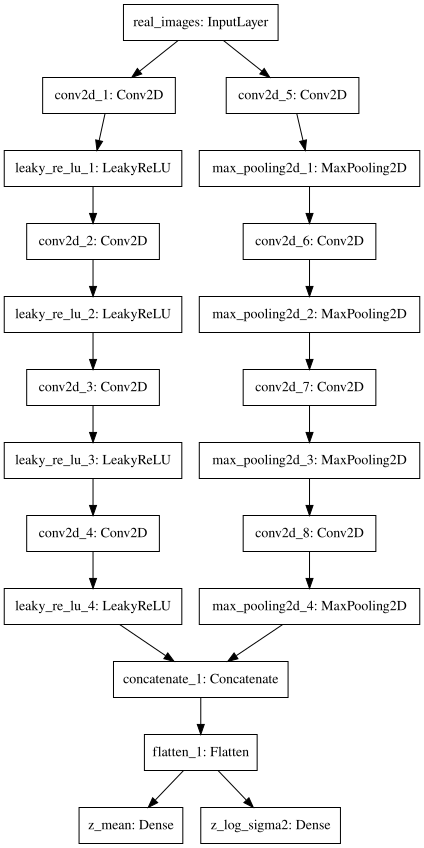

In [0]:
SVG(model_to_dot(encoder).create(prog='dot', format='svg'))

For it to be a *variational* encoder, we'll need to sample from a distribution around the compressed image.

In [0]:
def latent_sampling(args):
  z_mean, z_log_sigma2 = args
  batch_size = K.shape(z_mean)[0]
  dim = K.int_shape(z_mean)[1]
  epsilon = K.random_normal(shape=(batch_size, dim))
  return z_mean + K.exp(0.5 * z_log_sigma2) * epsilon

LatentSamplingLayer = Lambda(latent_sampling,\
                             name='latent_sampling')

Aside from sampling from, we will also fit a simple classifier on the latent space.

In [0]:
# latent-space classifier

z = Input(shape=(latent_dim,), name='z_from_outside')
x = Dense(256, activation='relu')(z)
predicted_latent_classes = Dense(10, activation='softmax')(x)

latent_clf = Model(inputs=z,\
                   outputs=predicted_latent_classes,\
                   name = 'latent_classifier')

Now, in order to go from-narrow-back-to-fullsize, we define the decoder.

In [0]:
# image decoder

z_from_outside = Input(shape=(latent_dim,), name='z_from_outside')

z = Dense(narrow_shape[1] * narrow_shape[2] * narrow_shape[3],\
          activation=None)(z_from_outside)
z = Reshape(narrow_shape[1:])(z)

z = BatchNormalization()(z)
z = ELU(alpha=2.0)(z)

x = Conv2DTranspose(filters=256,
                    kernel_size=3,
                    activation=None,
                    strides=2,
                    padding='same')(z)
y = UpSampling2D(2)(z)
y = Conv2D(filters=256,
           kernel_size=3,
           activation=None,
           strides=1,
           padding='same')(y)

z = concatenate([x, y])
z = BatchNormalization()(z)
z = ELU(alpha=2.0)(z)

x = Conv2DTranspose(filters=128,
                    kernel_size=7,
                    activation=None,
                    strides=5,
                    padding='same')(z)
y = UpSampling2D(5)(z)
y = Conv2D(filters=128,
           kernel_size=7,
           activation=None,
           strides=1,
           padding='same')(y)
z = concatenate([x, y])
z = BatchNormalization()(z)
z = ELU(alpha=2.0)(z)

x = Conv2DTranspose(filters=64,
                    kernel_size=3,
                    activation='elu',
                    strides=2,
                    padding='same')(z)
y = UpSampling2D(2)(z)
y = Conv2D(filters=64,
           kernel_size=2,
           activation=None,
           strides=1,
           padding='same')(y)
z = concatenate([x, y])
z = BatchNormalization()(z)
z = ELU(alpha=2.0)(z)

fake_images = Conv2D(filters=3,
                     kernel_size=3,
                     activation='sigmoid',
                     padding='same',
                     name='fake_images')(z)

decoder = Model(inputs=z_from_outside,\
                outputs=fake_images,\
                name='decoder')

W0715 07:42:21.749116 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:174: The name tf.get_default_session is deprecated. Please use tf.compat.v1.get_default_session instead.

W0715 07:42:21.750830 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:181: The name tf.ConfigProto is deprecated. Please use tf.compat.v1.ConfigProto instead.

W0715 07:42:24.867628 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:1834: The name tf.nn.fused_batch_norm is deprecated. Please use tf.compat.v1.nn.fused_batch_norm instead.

W0715 07:42:25.061439 139639607400320 deprecation.py:323] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3217: add_dispatch_support.<locals>.wrapper (from tensorflow.python.ops.array_ops) is deprecated and will be removed in a

In [0]:
decoder.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
z_from_outside (InputLayer)     (None, 128)          0                                            
__________________________________________________________________________________________________
dense_3 (Dense)                 (None, 6400)         825600      z_from_outside[0][0]             
__________________________________________________________________________________________________
reshape_1 (Reshape)             (None, 5, 5, 256)    0           dense_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 5, 5, 256)    1024        reshape_1[0][0]                  
__________________________________________________________________________________________________
elu_1 (ELU

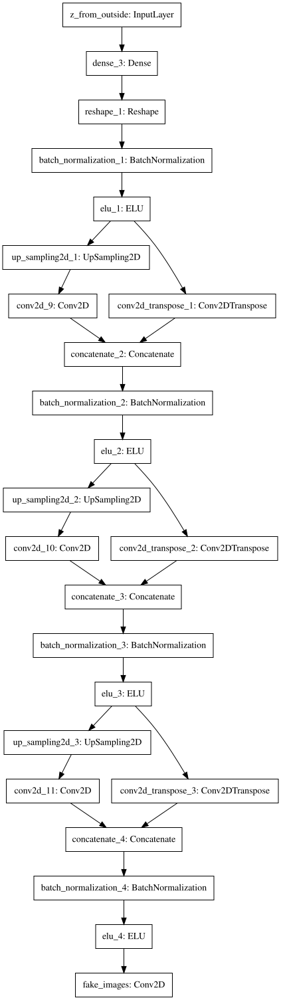

In [0]:
SVG(model_to_dot(decoder).create(prog='dot', format='svg'))

By stacking the encoder and the decoder (with the classifier along the way), we create the first version of our variational autoencoder (simple-VAE).

In [0]:
#real_images = Input(shape=image_shape, name='real_images')
true_classes = Input(shape=(1,), name='sparse_class_labels')

z_mean, z_log_sigma2 = encoder(real_images)
z = LatentSamplingLayer([z_mean, z_log_sigma2])
fake_images = decoder(z)
predicted_latent_classes = latent_clf(z)

In [0]:
simple_vae = Model(inputs=[real_images, true_classes],\
                   outputs=[fake_images, z_mean, z_log_sigma2, predicted_latent_classes])


# some helper definitions

falsifier = Model(inputs=real_images,\
                  outputs=fake_images,\
                  name='falsifier')

classifier = Model(inputs=real_images,\
                   outputs=predicted_latent_classes,\
                   name='classifier')

Crucially, we have to define the loss function for the simple-VAE. To add a loss function to the model, a "define-first-attach-later" approach can be used in keras.

In [0]:
kl_loss = 1 + z_log_sigma2 - K.square(z_mean) - K.exp(z_log_sigma2)
kl_loss = -0.5 * K.sum(kl_loss, axis=-1)

reconstruction_loss_1 = mse(K.flatten(real_images), K.flatten(fake_images))
reconstruction_loss_1 *= image_dim * image_dim * 3

reconstruction_loss_2 = binary_crossentropy(K.flatten(real_images), K.flatten(fake_images))
reconstruction_loss_2 *= image_dim * image_dim * 3

classification_loss = sparse_categorical_crossentropy(true_classes, predicted_latent_classes)

simple_vae_loss = K.mean(2 * kl_loss + reconstruction_loss_1 +\
                         0.001 * reconstruction_loss_2  +\
                         classification_loss)

simple_vae.add_loss(simple_vae_loss)

In [0]:
simple_vae.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
real_images (InputLayer)        (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
encoder (Model)                 [(None, 128), (None, 4053888     real_images[0][0]                
__________________________________________________________________________________________________
latent_sampling (Lambda)        (None, 128)          0           encoder[1][0]                    
                                                                 encoder[1][1]                    
__________________________________________________________________________________________________
decoder (Model)                 (None, 100, 100, 3)  8649731     latent_sampling[0][0]            
__________

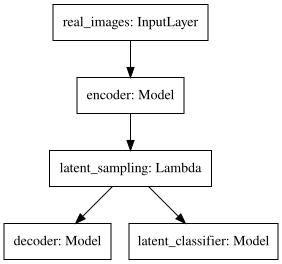

In [0]:
SVG(model_to_dot(simple_vae).create(prog='dot', format='svg'))

Define a callback for the simple VAE: print some metrics on the fixed sample of images.

In [0]:
class SimpleVAEMetrics(Callback):
  
    def __init__(self, sample_images, sample_classes):
        self.sample_images = sample_images
        self.sample_classes = sample_classes

    def on_epoch_end(self, epoch, logs={}):
      
        fake_images, z_mean, z_log_sigma2, predicted_latent_classes =\
        self.model.predict([self.sample_images, self.sample_classes])
        
        kl_loss =\
        -0.5 * np.sum(1 + z_log_sigma2 - np.square(z_mean) - np.exp(z_log_sigma2),\
                      axis=-1)
        kl_loss = np.mean(kl_loss)
        
        reconstruction_loss_1 = np.sum(np.square(self.sample_images - fake_images))
        reconstruction_loss_1 /= len(self.sample_images)
        
        reconstruction_loss_2 = - np.sum(self.sample_images * np.log(fake_images) +\
                                         (1 - self.sample_images) * np.log(1 - fake_images) )
        reconstruction_loss_2 /= len(self.sample_images)
        
        K_predicted_latent_classes = K.constant(predicted_latent_classes)
        K_sample_classes = K.constant(self.sample_classes)
        classification_loss = K.eval(K.mean(\
          K.sparse_categorical_crossentropy(K_sample_classes, K_predicted_latent_classes,\
                                            axis=-1)
        ))
        
        sparse_predicted_classes = np.argmax(predicted_latent_classes, axis=-1)
        acc = np.mean(self.sample_classes == sparse_predicted_classes)
        
        print(2 * kl_loss, reconstruction_loss_1, 0.001 * reconstruction_loss_2,\
              classification_loss, acc)

In [0]:
simple_vae.compile(optimizer=Adam(lr=0.001))

W0715 07:42:49.154066 139639607400320 deprecation_wrapper.py:119] From /usr/local/lib/python3.6/dist-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.



In [0]:
simple_vae.fit_generator(images_classes_gen,
                         steps_per_epoch = 300,
                         epochs=10,
                         callbacks=[SimpleVAEMetrics(sample_images, sample_classes)]
                        )

Epoch 1/10
300/300 [==============================] - 95s 317ms/step - loss: 666.3957
41.84796142578125 487.9774512884978 18.725820238843497 1.9484199 0.29101194217473286
Epoch 2/10
300/300 [==============================] - 85s 284ms/step - loss: 448.2203
67.47709655761719 312.87091451917036 18.327199245757388 1.4529294 0.49025769956002513
Epoch 3/10
300/300 [==============================] - 87s 289ms/step - loss: 376.6494
74.48011016845703 271.4352215587681 18.232315524827154 1.2780857 0.5622250157133878
Epoch 4/10
300/300 [==============================] - 87s 291ms/step - loss: 347.1712
85.14242553710938 248.44345144563167 18.17488246385921 1.0998409 0.6222501571338781
Epoch 5/10
300/300 [==============================] - 88s 292ms/step - loss: 328.3221
77.99105834960938 226.77463073538655 18.127849151477058 0.98517233 0.6621621621621622
Epoch 6/10
300/300 [==============================] - 88s 293ms/step - loss: 319.5407
83.0326919555664 206.59518384663733 18.08076807039598 0.852

Digit: 4
Predicted: 4


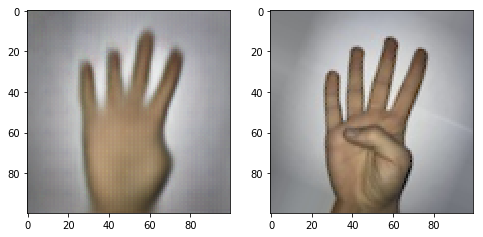

In [0]:
index = np.random.randint(len(sample_images))
print("Digit:", int(sample_classes[index]))
print("Predicted:", np.argmax(classifier.predict(sample_images[np.newaxis, index])[0]))

fig, axes = plt.subplots(1, 2, figsize=(8,4))
axes[0].imshow(falsifier.predict(sample_images[np.newaxis, index])[0])
axes[1].imshow(sample_images[index])
plt.show()

Define a model where the original image is randomly either passed through unmodifeid or it goes trough the encoder-decoder bottleneck.

In [0]:
def image_lottery(args):  
  real_images, fake_images = args
  input_shape = K.shape(real_images)
  
  # 0 -> fake
  # 1 -> real
  random_nums = K.random_uniform((input_shape[0], 1))
  authenticity_labels = K.round(random_nums)
  binary_mask = K.reshape(authenticity_labels, (input_shape[0], 1, 1, 1))
   
  lottery_images = binary_mask * real_images + (1 - binary_mask) * fake_images
  return [lottery_images, authenticity_labels]


ImageLotteryLayer = Lambda(image_lottery,\
                           name='image_lottery')

lottery_images, authenticity_labels = ImageLotteryLayer([real_images, falsifier(real_images)])

lottery_machine = Model(inputs = real_images,\
                        outputs = [lottery_images, authenticity_labels],\
                        name='lottery_machine')

In [0]:
lottery_machine.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
real_images (InputLayer)        (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
falsifier (Model)               (None, 100, 100, 3)  12703619    real_images[0][0]                
__________________________________________________________________________________________________
image_lottery (Lambda)          [(None, 100, 100, 3) 0           real_images[0][0]                
                                                                 falsifier[1][0]                  
Total params: 12,703,619
Trainable params: 12,701,315
Non-trainable params: 2,304
__________________________________________________________________________________________________


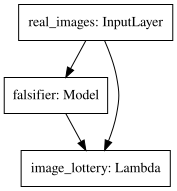

In [0]:
SVG(model_to_dot(lottery_machine).create(prog='dot', format='svg'))

Digit: 7
Authenticity (left): [1.]


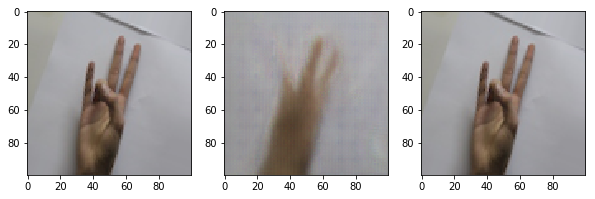

In [0]:
index = np.random.randint(len(sample_images))
lottery_images_, authenticity_labels_ =\
lottery_machine.predict(sample_images[np.newaxis, index])
print("Digit:", int(sample_classes[index]))
print("Authenticity (left):", authenticity_labels_[0])
fig, axes = plt.subplots(1, 3, figsize=(10,6))
axes[0].imshow(lottery_images_[0])
axes[1].imshow(falsifier.predict(sample_images[np.newaxis, index])[0])
axes[2].imshow(sample_images[index])
plt.show()

Make a function that will serve to tell real and fake images apart. Call it a 'discriminator'. We'll  define two identical keras-models that will share all the weights but one will be trainable and the other one will be frozen.

In [0]:
images_to_judge = Input(shape=image_shape,\
                        name='images_to_judge')

x = Conv2D(filters=32,
           kernel_size=2,
           activation='elu',
           strides=1,
           padding='same')(images_to_judge)
x = Conv2D(filters=32,
           kernel_size=2,
           activation='elu',
           strides=1,
           padding='same')(x)
x = Conv2D(filters=32,
           kernel_size=2,
           activation='elu',
           strides=1,
           padding='same')(x)
x = BatchNormalization()(x)
x = MaxPooling2D(2)(x)

y = Conv2D(filters=32,
           kernel_size=5,
           activation='elu',
           strides=2,
           padding='same')(images_to_judge)
y = BatchNormalization()(y)

x = add([x, y])

x = Conv2D(filters=16,
           kernel_size=3,
           activation='elu',
           strides=1,
           padding='same')(x)
x = MaxPooling2D(2)(x)
x = BatchNormalization()(x)
x = Conv2D(filters=16,
           kernel_size=3,
           activation='elu',
           strides=1,
           padding='same')(x)
x = MaxPooling2D(2)(x)

z = Conv2D(filters=8,
           kernel_size=3,
           activation='elu',
           strides=2,
           dilation_rate=1,
           padding='same')(images_to_judge)
z = Conv2D(filters=8,
           kernel_size=3,
           activation='elu',
           strides=1,
           dilation_rate=2,
           padding='same')(z)
z = Conv2D(filters=8,
           kernel_size=3,
           activation='elu',
           strides=2,
           dilation_rate=1,
           padding='same')(z)
z = Conv2D(filters=8,
           kernel_size=3,
           activation='elu',
           strides=1,
           dilation_rate=2,
           padding='same')(z)
z = Conv2D(filters=8,
           kernel_size=3,
           activation='elu',
           strides=2,
           dilation_rate=1,
           padding='valid')(z)

x = concatenate([x, z])

x = BatchNormalization()(x)
x = Flatten()(x)
x = Dense(64, activation='relu')(x)
x = Dropout(rate=0.3)(x)
believability = Dense(1,\
                      activation='sigmoid',\
                      name='believability')(x)

discriminator = Model(inputs=images_to_judge,\
                      outputs=believability,\
                      name='discriminator')

frozen_discriminator = Model(inputs=images_to_judge,\
                             outputs=believability,\
                             name='frozen_discriminator')

W0715 07:43:06.562166 139639607400320 deprecation.py:506] From /usr/local/lib/python3.6/dist-packages/keras/backend/tensorflow_backend.py:3445: calling dropout (from tensorflow.python.ops.nn_ops) with keep_prob is deprecated and will be removed in a future version.
Instructions for updating:
Please use `rate` instead of `keep_prob`. Rate should be set to `rate = 1 - keep_prob`.


In [0]:
discriminator.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
images_to_judge (InputLayer)    (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
conv2d_12 (Conv2D)              (None, 100, 100, 32) 416         images_to_judge[0][0]            
__________________________________________________________________________________________________
conv2d_13 (Conv2D)              (None, 100, 100, 32) 4128        conv2d_12[0][0]                  
__________________________________________________________________________________________________
conv2d_14 (Conv2D)              (None, 100, 100, 32) 4128        conv2d_13[0][0]                  
__________________________________________________________________________________________________
batch_norm

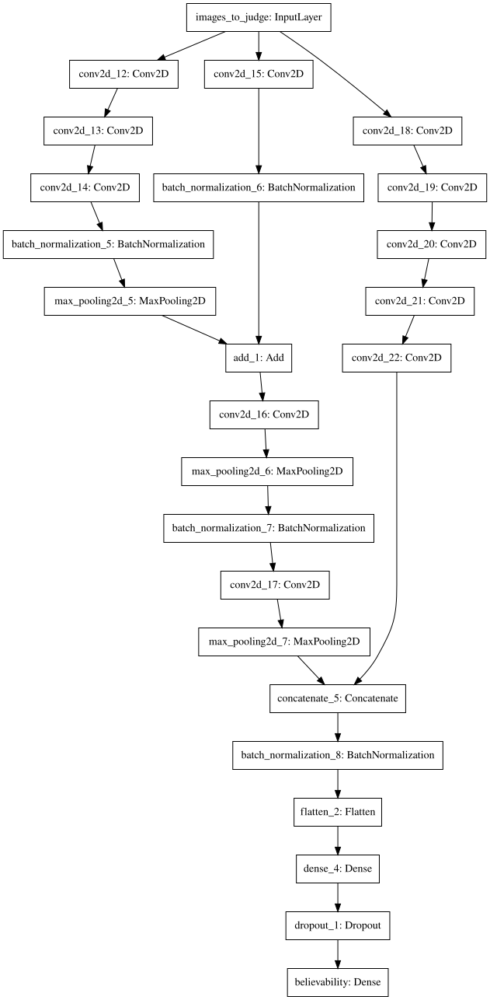

In [0]:
SVG(model_to_dot(discriminator).create(prog='dot', format='svg'))

We now combine the previously defined image-generating lottery-machine with the trainable discriminator. Then we freeze the former. The goal will be to train the disciminator to discriminate between real and fake images.

In [0]:
lottery_images, authenticity_labels = lottery_machine(real_images)

lottery_image_believability = discriminator(lottery_images)

authenticator = Model(inputs = real_images,\
                      outputs = [lottery_image_believability, authenticity_labels])

authenticator.get_layer('lottery_machine').trainable = False

authetication_loss = K.mean(binary_crossentropy(authenticity_labels, lottery_image_believability))
authenticator.add_loss(authetication_loss)

authenticator.compile(optimizer=Adam(lr=0.0008))

authenticator.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
real_images (InputLayer)     (None, 100, 100, 3)       0         
_________________________________________________________________
lottery_machine (Model)      [(None, 100, 100, 3), (No 12703619  
_________________________________________________________________
discriminator (Model)        (None, 1)                 242337    
Total params: 12,945,956
Trainable params: 242,129
Non-trainable params: 12,703,827
_________________________________________________________________


Define a callback for the authenticator: print some metrics on the fixed sample images.

In [0]:
class AuthenticatorMetrics(Callback):

    def on_epoch_end(self, epoch, logs={}):
      
        lottery_image_believability, authenticity_labels =\
        self.model.predict(sample_images)
        
        acc = np.mean(authenticity_labels == np.round(lottery_image_believability))
        print('Accuracy:', acc)

Conversely, define a trainable factory of fake images that will use the frozen discriminator to define (a part of) the loss function. Train the factory to reproduce the real input images.

In [0]:
fake_image_believability = frozen_discriminator(fake_images)

forgerer = Model(inputs = [real_images, true_classes],\
                 outputs = [fake_images, z_mean, z_log_sigma2, predicted_latent_classes, fake_image_believability])

forgerer.get_layer('frozen_discriminator').trainable = False

reconstruction_loss_1 = mse(K.flatten(real_images), K.flatten(fake_images))
reconstruction_loss_1 *= image_dim * image_dim * 3

reconstruction_loss_2 = binary_crossentropy(K.flatten(real_images), K.flatten(fake_images))
reconstruction_loss_2 *= image_dim * image_dim * 3

believability_loss = - K.log(fake_image_believability + K.epsilon())

classification_loss = sparse_categorical_crossentropy(true_classes, predicted_latent_classes)

forgerer_vae_loss = K.mean(2 * kl_loss + reconstruction_loss_1 + 0.001 * reconstruction_loss_2 +\
                           100 * believability_loss + classification_loss)

forgerer.add_loss(forgerer_vae_loss)

forgerer.compile(optimizer=Adam(lr=0.0008))

forgerer.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
real_images (InputLayer)        (None, 100, 100, 3)  0                                            
__________________________________________________________________________________________________
encoder (Model)                 [(None, 128), (None, 4053888     real_images[0][0]                
__________________________________________________________________________________________________
latent_sampling (Lambda)        (None, 128)          0           encoder[1][0]                    
                                                                 encoder[1][1]                    
__________________________________________________________________________________________________
decoder (Model)                 (None, 100, 100, 3)  8649731     latent_sampling[0][0]            
__________

Digit: 5.0. Predicted: 5. Believability: 0.255


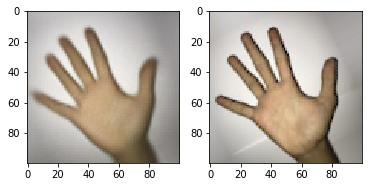

Digit: 2.0. Predicted: 7. Believability: 0.025


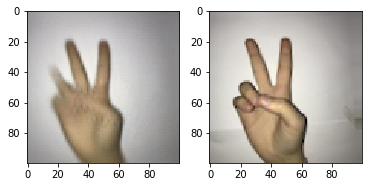

Digit: 2.0. Predicted: 2. Believability: 0.015


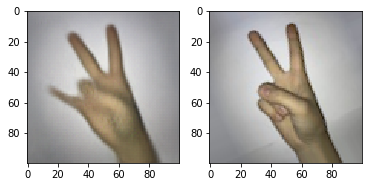

Digit: 8.0. Predicted: 8. Believability: 0.018


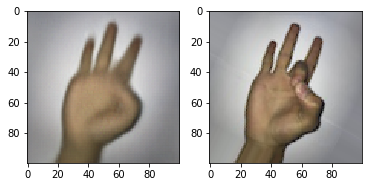

Digit: 5.0. Predicted: 5. Believability: 0.010


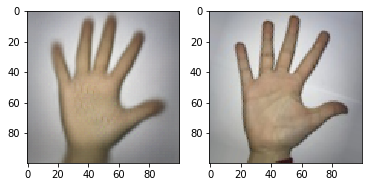

In [0]:
def print_fake_images(num=1):
  for _ in range(num):
    index = np.random.randint(len(sample_images))
    fake_images_, z_mean_, z_log_sigma2_, predicted_latent_classes_, fake_image_believability_ =\
    forgerer.predict([sample_images[np.newaxis, index], sample_classes[np.newaxis, index]])
    print(f"Digit: {sample_classes[index]}.",\
          f"Predicted: {np.argmax(predicted_latent_classes_[0])}.",\
          f"Believability: {fake_image_believability_[0][0]:.3f}")
    fig, axes = plt.subplots(1, 2, figsize=(6, 3))
    axes[0].imshow(fake_images_[0])
    axes[1].imshow(sample_images[index])
    plt.show()
  
print_fake_images(5)

In [0]:
class ForgererMetrics(Callback):

    def on_epoch_end(self, epoch, logs={}):
      
        fake_images, z_mean, z_log_sigma2, predicted_latent_classes, fake_image_believability =\
        self.model.predict([sample_images, sample_classes])
        
        kl_loss =\
        -0.5 * np.sum(1 + z_log_sigma2 - np.square(z_mean) - np.exp(z_log_sigma2),\
                      axis=-1)
        kl_loss = np.mean(kl_loss)
        
        reconstruction_loss_1 = np.sum(np.square(sample_images - fake_images))
        reconstruction_loss_1 /= len(sample_images)
        
        reconstruction_loss_2 = - np.sum(sample_images * np.log(fake_images) +\
                                         (1 - sample_images) * np.log(1 - fake_images) )
        reconstruction_loss_2 /= len(sample_images)
        
        K_fake_image_believability = K.constant(fake_image_believability)
        believability_loss = K.eval(K.mean(\
          K.binary_crossentropy(K.ones(shape=(len(sample_images), 1)), K_fake_image_believability)
        ))

        K_predicted_latent_classes = K.constant(predicted_latent_classes)
        K_sample_classes = K.constant(sample_classes)
        classification_loss = K.eval(K.mean(\
          K.sparse_categorical_crossentropy(K_sample_classes, K_predicted_latent_classes,\
                                            axis=-1)
        ))
        
        sparse_predicted_classes = np.argmax(predicted_latent_classes, axis=-1)
        acc = np.mean(sample_classes == sparse_predicted_classes)
        
        print(2 * kl_loss, reconstruction_loss_1, 0.001 * reconstruction_loss_2,\
              100 * believability_loss, classification_loss, acc)
        
        print_fake_images()

In [0]:
forgerer.load_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")

Now, for a few times, train the authenticator and the forgerer in an alternating fashion. The hope is that the former will keep on catching up to the latter and pushing the fake-image-generation to ever better quality levels. Clearly, a lot of fine-tuning can be done to potentially better the results, given that all the relative weights between various contributions to the loss function are arbitrary hyperparameters  (on top of the usual ones like the learning rate) .

In [0]:
print(" --- Authenticator --- ")
authenticator.fit_generator(images_gen,\
                            callbacks = [AuthenticatorMetrics()],\
                            steps_per_epoch = 100,\
                            epochs = 2
                           )

 --- Authenticator --- 
Epoch 1/2
100/100 [==============================] - 31s 314ms/step - loss: 0.0657
Accuracy: 0.9880578252671276
Epoch 2/2
100/100 [==============================] - 26s 261ms/step - loss: 0.0136
Accuracy: 0.9660590823381521


Digit: 9.0. Predicted: 9. Believability: 0.000


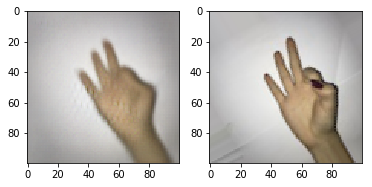

Digit: 4.0. Predicted: 4. Believability: 0.000


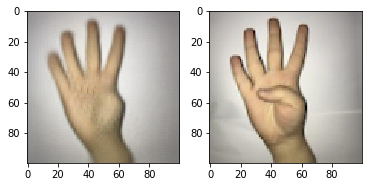

Digit: 7.0. Predicted: 7. Believability: 0.000


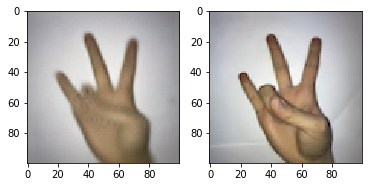

Digit: 9.0. Predicted: 9. Believability: 0.000


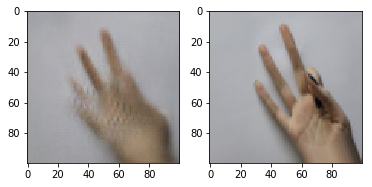

Digit: 3.0. Predicted: 5. Believability: 0.000


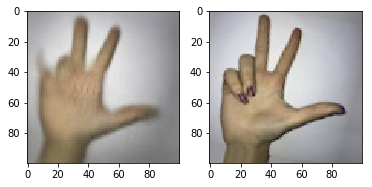

In [0]:
print_fake_images(5)

 --- Forgerer --- 
Epoch 1/80
100/100 [==============================] - 65s 655ms/step - loss: 226.6598
86.29303741455078 122.61317567567568 17.89186926461345 925.8542060852051 0.16735546 0.9428032683846638
Digit: 9.0. Predicted: 9. Believability: 0.029


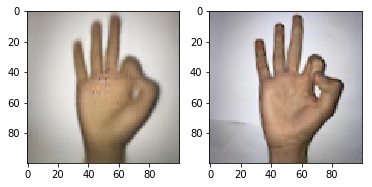

Epoch 2/80
100/100 [==============================] - 65s 651ms/step - loss: 224.6054
87.1126937866211 117.95685692960403 17.88161785040855 1016.4131164550781 0.1601621 0.9459459459459459
Digit: 1.0. Predicted: 1. Believability: 0.000


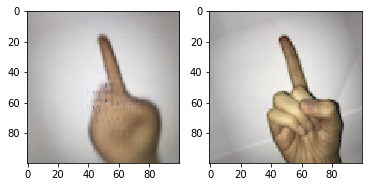

Epoch 3/80
100/100 [==============================] - 65s 654ms/step - loss: 224.6239
87.95459747314453 118.72912083595223 17.883318667504714 953.0879020690918 0.1650211 0.9434318038969202
Digit: 1.0. Predicted: 1. Believability: 0.000


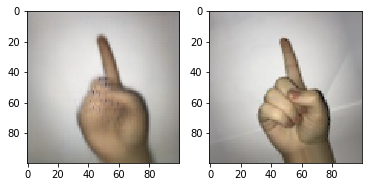

Epoch 4/80
100/100 [==============================] - 65s 651ms/step - loss: 225.4288
86.94038391113281 118.89540776241358 17.883958516656193 1093.8298225402832 0.14517207 0.9519170333123822
Digit: 4.0. Predicted: 5. Believability: 0.000


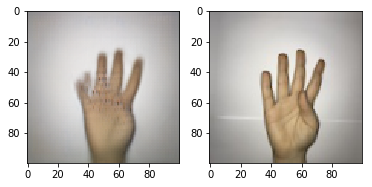

Epoch 5/80
100/100 [==============================] - 65s 654ms/step - loss: 225.7313
83.96190643310547 128.17817999685732 17.905927089880578 848.5282897949219 0.18083933 0.9387177875549969
Digit: 1.0. Predicted: 1. Believability: 0.001


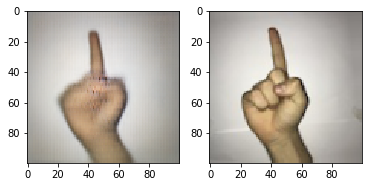

Epoch 6/80
100/100 [==============================] - 65s 651ms/step - loss: 224.4790
84.25113677978516 120.5071103079824 17.88692771841609 1037.677001953125 0.15473509 0.9450031426775612
Digit: 8.0. Predicted: 8. Believability: 0.000


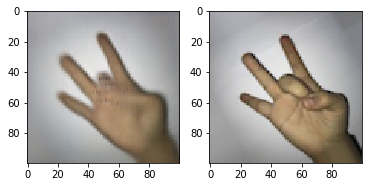

Epoch 7/80
100/100 [==============================] - 65s 654ms/step - loss: 225.5578
84.7044906616211 119.20855593966058 17.884399748585796 969.068717956543 0.16490829 0.9453174104336896
Digit: 3.0. Predicted: 3. Believability: 0.000


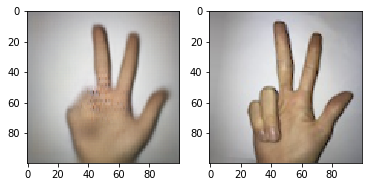

Epoch 8/80
100/100 [==============================] - 65s 651ms/step - loss: 225.4594
85.3792495727539 119.53295883092395 17.885020741671905 1040.5387878417969 0.16518825 0.9412319296040226
Digit: 7.0. Predicted: 7. Believability: 0.000


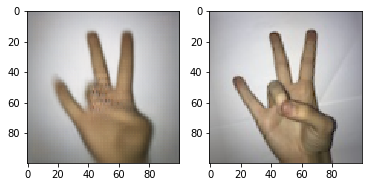

Epoch 9/80
100/100 [==============================] - 65s 651ms/step - loss: 227.0811
85.11672973632812 127.0512747485858 17.902751728472662 607.231855392456 0.15137015 0.9459459459459459
Digit: 1.0. Predicted: 1. Believability: 0.000


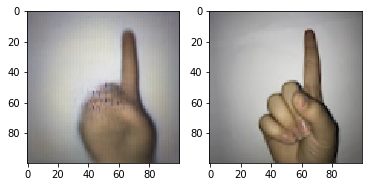

Epoch 10/80
100/100 [==============================] - 65s 654ms/step - loss: 226.1343
85.50464630126953 122.08318274670019 17.890735386549338 952.4003028869629 0.18501893 0.9368321810182275
Digit: 2.0. Predicted: 2. Believability: 0.000


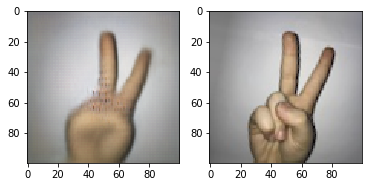

Epoch 11/80
100/100 [==============================] - 65s 650ms/step - loss: 226.7002
85.07278442382812 121.84410355122564 17.89016090509114 778.3232688903809 0.16470233 0.9409176618478944
Digit: 0.0. Predicted: 0. Believability: 0.018


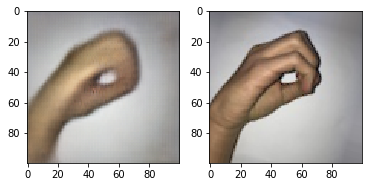

Epoch 12/80
100/100 [==============================] - 65s 655ms/step - loss: 225.3538
86.26354217529297 124.66605122564425 17.897505971087366 1055.7605743408203 0.15622394 0.9465744814582024
Digit: 5.0. Predicted: 5. Believability: 0.000


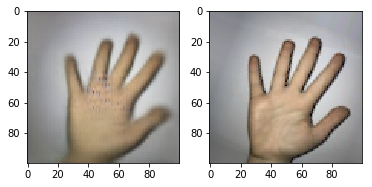

Epoch 13/80
100/100 [==============================] - 65s 652ms/step - loss: 227.2538
84.9744873046875 123.3621346637335 17.89454054054054 990.8692359924316 0.16251013 0.9437460716530484
Digit: 8.0. Predicted: 8. Believability: 0.000


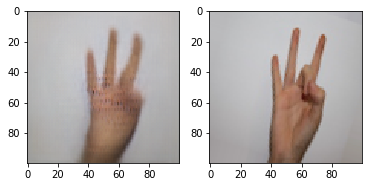

Epoch 14/80
100/100 [==============================] - 65s 654ms/step - loss: 226.1994
85.44807434082031 122.01240375549969 17.891249528598365 775.4848003387451 0.15918404 0.9484600879949717
Digit: 0.0. Predicted: 0. Believability: 0.002


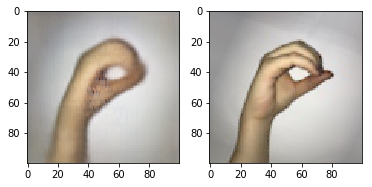

Epoch 15/80
100/100 [==============================] - 65s 651ms/step - loss: 227.1171
88.04280090332031 122.00438992771842 17.89088874921433 385.9835386276245 0.16563606 0.944688874921433
Digit: 1.0. Predicted: 1. Believability: 0.628


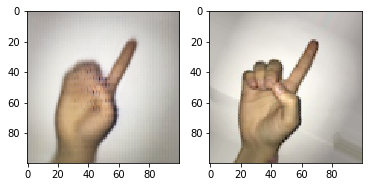

Epoch 16/80
100/100 [==============================] - 65s 655ms/step - loss: 225.9002
85.11286926269531 120.05439778441232 17.886130735386548 1022.8448867797852 0.16050766 0.9434318038969202
Digit: 7.0. Predicted: 7. Believability: 0.000


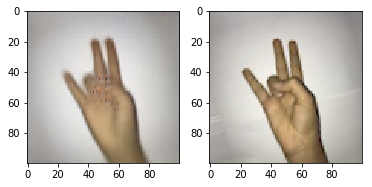

Epoch 17/80
100/100 [==============================] - 65s 651ms/step - loss: 226.3891
83.92581176757812 121.38927954116907 17.888877435575107 993.6629295349121 0.1681611 0.9415461973601509
Digit: 3.0. Predicted: 3. Believability: 0.000


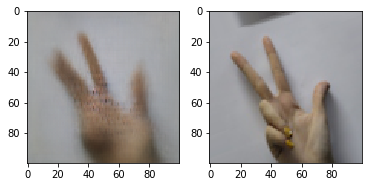

Epoch 18/80
100/100 [==============================] - 65s 653ms/step - loss: 227.7473
84.19407653808594 121.17869068196103 17.88866624764299 975.6100654602051 0.15489648 0.9512884978001257
Digit: 7.0. Predicted: 7. Believability: 0.000


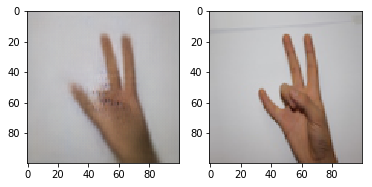

Epoch 19/80
100/100 [==============================] - 65s 652ms/step - loss: 227.6789
83.90425872802734 123.69965823381521 17.894477686989315 872.9099273681641 0.1616104 0.9437460716530484
Digit: 4.0. Predicted: 4. Believability: 0.000


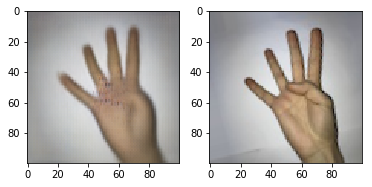

Epoch 20/80
100/100 [==============================] - 66s 655ms/step - loss: 223.5130
84.34669494628906 123.28167229729729 17.89291640477687 1072.0481872558594 0.17966682 0.9424890006285355
Digit: 1.0. Predicted: 1. Believability: 0.000


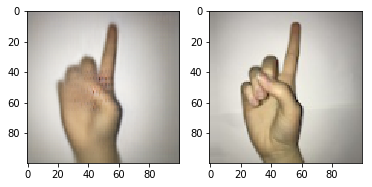

Epoch 21/80
100/100 [==============================] - 65s 651ms/step - loss: 225.2958
85.76508331298828 120.01584105908233 17.88590823381521 886.0536575317383 0.16471425 0.9387177875549969
Digit: 7.0. Predicted: 7. Believability: 0.005


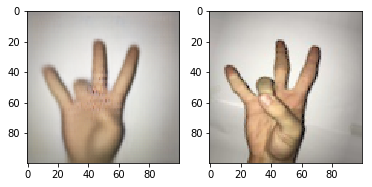

Epoch 22/80
100/100 [==============================] - 65s 652ms/step - loss: 225.7327
87.27305603027344 118.8703743714645 17.883229415461976 964.7801399230957 0.14567655 0.9512884978001257
Digit: 5.0. Predicted: 5. Believability: 0.000


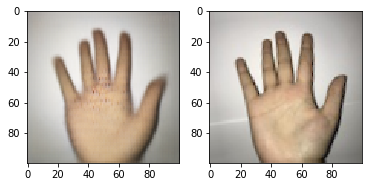

Epoch 23/80
100/100 [==============================] - 65s 655ms/step - loss: 224.4247
87.8299789428711 118.63614668447518 17.883798868636077 1027.8303146362305 0.1450886 0.9459459459459459
Digit: 1.0. Predicted: 1. Believability: 0.000


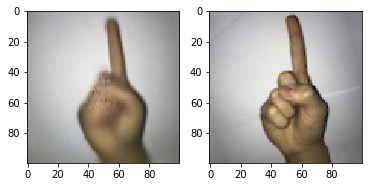

Epoch 24/80
 44/100 [============>.................] - ETA: 36s - loss: 226.0015

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=100)

forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")

Digit: 4.0. Predicted: 4. Believability: 1.000


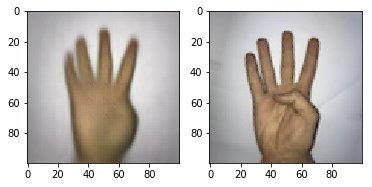

Digit: 2.0. Predicted: 2. Believability: 1.000


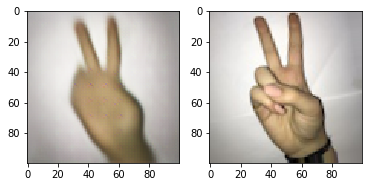

Digit: 0.0. Predicted: 0. Believability: 1.000


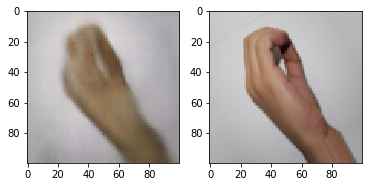

Digit: 5.0. Predicted: 5. Believability: 1.000


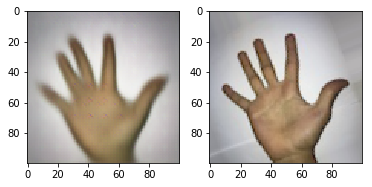

Digit: 7.0. Predicted: 7. Believability: 1.000


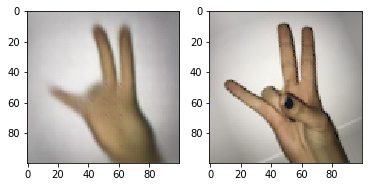

In [0]:
print_fake_images(5)

In [0]:
print(" --- Authenticator --- ")
authenticator.fit_generator(images_gen,\
                            callbacks = [AuthenticatorMetrics()],\
                            steps_per_epoch = 100,\
                            epochs = 1
                           )

 --- Authenticator --- 
Epoch 1/1
100/100 [==============================] - 18s 184ms/step - loss: 0.1047
Accuracy: 0.9871150219987429


Digit: 3.0. Predicted: 3. Believability: 0.000


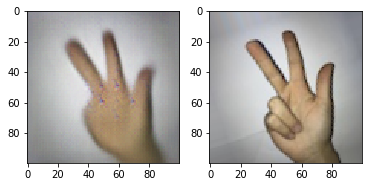

Digit: 7.0. Predicted: 7. Believability: 0.000


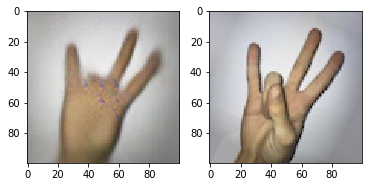

Digit: 0.0. Predicted: 0. Believability: 0.000


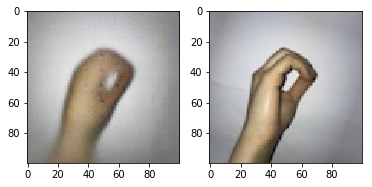

Digit: 7.0. Predicted: 7. Believability: 0.000


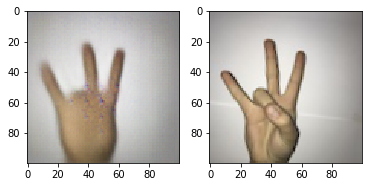

Digit: 5.0. Predicted: 5. Believability: 0.000


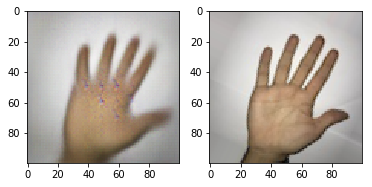

In [0]:
print_fake_images(5)

In [0]:
forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
authenticator.save_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=20)

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 30s 299ms/step - loss: 296.3568
85.05548858642578 190.33029541169077 18.053631678189817 334.96649265289307 0.42654902 0.8632935260842237
Epoch 2/20
100/100 [==============================] - 30s 305ms/step - loss: 284.5998
88.27371978759766 171.8656898177247 17.999827781269644 600.3530979156494 0.42475665 0.8601508485229415
Epoch 3/20
100/100 [==============================] - 30s 305ms/step - loss: 279.8264
89.12786102294922 170.7067685417976 17.997581395348835 578.4197330474854 0.40955248 0.8585795097423005
Epoch 4/20
100/100 [==============================] - 31s 309ms/step - loss: 281.1646
86.85492706298828 181.01488843494658 18.02142677561282 513.7951374053955 0.40005055 0.876492771841609
Epoch 5/20
100/100 [==============================] - 31s 308ms/step - loss: 278.0131
83.82994079589844 177.95745600251414 18.015068510370835 625.1157760620117 0.4296968 0.8544940289126336
Epoch 6/20
100/100 [===============

Digit: 4.0. Predicted: 4. Believability: 0.045


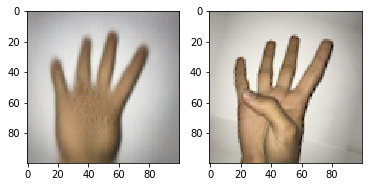

Digit: 0.0. Predicted: 0. Believability: 0.120


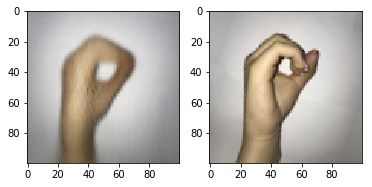

Digit: 4.0. Predicted: 4. Believability: 0.024


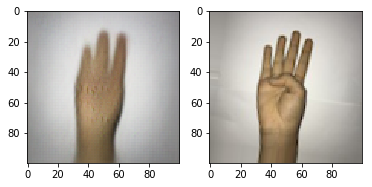

Digit: 3.0. Predicted: 3. Believability: 0.006


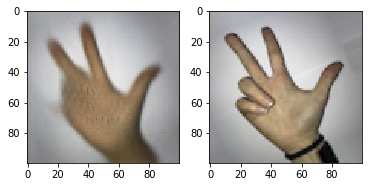

Digit: 0.0. Predicted: 0. Believability: 0.062


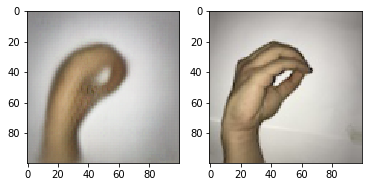

In [0]:
print_fake_images(5)

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=20)

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 33s 328ms/step - loss: 271.4430
87.24922180175781 160.31266695474545 17.974241357636707 535.8464241027832 0.3493701 0.88340666247643
Epoch 2/20
100/100 [==============================] - 32s 319ms/step - loss: 269.6987
85.33230590820312 169.71666797611564 17.9956153362665 444.2996025085449 0.36489767 0.8742928975487115
Epoch 3/20
100/100 [==============================] - 32s 322ms/step - loss: 271.1163
87.58273315429688 173.80808060967945 18.010339409176616 542.9899215698242 0.36104807 0.8805782526712759
Epoch 4/20
100/100 [==============================] - 32s 321ms/step - loss: 272.3181
88.22754669189453 186.23874528598367 18.04568824638592 366.52796268463135 0.32788482 0.8871778755499685
Epoch 5/20
100/100 [==============================] - 32s 323ms/step - loss: 269.0084
88.55091094970703 162.5704450817096 17.979758642363294 501.62835121154785 0.32923636 0.8975487115021998
Epoch 6/20
100/100 [================

Digit: 7.0. Predicted: 7. Believability: 0.002


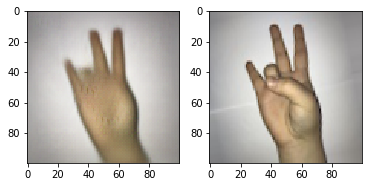

Digit: 5.0. Predicted: 5. Believability: 0.012


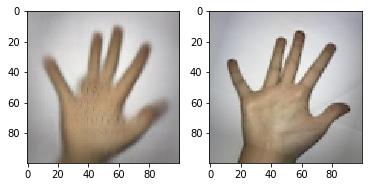

Digit: 3.0. Predicted: 3. Believability: 0.008


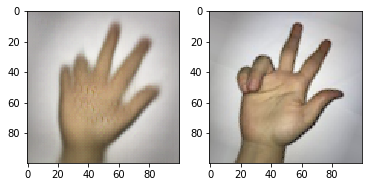

Digit: 5.0. Predicted: 5. Believability: 0.011


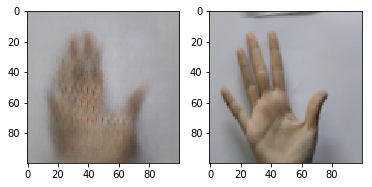

Digit: 4.0. Predicted: 4. Believability: 0.013


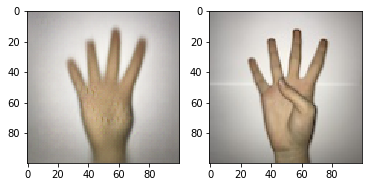

In [0]:
print_fake_images(5)

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=20)

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 32s 317ms/step - loss: 262.0036
83.95313262939453 157.14224544311753 17.966524198617222 454.65126037597656 0.33177018 0.8890634820867379
Epoch 2/20
100/100 [==============================] - 32s 324ms/step - loss: 263.9944
86.38426971435547 158.556411062225 17.969366436203646 505.07497787475586 0.3409385 0.8837209302325582
Epoch 3/20
100/100 [==============================] - 32s 322ms/step - loss: 263.2074
86.02484893798828 155.625284805154 17.96305342551854 507.78727531433105 0.3346461 0.88340666247643
Epoch 4/20
100/100 [==============================] - 32s 321ms/step - loss: 262.8570
86.59919738769531 155.46232715273413 17.963140163419233 445.3822135925293 0.31471694 0.8937774984286612
Epoch 5/20
100/100 [==============================] - 32s 322ms/step - loss: 262.2251
85.20515441894531 163.54703213387808 17.983549968573225 549.0749835968018 0.3281401 0.8912633563796355
Epoch 6/20
100/100 [==================

Digit: 3.0. Predicted: 3. Believability: 0.012


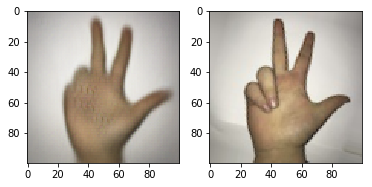

Digit: 0.0. Predicted: 0. Believability: 0.031


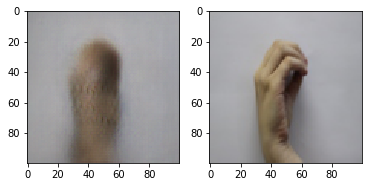

Digit: 2.0. Predicted: 2. Believability: 0.061


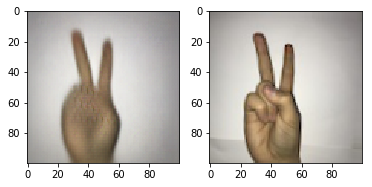

Digit: 6.0. Predicted: 6. Believability: 0.047


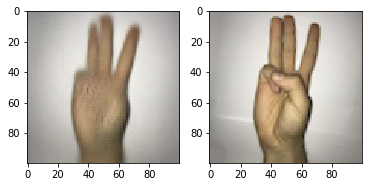

Digit: 8.0. Predicted: 8. Believability: 0.037


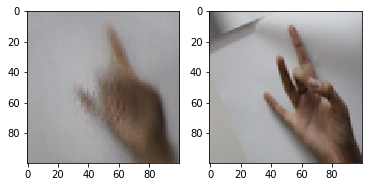

In [0]:
print_fake_images(5)

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 33s 330ms/step - loss: 256.3805
86.00540161132812 148.6395447045883 17.947449402891262 353.6933183670044 0.2893064 0.9057196731615337
Digit: 6.0. Predicted: 6. Believability: 0.025


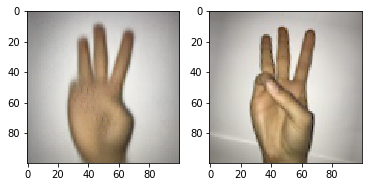

Epoch 2/20
100/100 [==============================] - 32s 318ms/step - loss: 256.9368
87.71028137207031 146.76026280641105 17.943278441231932 504.0426254272461 0.3021117 0.9010056568196103
Digit: 2.0. Predicted: 2. Believability: 0.083


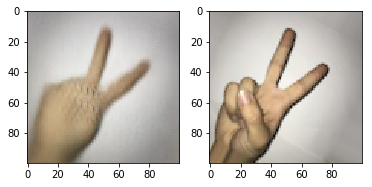

Epoch 3/20
100/100 [==============================] - 33s 326ms/step - loss: 255.8504
84.48834991455078 153.12201445631678 17.958964173475803 333.8145971298218 0.29404292 0.8956631049654306
Digit: 0.0. Predicted: 0. Believability: 0.207


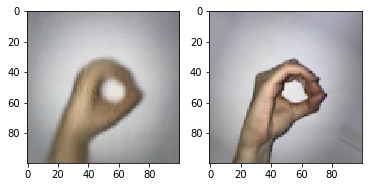

Epoch 4/20
100/100 [==============================] - 32s 320ms/step - loss: 258.3491
85.43190002441406 151.35365925518542 17.954390949088623 496.9376564025879 0.31293797 0.8969201759899434
Digit: 3.0. Predicted: 3. Believability: 0.007


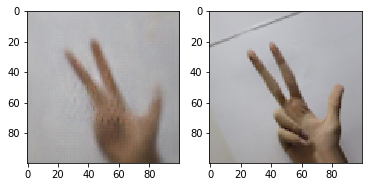

Epoch 5/20
100/100 [==============================] - 32s 325ms/step - loss: 256.7076
88.60863494873047 149.48833280955375 17.948667504714017 336.97450160980225 0.28691506 0.8975487115021998
Digit: 2.0. Predicted: 2. Believability: 0.015


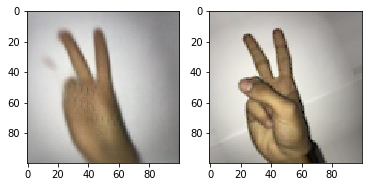

Epoch 6/20
100/100 [==============================] - 32s 321ms/step - loss: 256.3689
88.1580581665039 160.58053111250786 17.97921935889378 203.36120128631592 0.2767451 0.9050911376492772
Digit: 3.0. Predicted: 3. Believability: 0.136


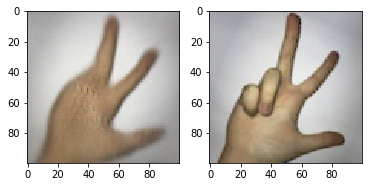

Epoch 7/20
100/100 [==============================] - 32s 323ms/step - loss: 256.8798
89.35941314697266 151.58965469830295 17.956165933375235 305.9546947479248 0.2816108 0.9069767441860465
Digit: 5.0. Predicted: 5. Believability: 0.009


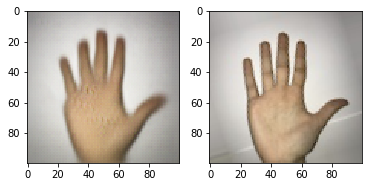

Epoch 8/20
100/100 [==============================] - 32s 323ms/step - loss: 255.1502
87.60858154296875 146.84743282526713 17.943414204902577 403.8297653198242 0.28226793 0.9063482086737901
Digit: 9.0. Predicted: 9. Believability: 0.010


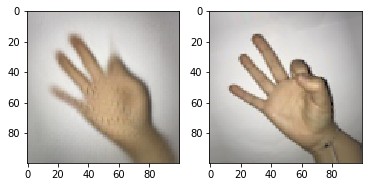

Epoch 9/20
100/100 [==============================] - 32s 322ms/step - loss: 255.5792
86.0669174194336 151.1568588937775 17.95343683218102 513.9447212219238 0.27519578 0.9079195474544312
Digit: 5.0. Predicted: 5. Believability: 0.002


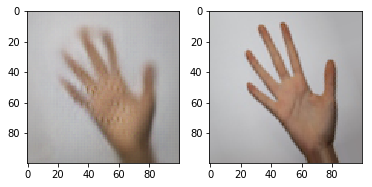

Epoch 10/20
100/100 [==============================] - 32s 323ms/step - loss: 254.9238
87.39738464355469 150.26097972972974 17.951920804525457 517.6052093505859 0.2957263 0.8912633563796355
Digit: 1.0. Predicted: 1. Believability: 0.000


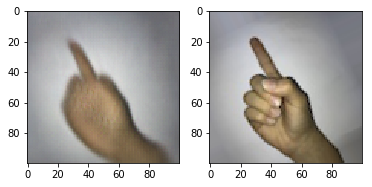

Epoch 11/20
100/100 [==============================] - 32s 323ms/step - loss: 254.5226
86.7471694946289 149.50871110936518 17.949123821495917 474.44348335266113 0.2690738 0.9063482086737901
Digit: 3.0. Predicted: 3. Believability: 0.002


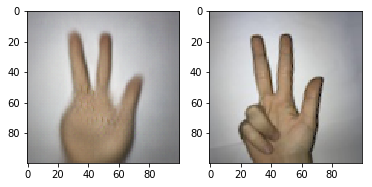

Epoch 12/20
100/100 [==============================] - 32s 322ms/step - loss: 255.7885
85.79283905029297 150.65463937774985 17.951976115650535 449.61347579956055 0.2699655 0.9113764927718416
Digit: 7.0. Predicted: 7. Believability: 0.159


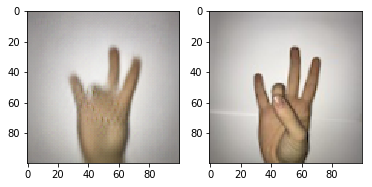

Epoch 13/20
100/100 [==============================] - 32s 323ms/step - loss: 255.2687
83.14253234863281 157.52753771213074 17.967516027655563 553.1025886535645 0.29229495 0.9022627278441232
Digit: 1.0. Predicted: 1. Believability: 0.009


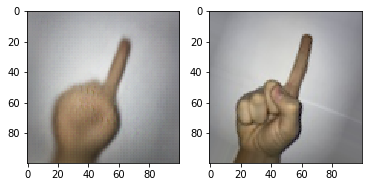

Epoch 14/20
100/100 [==============================] - 32s 322ms/step - loss: 253.8403
88.18225860595703 145.04709105908233 17.939023255813954 385.37445068359375 0.26304886 0.907605279698303
Digit: 7.0. Predicted: 7. Believability: 0.040


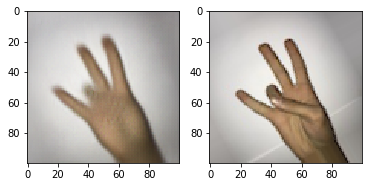

Epoch 15/20
100/100 [==============================] - 32s 322ms/step - loss: 253.5844
86.67188262939453 147.26421079509743 17.944842237586425 422.7345943450928 0.27418715 0.9050911376492772
Digit: 1.0. Predicted: 1. Believability: 0.060


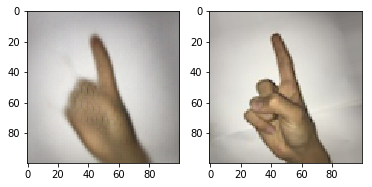

Epoch 16/20
100/100 [==============================] - 32s 323ms/step - loss: 255.4000
88.08960723876953 144.1676127435575 17.937605279698303 387.34285831451416 0.26356792 0.9098051539912005
Digit: 4.0. Predicted: 4. Believability: 0.001


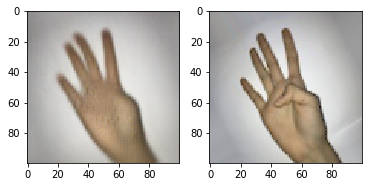

Epoch 17/20
100/100 [==============================] - 32s 323ms/step - loss: 255.5725
90.32304382324219 144.46330923947204 17.93875424261471 359.52723026275635 0.25892514 0.9101194217473287
Digit: 9.0. Predicted: 9. Believability: 0.048


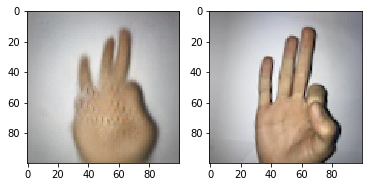

Epoch 18/20
100/100 [==============================] - 32s 323ms/step - loss: 253.8410
87.41851806640625 144.44486565053427 17.937602765556253 399.9157190322876 0.27637124 0.909176618478944
Digit: 1.0. Predicted: 1. Believability: 0.035


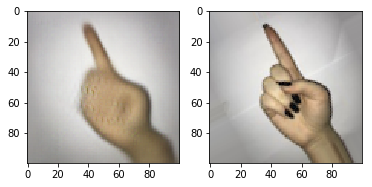

Epoch 19/20
100/100 [==============================] - 32s 322ms/step - loss: 253.0895
89.61798858642578 143.11262570710244 17.935109993714647 406.10132217407227 0.2505649 0.9138906348208674
Digit: 7.0. Predicted: 7. Believability: 0.019


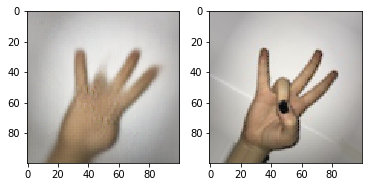

Epoch 20/20
100/100 [==============================] - 32s 322ms/step - loss: 252.8038
88.08721160888672 143.96352529855437 17.93773727215588 453.4743309020996 0.27690998 0.8981772470144563
Digit: 4.0. Predicted: 7. Believability: 0.000


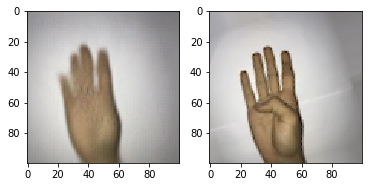

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=20)

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 33s 327ms/step - loss: 253.0403
87.00739288330078 145.967247407291 17.94182149591452 413.13304901123047 0.26363927 0.9088623507228158
Digit: 8.0. Predicted: 8. Believability: 0.077


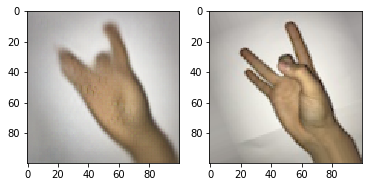

Epoch 2/20
100/100 [==============================] - 32s 318ms/step - loss: 253.1326
89.99110412597656 149.00507738843496 17.95180766813325 272.0355033874512 0.2552713 0.912005028284098
Digit: 2.0. Predicted: 2. Believability: 0.038


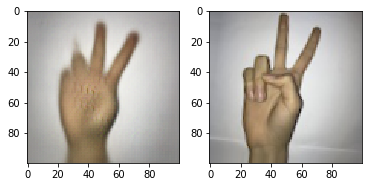

Epoch 3/20
100/100 [==============================] - 32s 324ms/step - loss: 252.5767
84.72418975830078 150.3191389063482 17.95099182903834 318.6333656311035 0.26538125 0.909176618478944
Digit: 3.0. Predicted: 3. Believability: 0.026


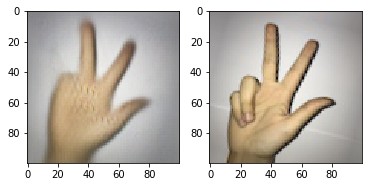

Epoch 4/20
100/100 [==============================] - 32s 321ms/step - loss: 250.8377
89.4560317993164 144.3656505342552 17.93796605908234 260.0548505783081 0.24843739 0.9116907605279698
Digit: 2.0. Predicted: 1. Believability: 0.191


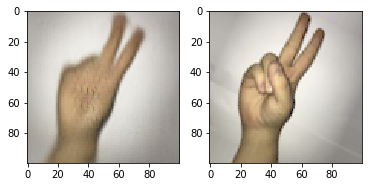

Epoch 5/20
100/100 [==============================] - 32s 324ms/step - loss: 253.0784
85.7774887084961 146.70731851037084 17.942890006285353 383.68396759033203 0.2582805 0.907605279698303
Digit: 6.0. Predicted: 6. Believability: 0.442


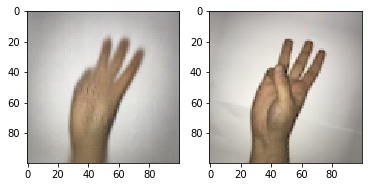

Epoch 6/20
100/100 [==============================] - 32s 321ms/step - loss: 251.4092
84.62356567382812 148.8684593023256 17.948837209302326 440.1411533355713 0.287736 0.8975487115021998
Digit: 2.0. Predicted: 2. Believability: 0.111


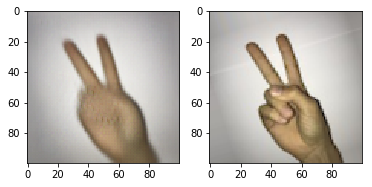

Epoch 7/20
100/100 [==============================] - 32s 324ms/step - loss: 252.8369
83.4239501953125 172.3464998428661 18.003180389692016 348.49164485931396 0.29068178 0.9010056568196103
Digit: 5.0. Predicted: 5. Believability: 0.008


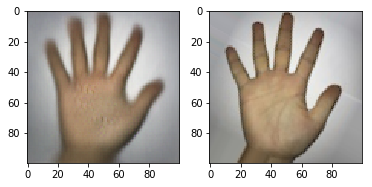

Epoch 8/20
100/100 [==============================] - 32s 322ms/step - loss: 252.6152
84.31177520751953 149.6405267913262 17.94976869893149 286.28571033477783 0.2905762 0.896291640477687
Digit: 1.0. Predicted: 1. Believability: 0.284


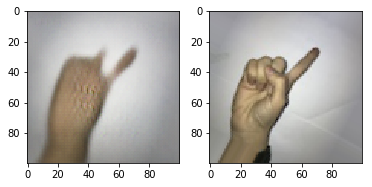

Epoch 9/20
100/100 [==============================] - 32s 322ms/step - loss: 251.5913
84.82840728759766 147.5174516813325 17.944580766813324 249.13175106048584 0.2791596 0.9054054054054054
Digit: 9.0. Predicted: 9. Believability: 0.032


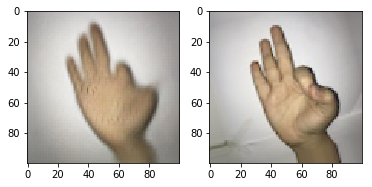

Epoch 10/20
100/100 [==============================] - 32s 324ms/step - loss: 250.1991
83.86747741699219 148.23368753928347 17.946338152105593 313.72034549713135 0.27735916 0.9094908862350722
Digit: 1.0. Predicted: 1. Believability: 0.112


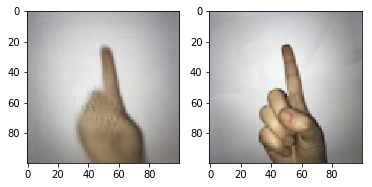

Epoch 11/20
100/100 [==============================] - 32s 321ms/step - loss: 251.5751
84.74179077148438 143.8215744814582 17.936433689503456 404.6710014343262 0.27477264 0.9060339409176619
Digit: 1.0. Predicted: 1. Believability: 0.048


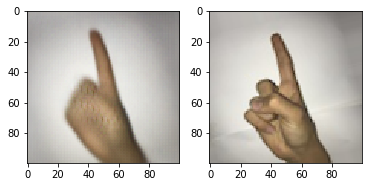

Epoch 12/20
100/100 [==============================] - 32s 323ms/step - loss: 249.6189
86.29328918457031 146.4719712445003 17.94186549340038 452.6726722717285 0.2634532 0.9098051539912005
Digit: 3.0. Predicted: 3. Believability: 0.161


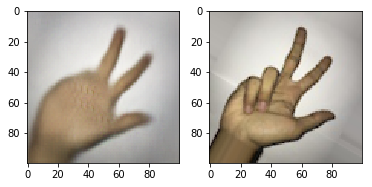

Epoch 13/20
100/100 [==============================] - 32s 323ms/step - loss: 251.5557
86.73303985595703 143.66867339723444 17.93632055311125 407.19475746154785 0.27716443 0.9069767441860465
Digit: 2.0. Predicted: 2. Believability: 0.010


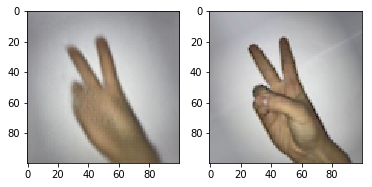

Epoch 14/20
100/100 [==============================] - 32s 323ms/step - loss: 251.3862
84.12393951416016 146.6964860936518 17.94445380263985 299.91493225097656 0.26327518 0.9123192960402263
Digit: 9.0. Predicted: 9. Believability: 0.055


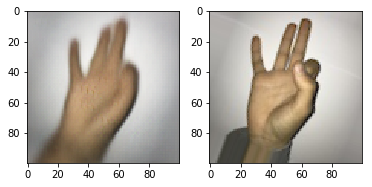

Epoch 15/20
100/100 [==============================] - 32s 323ms/step - loss: 249.4587
85.50930786132812 143.93874725015712 17.93662350722816 375.71446895599365 0.27338597 0.9104336895034569
Digit: 9.0. Predicted: 9. Believability: 0.008


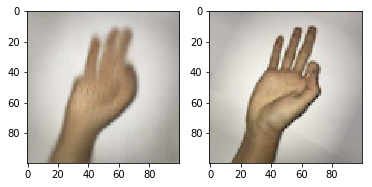

Epoch 16/20
100/100 [==============================] - 32s 322ms/step - loss: 248.6212
83.36471557617188 150.71984993714645 17.953870521684475 254.88414764404297 0.28189218 0.9066624764299183
Digit: 3.0. Predicted: 3. Believability: 0.106


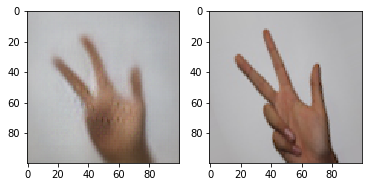

Epoch 17/20
100/100 [==============================] - 32s 322ms/step - loss: 249.9538
87.3430404663086 141.14103747642991 17.93028158390949 353.68430614471436 0.25881797 0.9088623507228158
Digit: 6.0. Predicted: 6. Believability: 0.009


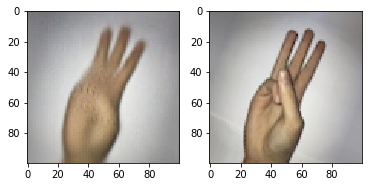

Epoch 18/20
100/100 [==============================] - 32s 324ms/step - loss: 249.5339
85.6669921875 142.8291463702074 17.934070395977372 352.2885322570801 0.2742517 0.9041483343808925
Digit: 1.0. Predicted: 1. Believability: 0.117


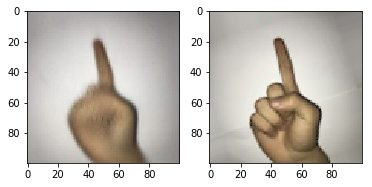

Epoch 19/20
100/100 [==============================] - 32s 322ms/step - loss: 250.2800
83.6777572631836 150.3444472815839 17.95306096794469 378.3579111099243 0.26551524 0.9135763670647391
Digit: 3.0. Predicted: 3. Believability: 0.005


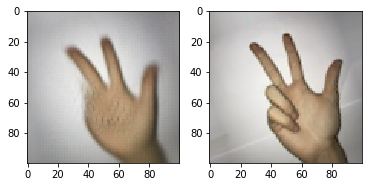

Epoch 20/20
100/100 [==============================] - 32s 324ms/step - loss: 248.4541
86.31564331054688 139.69118282526713 17.927260842237587 390.27082920074463 0.2628628 0.9151477058453803
Digit: 4.0. Predicted: 4. Believability: 0.009


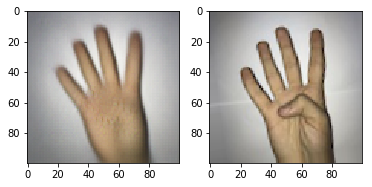

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=20)

 --- Forgerer --- 
Epoch 1/100
100/100 [==============================] - 32s 325ms/step - loss: 249.1972
84.25650024414062 150.8059985857951 17.955636706473918 304.61902618408203 0.28173986 0.9054054054054054
Digit: 2.0. Predicted: 2. Believability: 0.029


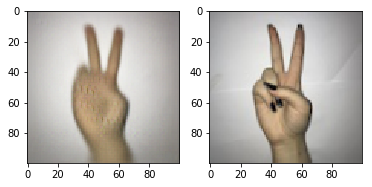

Epoch 2/100
100/100 [==============================] - 32s 321ms/step - loss: 249.0767
87.23155975341797 149.04670804525455 17.95097800125707 404.6379089355469 0.25942364 0.9094908862350722
Digit: 0.0. Predicted: 0. Believability: 0.025


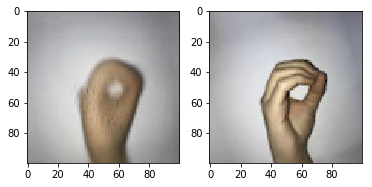

Epoch 3/100
100/100 [==============================] - 32s 324ms/step - loss: 248.7880
84.9478988647461 146.76163772784412 17.943073538654936 305.4439306259155 0.25945124 0.912005028284098
Digit: 2.0. Predicted: 2. Believability: 0.065


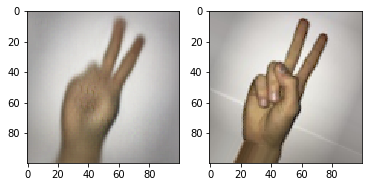

Epoch 4/100
100/100 [==============================] - 32s 321ms/step - loss: 248.0656
86.24120330810547 141.62341884035197 17.932922690131992 321.7040538787842 0.26124772 0.9138906348208674
Digit: 5.0. Predicted: 5. Believability: 0.092


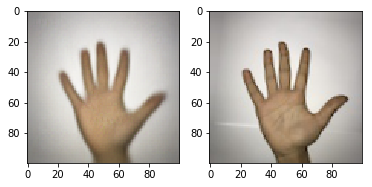

Epoch 5/100
100/100 [==============================] - 32s 325ms/step - loss: 248.5591
88.30973815917969 138.81242143306096 17.924543054682587 392.8799867630005 0.26367426 0.904776869893149
Digit: 9.0. Predicted: 9. Believability: 0.083


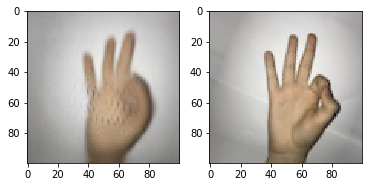

Epoch 6/100
100/100 [==============================] - 32s 321ms/step - loss: 250.2789
85.00204467773438 149.8668093966059 17.952047768698932 439.46943283081055 0.26420155 0.9094908862350722
Digit: 8.0. Predicted: 8. Believability: 0.047


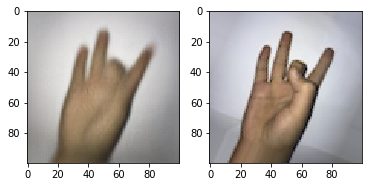

Epoch 7/100
100/100 [==============================] - 32s 323ms/step - loss: 247.8263
84.85704040527344 145.27074167190446 17.940290383406666 423.28319549560547 0.2514379 0.9116907605279698
Digit: 3.0. Predicted: 3. Believability: 0.005


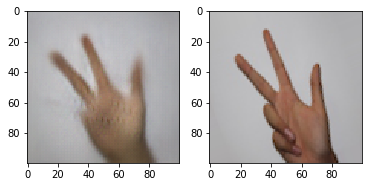

Epoch 8/100
100/100 [==============================] - 32s 322ms/step - loss: 247.9751
86.11729431152344 146.72130342551853 17.945379006913893 318.4977054595947 0.2533919 0.9145191703331238
Digit: 0.0. Predicted: 0. Believability: 0.123


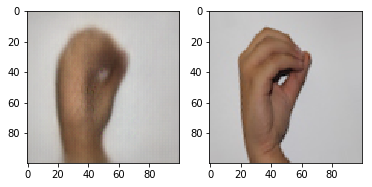

Epoch 9/100
100/100 [==============================] - 32s 322ms/step - loss: 246.6213
86.8302230834961 138.97335598680075 17.925396605908233 327.4134874343872 0.2501151 0.9186046511627907
Digit: 5.0. Predicted: 5. Believability: 0.417


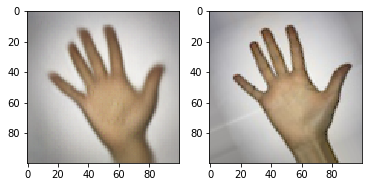

Epoch 10/100
100/100 [==============================] - 32s 323ms/step - loss: 248.5103
84.35773468017578 144.8403716216216 17.941263356379636 452.9942512512207 0.2628766 0.9116907605279698
Digit: 5.0. Predicted: 5. Believability: 0.001


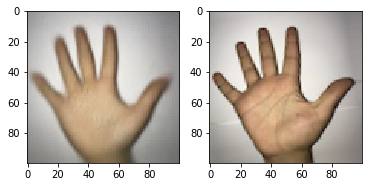

Epoch 11/100
100/100 [==============================] - 32s 322ms/step - loss: 246.0949
86.55467224121094 140.9914362036455 17.9301382778127 265.63355922698975 0.25304472 0.9208045254556882
Digit: 2.0. Predicted: 2. Believability: 0.299


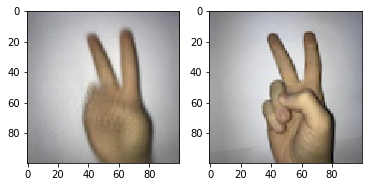

Epoch 12/100
100/100 [==============================] - 32s 324ms/step - loss: 246.5571
89.3592300415039 141.83157212445002 17.935338780641104 300.4784822463989 0.24382783 0.9198617221873036
Digit: 5.0. Predicted: 5. Believability: 0.007


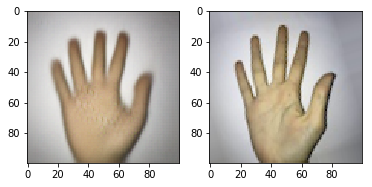

Epoch 13/100
100/100 [==============================] - 32s 323ms/step - loss: 248.3975
88.45586395263672 137.43330648962916 17.92216719044626 390.1987075805664 0.22303607 0.926147077309868
Digit: 5.0. Predicted: 5. Believability: 0.003


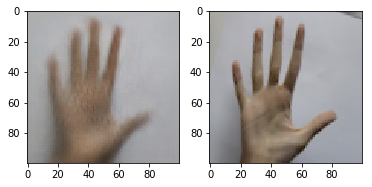

Epoch 14/100
100/100 [==============================] - 32s 323ms/step - loss: 246.2984
84.30712127685547 148.97769681018227 17.948947831552484 425.643253326416 0.2613796 0.9132620993086109
Digit: 3.0. Predicted: 3. Believability: 0.008


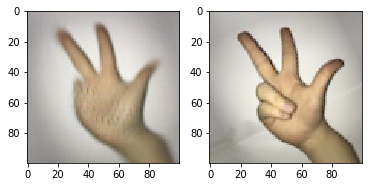

Epoch 15/100
100/100 [==============================] - 32s 323ms/step - loss: 248.2454
85.35858154296875 145.2837739629164 17.939968573224387 394.42458152770996 0.2428647 0.9126335637963545
Digit: 2.0. Predicted: 2. Believability: 0.173


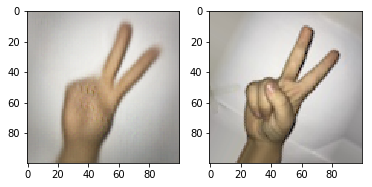

Epoch 16/100
100/100 [==============================] - 32s 323ms/step - loss: 246.5285
88.49942779541016 134.93870796668762 17.916069138906348 324.5091199874878 0.23071188 0.9245757385292269
Digit: 1.0. Predicted: 1. Believability: 0.019


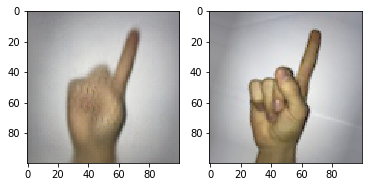

Epoch 17/100
100/100 [==============================] - 32s 323ms/step - loss: 245.5885
87.35131072998047 140.23515084852295 17.927954745443117 276.4505624771118 0.25275204 0.9142049025769956
Digit: 0.0. Predicted: 0. Believability: 0.354


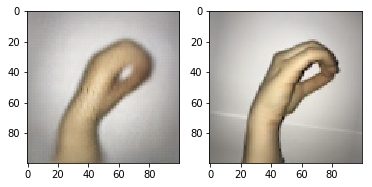

Epoch 18/100
100/100 [==============================] - 32s 324ms/step - loss: 245.9519
85.82673645019531 139.127150769956 17.92569076052797 321.63119316101074 0.26391804 0.9072910119421748
Digit: 8.0. Predicted: 9. Believability: 0.007


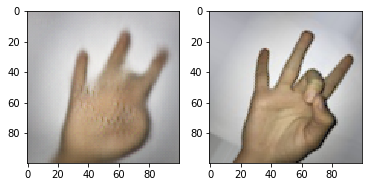

Epoch 19/100
100/100 [==============================] - 32s 323ms/step - loss: 245.6352
87.78326416015625 138.03533548082967 17.92325581395349 400.43654441833496 0.23395397 0.9208045254556882
Digit: 0.0. Predicted: 0. Believability: 0.641


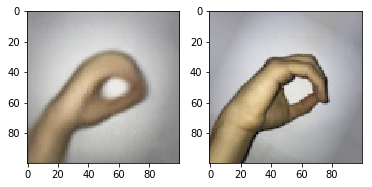

Epoch 20/100
100/100 [==============================] - 32s 325ms/step - loss: 245.4577
86.3067626953125 142.14454352608422 17.93288623507228 290.85304737091064 0.25140765 0.9157762413576367
Digit: 8.0. Predicted: 8. Believability: 0.215


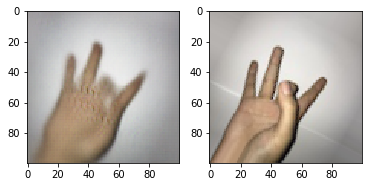

Epoch 21/100
100/100 [==============================] - 32s 323ms/step - loss: 245.6256
87.673095703125 141.15707495285983 17.93150848522942 347.06740379333496 0.23391096 0.921747328724073
Digit: 8.0. Predicted: 8. Believability: 0.014


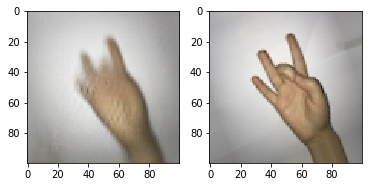

Epoch 22/100
100/100 [==============================] - 32s 322ms/step - loss: 245.5853
85.34765625 157.37643384663733 17.971169076052796 450.9340286254883 0.26363716 0.9094908862350722
Digit: 6.0. Predicted: 6. Believability: 0.066


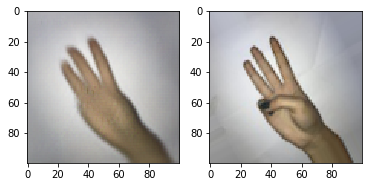

Epoch 23/100
100/100 [==============================] - 33s 325ms/step - loss: 245.1751
85.15642547607422 142.6481085009428 17.932890006285355 413.1916046142578 0.26768082 0.909176618478944
Digit: 9.0. Predicted: 9. Believability: 0.017


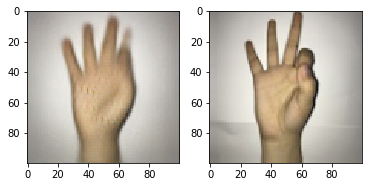

Epoch 24/100
100/100 [==============================] - 32s 322ms/step - loss: 244.9337
85.69464874267578 142.0907546354494 17.934321810182276 310.609769821167 0.26620695 0.9145191703331238
Digit: 1.0. Predicted: 1. Believability: 0.007


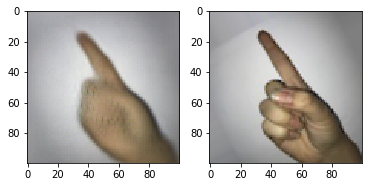

Epoch 25/100
100/100 [==============================] - 32s 323ms/step - loss: 244.4738
88.22285461425781 147.5205943588938 17.943534883720933 515.3167247772217 0.22594461 0.9192331866750472
Digit: 4.0. Predicted: 4. Believability: 0.000


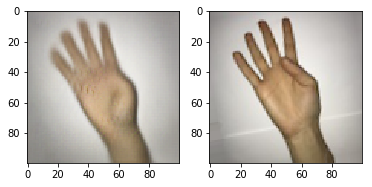

Epoch 26/100
100/100 [==============================] - 32s 323ms/step - loss: 245.7236
86.1590805053711 136.84347501571338 17.920306725329983 287.66562938690186 0.24547778 0.9173475801382778
Digit: 6.0. Predicted: 4. Believability: 0.036


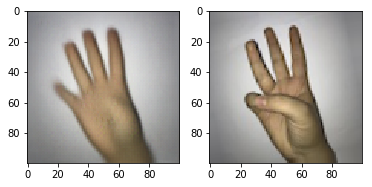

Epoch 27/100
100/100 [==============================] - 32s 323ms/step - loss: 243.9207
87.89555358886719 137.75906466059084 17.922878692646137 281.80909156799316 0.23640558 0.9151477058453803
Digit: 3.0. Predicted: 3. Believability: 0.357


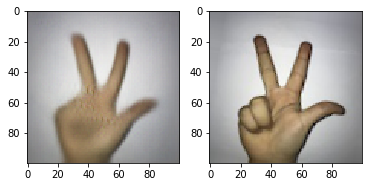

Epoch 28/100
100/100 [==============================] - 32s 323ms/step - loss: 245.3397
86.87954711914062 153.08991004085482 17.957192960402264 543.0258750915527 0.2535491 0.9145191703331238
Digit: 7.0. Predicted: 2. Believability: 0.000


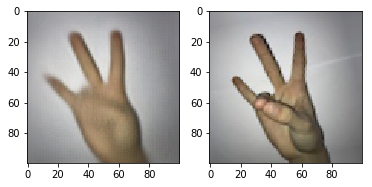

Epoch 29/100
100/100 [==============================] - 32s 324ms/step - loss: 245.8281
87.09175872802734 141.10022195160278 17.929950974230042 347.22819328308105 0.23358086 0.9192331866750472
Digit: 9.0. Predicted: 9. Believability: 0.017


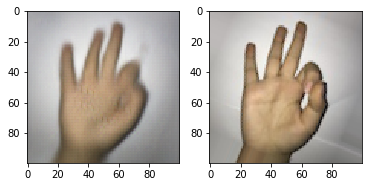

Epoch 30/100
100/100 [==============================] - 32s 323ms/step - loss: 244.1903
85.73245239257812 138.60026123507228 17.925500942803268 276.31893157958984 0.25160155 0.9135763670647391
Digit: 1.0. Predicted: 1. Believability: 0.310


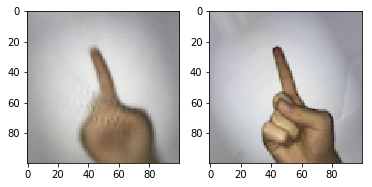

Epoch 31/100
100/100 [==============================] - 32s 324ms/step - loss: 244.3989
84.76534271240234 139.0044979572596 17.92509490886235 388.5061740875244 0.24258217 0.921747328724073
Digit: 8.0. Predicted: 9. Believability: 0.007


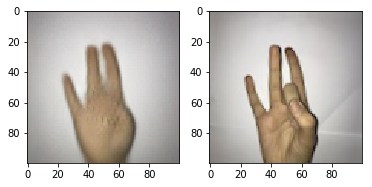

Epoch 32/100
100/100 [==============================] - 32s 323ms/step - loss: 245.4329
84.72823333740234 139.28380342551853 17.92584035197989 370.9202527999878 0.23807499 0.9138906348208674
Digit: 4.0. Predicted: 4. Believability: 0.005


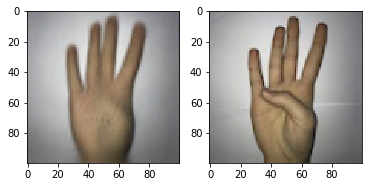

Epoch 33/100
100/100 [==============================] - 32s 323ms/step - loss: 243.1730
85.02691650390625 142.3416876178504 17.933900691389063 382.8829288482666 0.22731444 0.92049025769956
Digit: 1.0. Predicted: 1. Believability: 0.259


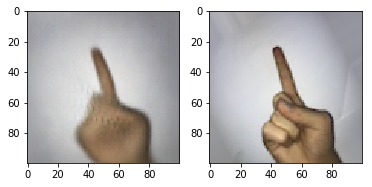

Epoch 34/100
100/100 [==============================] - 32s 322ms/step - loss: 243.7300
87.6322250366211 138.15183060967945 17.922624764299183 437.5663757324219 0.21636193 0.9248900062853551
Digit: 3.0. Predicted: 3. Believability: 0.008


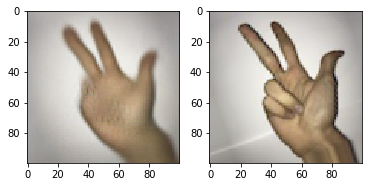

Epoch 35/100
100/100 [==============================] - 32s 322ms/step - loss: 245.6381
86.43396759033203 137.27300047140164 17.921252042740416 400.1924991607666 0.24553843 0.9179761156505343
Digit: 4.0. Predicted: 4. Believability: 0.003


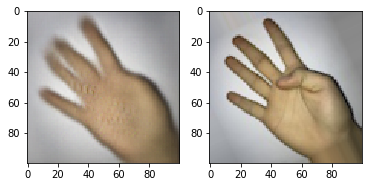

Epoch 36/100
100/100 [==============================] - 32s 325ms/step - loss: 243.4485
85.02369689941406 137.7422807982401 17.92269390320553 277.811336517334 0.251301 0.9116907605279698
Digit: 7.0. Predicted: 7. Believability: 0.044


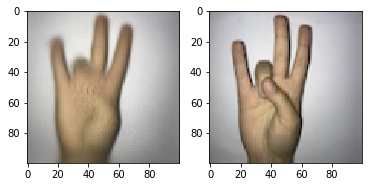

Epoch 37/100
100/100 [==============================] - 32s 322ms/step - loss: 244.3715
87.91709899902344 135.22373900062854 17.91683846637335 389.14008140563965 0.2307315 0.9242614707730987
Digit: 1.0. Predicted: 1. Believability: 0.004


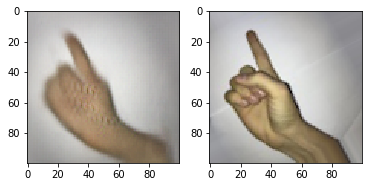

Epoch 38/100
100/100 [==============================] - 32s 324ms/step - loss: 244.6705
88.09774017333984 134.93384663733502 17.917905719673165 370.17242908477783 0.24220565 0.9179761156505343
Digit: 6.0. Predicted: 6. Believability: 0.103


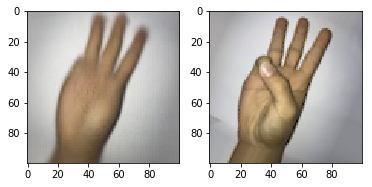

Epoch 39/100
100/100 [==============================] - 32s 322ms/step - loss: 243.3560
87.45038604736328 136.57227176304212 17.920023884349465 365.5078172683716 0.21744637 0.9299182903834067
Digit: 2.0. Predicted: 2. Believability: 0.131


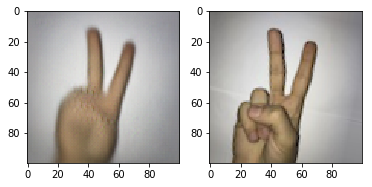

Epoch 40/100
100/100 [==============================] - 32s 324ms/step - loss: 243.8366
88.60989379882812 135.29919272470144 17.916574481458202 302.9059410095215 0.2278007 0.9208045254556882
Digit: 0.0. Predicted: 0. Believability: 0.364


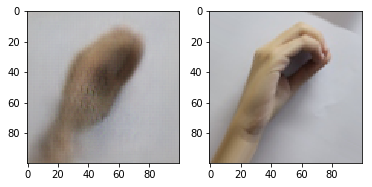

Epoch 41/100
100/100 [==============================] - 32s 322ms/step - loss: 241.5023
83.8304214477539 139.6076465273413 17.926438717787555 262.4659061431885 0.22504531 0.9220615964802011
Digit: 6.0. Predicted: 6. Believability: 0.177


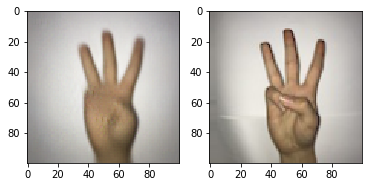

Epoch 42/100
100/100 [==============================] - 32s 324ms/step - loss: 242.4292
86.44776153564453 136.67077506285355 17.920115650534257 406.2401294708252 0.23966959 0.9186046511627907
Digit: 2.0. Predicted: 3. Believability: 0.016


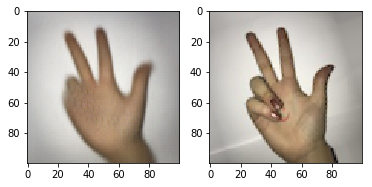

Epoch 43/100
100/100 [==============================] - 32s 322ms/step - loss: 243.0065
84.34402465820312 137.59918093966058 17.92213576367065 379.10821437835693 0.26483503 0.9066624764299183
Digit: 7.0. Predicted: 7. Believability: 0.009


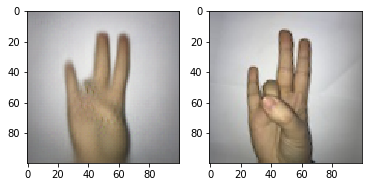

Epoch 44/100
100/100 [==============================] - 32s 323ms/step - loss: 242.1492
83.87506103515625 137.93304132620992 17.922837209302326 383.1807613372803 0.25960407 0.907605279698303
Digit: 0.0. Predicted: 0. Believability: 0.013


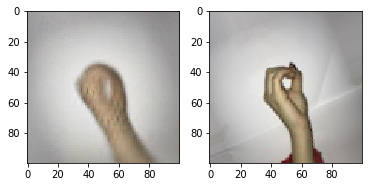

Epoch 45/100
100/100 [==============================] - 32s 322ms/step - loss: 242.2132
85.22715759277344 136.30238450659962 17.920108108108106 356.5716743469238 0.24968009 0.9079195474544312
Digit: 7.0. Predicted: 7. Believability: 0.147


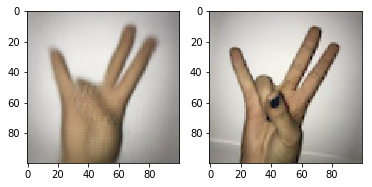

Epoch 46/100
100/100 [==============================] - 32s 323ms/step - loss: 243.3526
85.34712982177734 141.43769641734758 17.93208045254557 361.1309051513672 0.24171185 0.9107479572595851
Digit: 4.0. Predicted: 4. Believability: 0.006


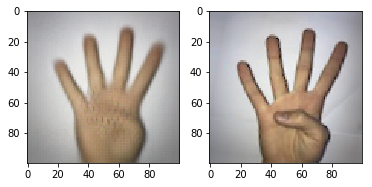

Epoch 47/100
100/100 [==============================] - 32s 322ms/step - loss: 241.7040
87.19384765625 133.22984758013828 17.912242614707733 304.4634819030762 0.2229898 0.9201759899434317
Digit: 0.0. Predicted: 0. Believability: 0.040


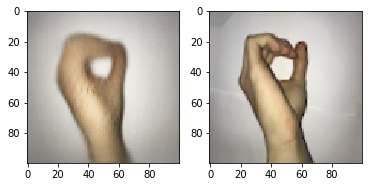

Epoch 48/100
100/100 [==============================] - 32s 323ms/step - loss: 240.3441
84.24224090576172 135.68307078881207 17.917777498428663 317.87683963775635 0.2563087 0.9123192960402263
Digit: 8.0. Predicted: 8. Believability: 0.006


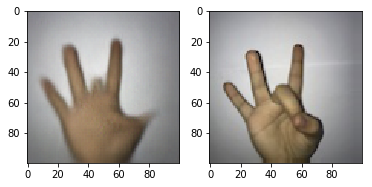

Epoch 49/100
100/100 [==============================] - 32s 323ms/step - loss: 242.9594
86.24836730957031 134.3502121307354 17.91441734758014 319.4892644882202 0.24253687 0.9138906348208674
Digit: 4.0. Predicted: 4. Believability: 0.078


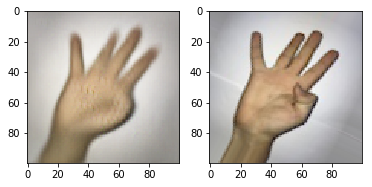

Epoch 50/100
100/100 [==============================] - 32s 322ms/step - loss: 241.6951
87.93971252441406 134.45909608736645 17.915284726587053 223.69754314422607 0.229034 0.9195474544311754
Digit: 4.0. Predicted: 4. Believability: 0.103


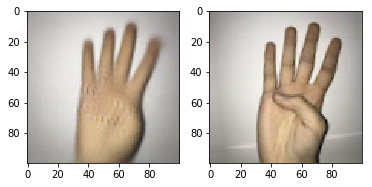

Epoch 51/100
100/100 [==============================] - 32s 324ms/step - loss: 242.4596
87.17364501953125 146.73848012256443 17.94441986172219 455.1121711730957 0.24295251 0.9186046511627907
Digit: 5.0. Predicted: 5. Believability: 0.083


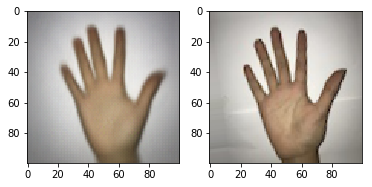

Epoch 52/100
100/100 [==============================] - 32s 321ms/step - loss: 242.0266
87.80501556396484 133.57645545254556 17.912620993086108 271.9087600708008 0.23857109 0.9154619736015085
Digit: 4.0. Predicted: 4. Believability: 0.940


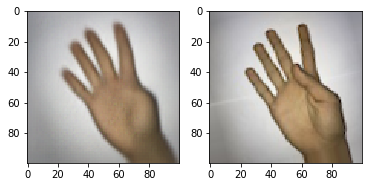

Epoch 53/100
100/100 [==============================] - 32s 324ms/step - loss: 242.8429
86.83223724365234 135.1622800125707 17.91688246385921 330.6295871734619 0.2301577 0.9167190446260214
Digit: 0.0. Predicted: 0. Believability: 0.280


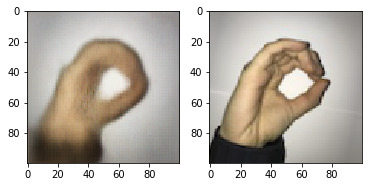

Epoch 54/100
100/100 [==============================] - 32s 322ms/step - loss: 239.6427
85.29190826416016 141.58040344123194 17.931257071024515 290.2275323867798 0.24254423 0.9142049025769956
Digit: 0.0. Predicted: 0. Believability: 0.049


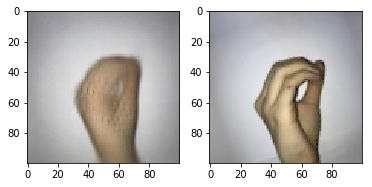

Epoch 55/100
100/100 [==============================] - 32s 325ms/step - loss: 242.3127
86.59027099609375 133.76087170018857 17.91436203645506 306.84964656829834 0.22787075 0.9270898805782527
Digit: 9.0. Predicted: 9. Believability: 0.003


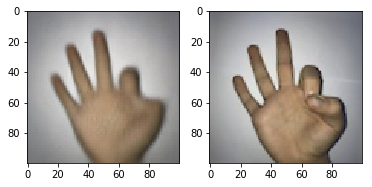

Epoch 56/100
100/100 [==============================] - 32s 322ms/step - loss: 241.7159
87.42204284667969 139.24713230672532 17.929151477058454 293.9828157424927 0.21662377 0.9286612193588938
Digit: 2.0. Predicted: 2. Believability: 0.094


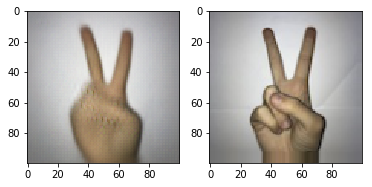

Epoch 57/100
100/100 [==============================] - 32s 324ms/step - loss: 240.6141
86.47784423828125 137.0940740886235 17.92047265870522 268.19400787353516 0.23287569 0.9236329352608422
Digit: 7.0. Predicted: 7. Believability: 0.050


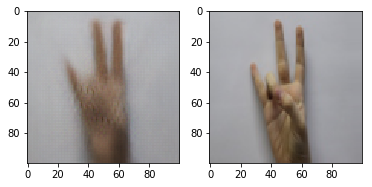

Epoch 58/100
100/100 [==============================] - 32s 322ms/step - loss: 242.1732
89.13091278076172 138.537623742929 17.92686109365179 289.59801197052 0.21966699 0.9236329352608422
Digit: 6.0. Predicted: 6. Believability: 0.091


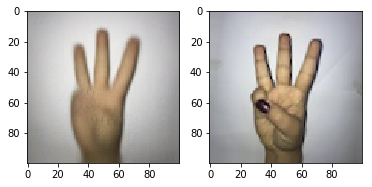

Epoch 59/100
100/100 [==============================] - 32s 324ms/step - loss: 240.6257
86.20062255859375 131.47485857950974 17.90803016970459 289.1941547393799 0.2159748 0.9252042740414833
Digit: 9.0. Predicted: 9. Believability: 0.067


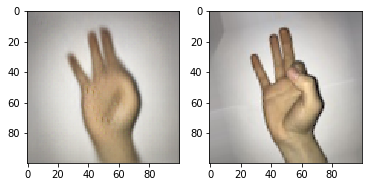

Epoch 60/100
100/100 [==============================] - 32s 322ms/step - loss: 241.8212
86.33086395263672 140.96424222187304 17.93075801382778 392.12327003479004 0.2300419 0.9186046511627907
Digit: 9.0. Predicted: 9. Believability: 0.003


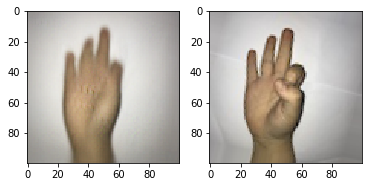

Epoch 61/100
100/100 [==============================] - 32s 323ms/step - loss: 241.9329
85.06153869628906 137.5602117379007 17.922424890006287 356.56208992004395 0.2276894 0.9242614707730987
Digit: 9.0. Predicted: 9. Believability: 0.011


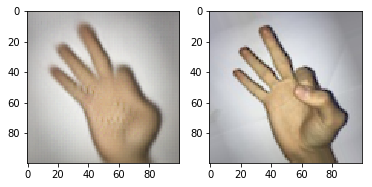

Epoch 62/100
100/100 [==============================] - 32s 324ms/step - loss: 241.0962
84.18665313720703 135.43008524512885 17.916947831552484 351.8521785736084 0.24010362 0.9157762413576367
Digit: 9.0. Predicted: 9. Believability: 0.008


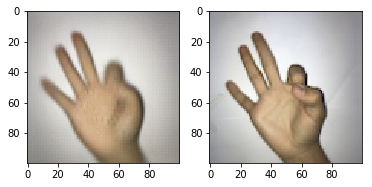

Epoch 63/100
100/100 [==============================] - 32s 322ms/step - loss: 239.9093
88.19651794433594 146.44328449088624 17.9434204902577 283.8212013244629 0.22600369 0.9223758642363293
Digit: 7.0. Predicted: 7. Believability: 0.095


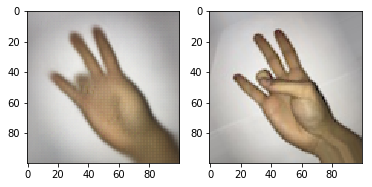

Epoch 64/100
100/100 [==============================] - 32s 324ms/step - loss: 241.3075
85.74051666259766 134.0717119736015 17.9142614707731 227.2730588912964 0.22910309 0.918918918918919
Digit: 2.0. Predicted: 2. Believability: 0.035


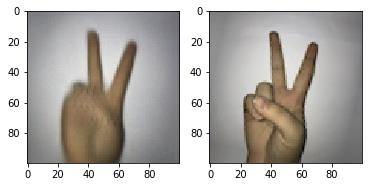

Epoch 65/100
100/100 [==============================] - 32s 322ms/step - loss: 240.4038
82.70414733886719 137.2635233343809 17.921676932746703 414.9960994720459 0.26924908 0.9038340666247643
Digit: 8.0. Predicted: 8. Believability: 0.005


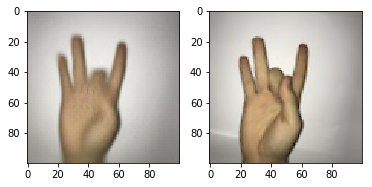

Epoch 66/100
100/100 [==============================] - 32s 325ms/step - loss: 238.8481
89.81611633300781 132.39288379949718 17.912491514770583 245.38254737854004 0.21495414 0.9252042740414833
Digit: 6.0. Predicted: 6. Believability: 0.032


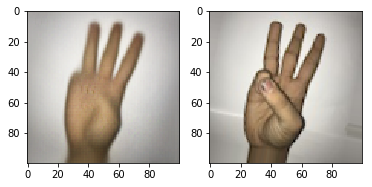

Epoch 67/100
100/100 [==============================] - 32s 322ms/step - loss: 240.2786
86.30895233154297 133.29735622250158 17.91237712130735 252.08561420440674 0.23211165 0.9170333123821496
Digit: 1.0. Predicted: 1. Believability: 0.078


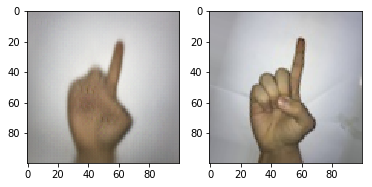

Epoch 68/100
100/100 [==============================] - 32s 323ms/step - loss: 240.7782
87.00135803222656 130.69533705216844 17.906340666247644 301.72321796417236 0.22400096 0.9154619736015085
Digit: 0.0. Predicted: 0. Believability: 0.020


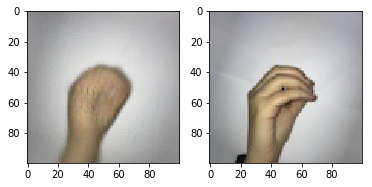

Epoch 69/100
100/100 [==============================] - 32s 323ms/step - loss: 239.2860
85.33567810058594 140.47039990571966 17.930363293526085 404.75025177001953 0.25159594 0.909176618478944
Digit: 4.0. Predicted: 4. Believability: 0.007


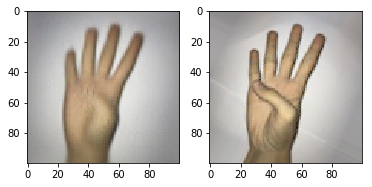

Epoch 70/100
100/100 [==============================] - 32s 323ms/step - loss: 240.6918
86.8260498046875 148.21621621621622 17.95043746071653 303.36594581604004 0.23844029 0.92049025769956
Digit: 9.0. Predicted: 9. Believability: 0.081


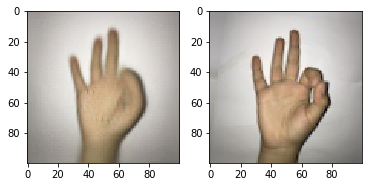

Epoch 71/100
100/100 [==============================] - 32s 323ms/step - loss: 238.6696
85.53388977050781 137.5565681961031 17.923058453802643 346.8201160430908 0.24378595 0.914833438089252
Digit: 1.0. Predicted: 1. Believability: 0.114


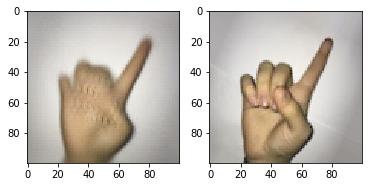

Epoch 72/100
100/100 [==============================] - 32s 323ms/step - loss: 239.1490
85.94132995605469 138.61248821495914 17.926546825895663 312.69495487213135 0.22382128 0.9267756128221244
Digit: 0.0. Predicted: 0. Believability: 0.033


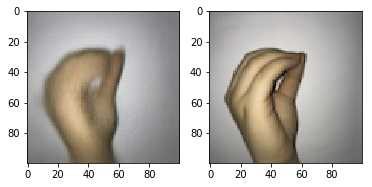

Epoch 73/100
100/100 [==============================] - 32s 323ms/step - loss: 239.2239
83.66098022460938 136.77065328409805 17.920294154619736 269.88091468811035 0.22521546 0.923318667504714
Digit: 4.0. Predicted: 4. Believability: 0.304


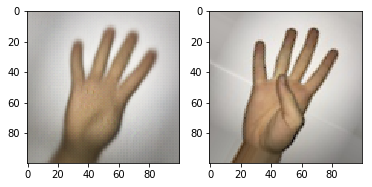

Epoch 74/100
100/100 [==============================] - 32s 322ms/step - loss: 239.0180
86.69263458251953 134.57715273412947 17.915566310496544 216.0017490386963 0.21165837 0.9242614707730987
Digit: 3.0. Predicted: 3. Believability: 0.063


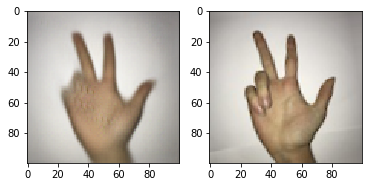

Epoch 75/100
100/100 [==============================] - 32s 324ms/step - loss: 238.9749
86.716552734375 133.61537554996858 17.91448648648649 254.58452701568604 0.23866943 0.9186046511627907
Digit: 4.0. Predicted: 4. Believability: 0.030


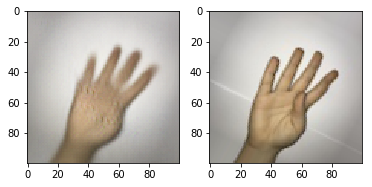

Epoch 76/100
100/100 [==============================] - 32s 322ms/step - loss: 237.9953
84.9713363647461 136.89312932118165 17.922906348208674 299.15692806243896 0.23336019 0.921747328724073
Digit: 3.0. Predicted: 3. Believability: 0.077


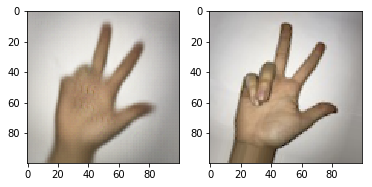

Epoch 77/100
100/100 [==============================] - 32s 323ms/step - loss: 238.3061
86.34600830078125 138.23289204902576 17.923034569453176 423.0806827545166 0.22695015 0.9255185417976116
Digit: 7.0. Predicted: 4. Believability: 0.026


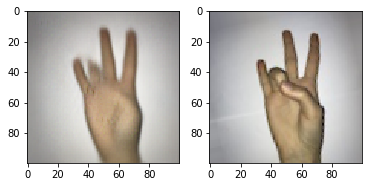

Epoch 78/100
100/100 [==============================] - 32s 322ms/step - loss: 238.2125
85.14166259765625 135.27073185103708 17.916485229415464 247.59299755096436 0.21846245 0.9252042740414833
Digit: 2.0. Predicted: 2. Believability: 0.128


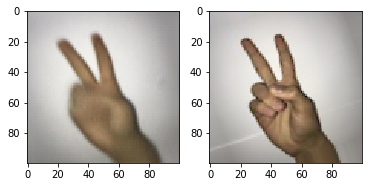

Epoch 79/100
100/100 [==============================] - 32s 323ms/step - loss: 239.2802
86.70015716552734 129.96637335009427 17.90495034569453 327.5076627731323 0.20546803 0.9283469516027656
Digit: 5.0. Predicted: 5. Believability: 0.101


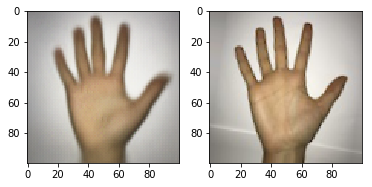

Epoch 80/100
100/100 [==============================] - 32s 322ms/step - loss: 238.3776
84.71492004394531 132.53290972658706 17.910864864864863 292.09868907928467 0.23430975 0.92049025769956
Digit: 5.0. Predicted: 5. Believability: 0.006


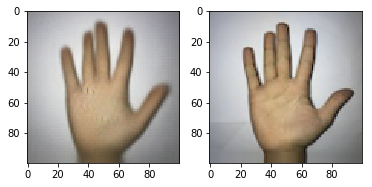

Epoch 81/100
100/100 [==============================] - 32s 324ms/step - loss: 237.8753
85.26240539550781 132.58346755185417 17.91043746071653 301.59614086151123 0.22680983 0.921747328724073
Digit: 6.0. Predicted: 6. Believability: 0.613


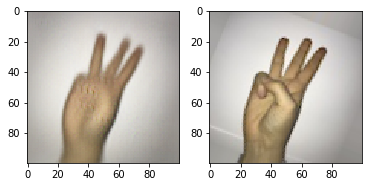

Epoch 82/100
100/100 [==============================] - 32s 322ms/step - loss: 239.8659
87.72441864013672 130.65457063167818 17.90712759270899 233.73656272888184 0.21031852 0.9292897548711502
Digit: 5.0. Predicted: 5. Believability: 0.122


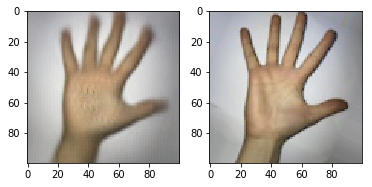

Epoch 83/100
100/100 [==============================] - 32s 323ms/step - loss: 237.9873
82.22221374511719 135.80944571024514 17.918496543054683 262.09380626678467 0.24774526 0.9145191703331238
Digit: 7.0. Predicted: 7. Believability: 0.562


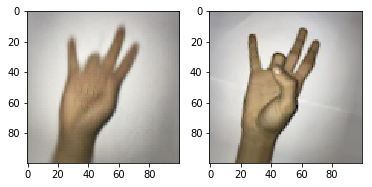

Epoch 84/100
100/100 [==============================] - 32s 323ms/step - loss: 237.2972
88.51995849609375 138.21287712130734 17.926896291640478 260.5219602584839 0.21749008 0.9236329352608422
Digit: 4.0. Predicted: 4. Believability: 0.080


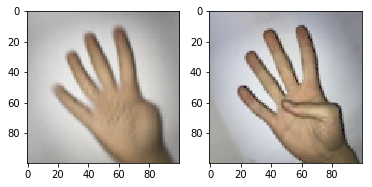

Epoch 85/100
100/100 [==============================] - 32s 323ms/step - loss: 237.8906
87.24742889404297 129.83232833123822 17.904472658705217 333.4277868270874 0.2408569 0.9138906348208674
Digit: 2.0. Predicted: 2. Believability: 0.113


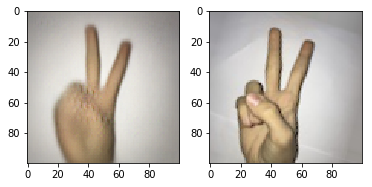

Epoch 86/100
100/100 [==============================] - 32s 323ms/step - loss: 238.1449
83.7010498046875 136.7261843966059 17.920639849151478 301.94032192230225 0.23635337 0.9179761156505343
Digit: 5.0. Predicted: 5. Believability: 0.004


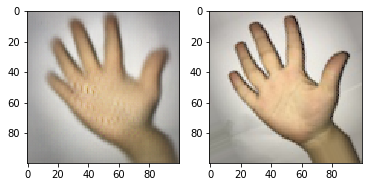

Epoch 87/100
100/100 [==============================] - 32s 322ms/step - loss: 237.7646
87.2177963256836 131.23665344123194 17.90731741043369 320.7336664199829 0.21671271 0.9283469516027656
Digit: 0.0. Predicted: 0. Believability: 0.464


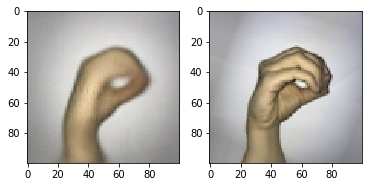

Epoch 88/100
100/100 [==============================] - 32s 324ms/step - loss: 236.6991
84.3755111694336 137.5677836266499 17.922795725958515 210.27872562408447 0.21854779 0.923318667504714
Digit: 6.0. Predicted: 6. Believability: 0.533


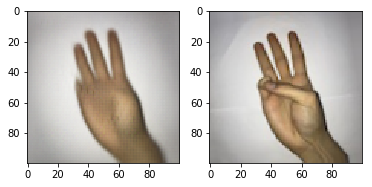

Epoch 89/100
100/100 [==============================] - 32s 322ms/step - loss: 238.2547
85.8049545288086 133.1891891891892 17.912920175989946 360.55662631988525 0.230146 0.9226901319924575
Digit: 6.0. Predicted: 6. Believability: 0.052


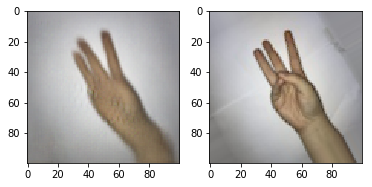

Epoch 90/100
100/100 [==============================] - 32s 323ms/step - loss: 237.7485
87.30028533935547 130.1805271841609 17.905368950345697 316.5849208831787 0.22490634 0.9208045254556882
Digit: 1.0. Predicted: 1. Believability: 0.071


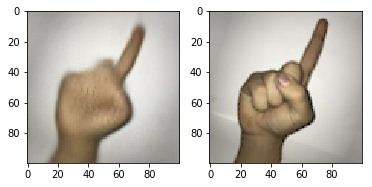

Epoch 91/100
100/100 [==============================] - 32s 322ms/step - loss: 238.7656
84.4493179321289 131.64775494971715 17.90874921433061 289.8350238800049 0.2300377 0.9258328095537398
Digit: 7.0. Predicted: 7. Believability: 0.420


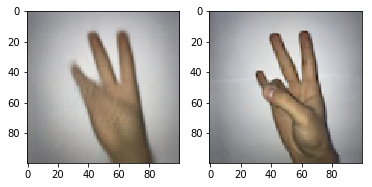

Epoch 92/100
100/100 [==============================] - 32s 325ms/step - loss: 237.1345
83.3636474609375 139.11888159962288 17.926823381521057 229.1048526763916 0.24167484 0.921747328724073
Digit: 7.0. Predicted: 7. Believability: 0.312


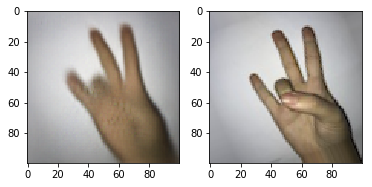

Epoch 93/100
100/100 [==============================] - 32s 321ms/step - loss: 236.0633
83.73625946044922 133.95872289440604 17.91427278441232 269.70629692077637 0.21852902 0.9283469516027656
Digit: 3.0. Predicted: 3. Believability: 0.033


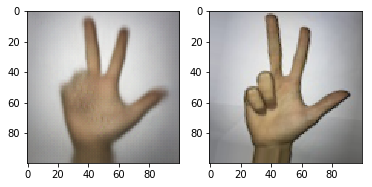

Epoch 94/100
100/100 [==============================] - 32s 323ms/step - loss: 238.2901
87.89472198486328 128.33550047140164 17.90102199874293 350.9176731109619 0.22189222 0.9264613450659962
Digit: 0.0. Predicted: 0. Believability: 0.015


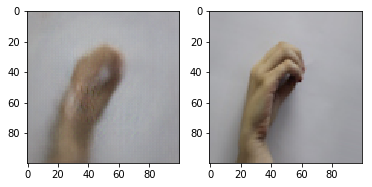

Epoch 95/100
100/100 [==============================] - 32s 322ms/step - loss: 237.8181
85.09481811523438 133.66931175361407 17.914319296040226 268.56892108917236 0.22242577 0.9211187932118164
Digit: 8.0. Predicted: 8. Believability: 0.205


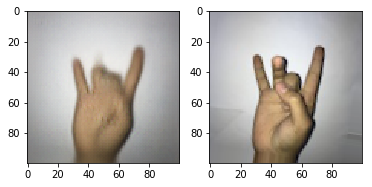

Epoch 96/100
100/100 [==============================] - 32s 323ms/step - loss: 236.0008
85.5955581665039 134.20063049968573 17.91492520427404 313.4134292602539 0.22891234 0.9214330609679446
Digit: 5.0. Predicted: 5. Believability: 0.007


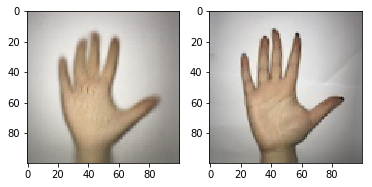

Epoch 97/100
100/100 [==============================] - 32s 322ms/step - loss: 236.5566
84.93419647216797 138.01527144877434 17.925353865493403 190.90873003005981 0.24204071 0.914833438089252
Digit: 2.0. Predicted: 2. Believability: 0.075


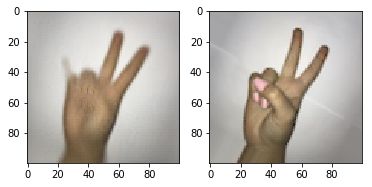

Epoch 98/100
100/100 [==============================] - 32s 324ms/step - loss: 236.2819
84.79900360107422 131.34820867379008 17.907918290383407 221.44033908843994 0.23144932 0.9198617221873036
Digit: 9.0. Predicted: 9. Believability: 0.384


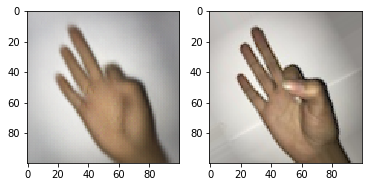

Epoch 99/100
100/100 [==============================] - 32s 322ms/step - loss: 236.9472
85.71641540527344 131.24923397234443 17.907757385292268 267.49424934387207 0.21736069 0.9258328095537398
Digit: 9.0. Predicted: 9. Believability: 0.011


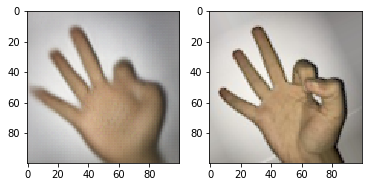

Epoch 100/100
100/100 [==============================] - 32s 323ms/step - loss: 236.5039
86.61483764648438 131.27228354808295 17.909487115022 205.06131649017334 0.20052344 0.9355751099937146
Digit: 5.0. Predicted: 5. Believability: 0.021


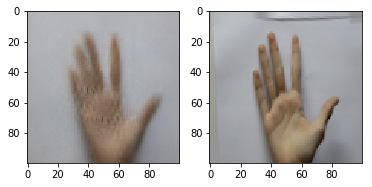

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=100)

In [0]:
forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
authenticator.save_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

 --- Forgerer --- 
Epoch 1/100
100/100 [==============================] - 32s 324ms/step - loss: 236.2036
82.74853515625 136.49149512884978 17.919400377121306 264.1939401626587 0.21683726 0.926147077309868
Digit: 7.0. Predicted: 7. Believability: 0.005


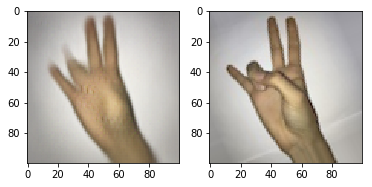

Epoch 2/100
100/100 [==============================] - 32s 321ms/step - loss: 235.6247
87.78274536132812 135.23847030169705 17.91853425518542 190.86999893188477 0.21050142 0.9264613450659962
Digit: 0.0. Predicted: 0. Believability: 0.098


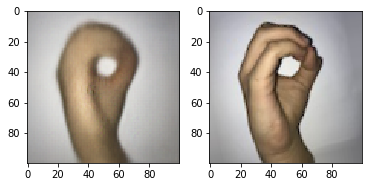

Epoch 3/100
100/100 [==============================] - 32s 325ms/step - loss: 236.5878
83.65039825439453 134.16882071024514 17.914218730358265 338.9752388000488 0.23162262 0.9211187932118164
Digit: 8.0. Predicted: 8. Believability: 0.023


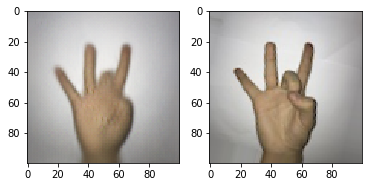

Epoch 4/100
100/100 [==============================] - 32s 322ms/step - loss: 236.0219
87.27916717529297 132.88184514456316 17.912848522941545 317.71602630615234 0.21783574 0.926147077309868
Digit: 8.0. Predicted: 8. Believability: 0.025


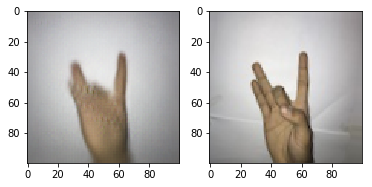

Epoch 5/100
100/100 [==============================] - 32s 324ms/step - loss: 236.3555
87.15359497070312 130.98946220930233 17.90714142049026 316.89741611480713 0.22223018 0.9223758642363293
Digit: 5.0. Predicted: 5. Believability: 0.012


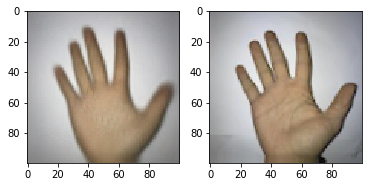

Epoch 6/100
100/100 [==============================] - 32s 322ms/step - loss: 236.2951
89.85551452636719 129.78731929604024 17.90553362664991 258.76944065093994 0.20938204 0.9252042740414833
Digit: 6.0. Predicted: 6. Believability: 0.051


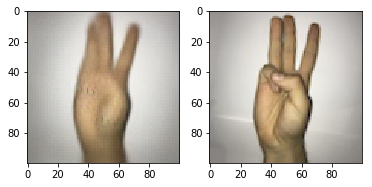

Epoch 7/100
100/100 [==============================] - 32s 323ms/step - loss: 235.6637
87.36383056640625 126.47443628221245 17.896700188560654 219.06723976135254 0.22722508 0.9220615964802011
Digit: 8.0. Predicted: 8. Believability: 0.244


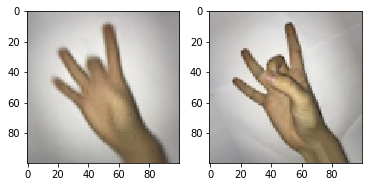

Epoch 8/100
100/100 [==============================] - 32s 322ms/step - loss: 236.2764
86.41123962402344 133.49755460402264 17.91276052796983 180.35706281661987 0.21193743 0.9255185417976116
Digit: 2.0. Predicted: 2. Believability: 0.768


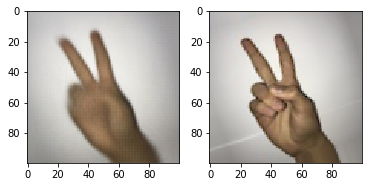

Epoch 9/100
100/100 [==============================] - 32s 323ms/step - loss: 235.3661
85.1568603515625 134.17695238843496 17.915973601508487 251.11286640167236 0.1984096 0.931803896920176
Digit: 3.0. Predicted: 5. Believability: 0.038


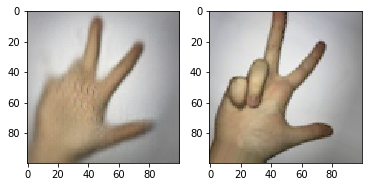

Epoch 10/100
100/100 [==============================] - 32s 323ms/step - loss: 235.1540
86.93896484375 150.74094516027657 17.95578252671276 372.56927490234375 0.21607947 0.926147077309868
Digit: 3.0. Predicted: 3. Believability: 0.008


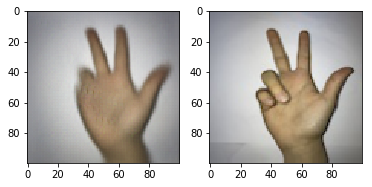

Epoch 11/100
100/100 [==============================] - 32s 322ms/step - loss: 236.0660
88.68811798095703 129.40517952545568 17.90292520427404 300.17364025115967 0.20136769 0.931803896920176
Digit: 0.0. Predicted: 0. Believability: 0.004


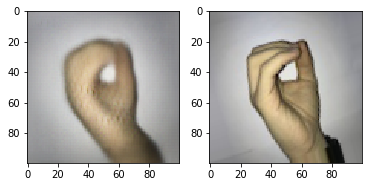

Epoch 12/100
100/100 [==============================] - 32s 324ms/step - loss: 236.0207
87.90650177001953 135.98206709616593 17.92362413576367 244.15717124938965 0.20106581 0.9258328095537398
Digit: 7.0. Predicted: 7. Believability: 0.222


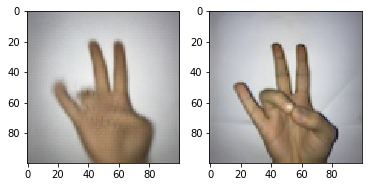

Epoch 13/100
100/100 [==============================] - 32s 322ms/step - loss: 235.7612
85.90959167480469 131.07074952859836 17.907009428032683 337.665057182312 0.21984811 0.923318667504714
Digit: 2.0. Predicted: 2. Believability: 0.048


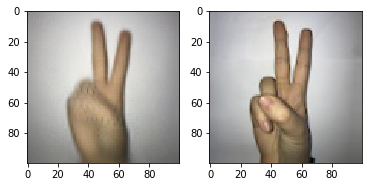

Epoch 14/100
100/100 [==============================] - 32s 323ms/step - loss: 236.1373
84.31609344482422 130.77125235700817 17.906820867379007 309.6068859100342 0.22523196 0.9214330609679446
Digit: 9.0. Predicted: 9. Believability: 0.061


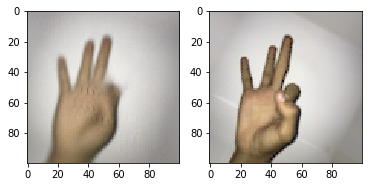

Epoch 15/100
100/100 [==============================] - 32s 322ms/step - loss: 234.6656
85.1546401977539 130.92980043997485 17.90684726587052 282.187557220459 0.22641204 0.9223758642363293
Digit: 4.0. Predicted: 4. Believability: 0.248


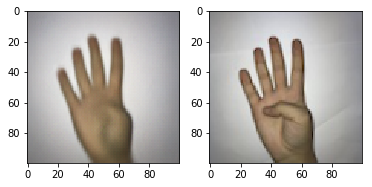

Epoch 16/100
100/100 [==============================] - 32s 323ms/step - loss: 234.9727
83.63829040527344 136.004586345066 17.91875172847266 255.13684749603271 0.21353571 0.9274041483343809
Digit: 9.0. Predicted: 9. Believability: 0.019


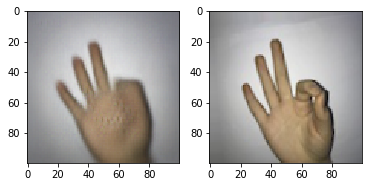

Epoch 17/100
100/100 [==============================] - 32s 322ms/step - loss: 235.4870
86.86653137207031 146.99754478315523 17.945901948460087 268.07422637939453 0.21187113 0.923318667504714
Digit: 4.0. Predicted: 4. Believability: 0.011


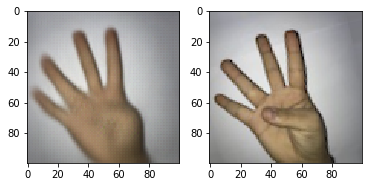

Epoch 18/100
100/100 [==============================] - 32s 324ms/step - loss: 235.1544
86.35755157470703 128.44140870521684 17.90151225644249 276.7695903778076 0.20144202 0.9308610936517914
Digit: 9.0. Predicted: 9. Believability: 0.076


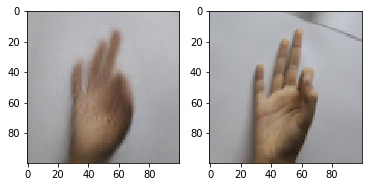

Epoch 19/100
100/100 [==============================] - 32s 322ms/step - loss: 235.3037
86.96562957763672 128.72049811439345 17.902512884978 228.08825969696045 0.19854254 0.9327467001885607
Digit: 0.0. Predicted: 0. Believability: 0.591


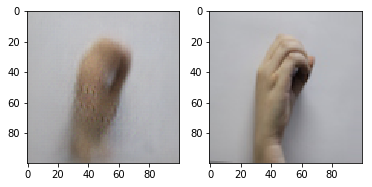

Epoch 20/100
100/100 [==============================] - 32s 323ms/step - loss: 233.6695
85.18863677978516 128.08174890006285 17.9003846637335 324.5699882507324 0.20930687 0.9324324324324325
Digit: 8.0. Predicted: 8. Believability: 0.035


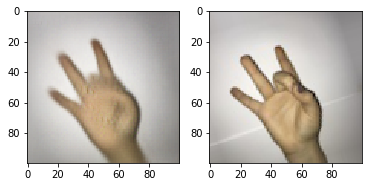

Epoch 21/100
100/100 [==============================] - 32s 322ms/step - loss: 236.0025
88.98758697509766 132.74422532998113 17.911473287240728 301.03352069854736 0.20612608 0.9296040226272785
Digit: 0.0. Predicted: 0. Believability: 0.013


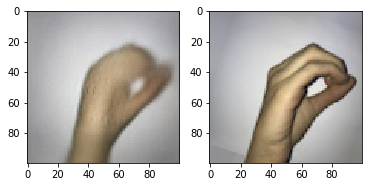

Epoch 22/100
100/100 [==============================] - 32s 323ms/step - loss: 234.0451
85.3041000366211 128.56748900062854 17.90148460087995 271.8118190765381 0.19903411 0.9311753614079196
Digit: 2.0. Predicted: 2. Believability: 0.084


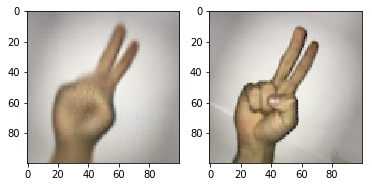

Epoch 23/100
100/100 [==============================] - 32s 324ms/step - loss: 233.6293
86.40036010742188 127.92493911062225 17.90036203645506 332.14404582977295 0.20762141 0.9280326838466373
Digit: 2.0. Predicted: 2. Believability: 0.310


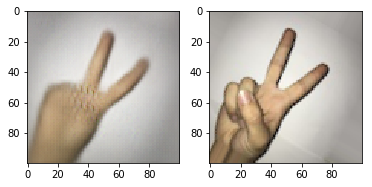

Epoch 24/100
100/100 [==============================] - 32s 322ms/step - loss: 234.4448
85.1397476196289 130.38667701131365 17.90590823381521 238.04762363433838 0.20725141 0.9270898805782527
Digit: 3.0. Predicted: 3. Believability: 0.894


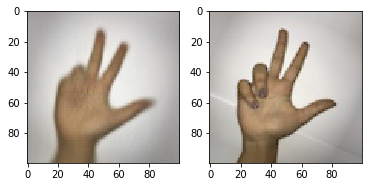

Epoch 25/100
100/100 [==============================] - 32s 324ms/step - loss: 235.3784
86.68013763427734 132.80339605593966 17.915438089252042 162.23886013031006 0.21766125 0.9274041483343809
Digit: 6.0. Predicted: 6. Believability: 0.633


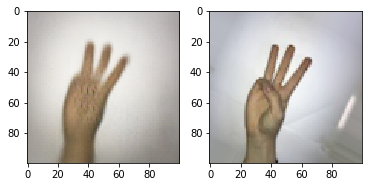

Epoch 26/100
100/100 [==============================] - 32s 322ms/step - loss: 234.5138
85.78334045410156 127.95297768698931 17.900126964173477 292.57054328918457 0.21264562 0.9296040226272785
Digit: 9.0. Predicted: 9. Believability: 0.002


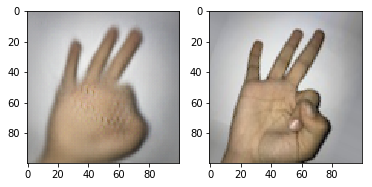

Epoch 27/100
100/100 [==============================] - 32s 324ms/step - loss: 235.0592
83.37698364257812 133.67273923632936 17.9135436832181 275.3037691116333 0.23328212 0.9211187932118164
Digit: 3.0. Predicted: 3. Believability: 0.012


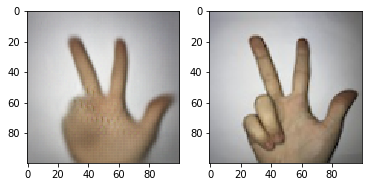

Epoch 28/100
100/100 [==============================] - 32s 322ms/step - loss: 233.3532
86.79461669921875 126.10861879321182 17.895591451917035 331.7594289779663 0.21962506 0.9236329352608422
Digit: 1.0. Predicted: 1. Believability: 0.216


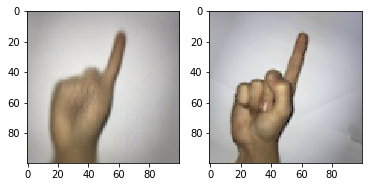

Epoch 29/100
100/100 [==============================] - 32s 324ms/step - loss: 234.9266
85.43620300292969 129.9682393148963 17.904786926461345 330.8605909347534 0.19877994 0.9343180389692017
Digit: 2.0. Predicted: 2. Believability: 0.142


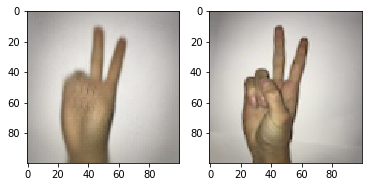

Epoch 30/100
100/100 [==============================] - 32s 323ms/step - loss: 234.4560
87.0467300415039 130.79297611565053 17.9078001257071 351.06258392333984 0.22176182 0.9242614707730987
Digit: 3.0. Predicted: 3. Believability: 0.067


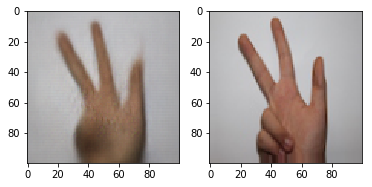

Epoch 31/100
100/100 [==============================] - 32s 324ms/step - loss: 232.9118
86.04916381835938 129.14897273727215 17.902814582023886 270.64170837402344 0.1924685 0.9330609679446888
Digit: 7.0. Predicted: 7. Believability: 0.037


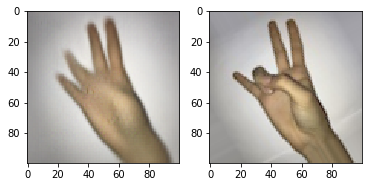

Epoch 32/100
100/100 [==============================] - 32s 323ms/step - loss: 235.2365
85.72026062011719 128.68757856693904 17.90164047768699 249.72009658813477 0.22031406 0.9277184160905091
Digit: 8.0. Predicted: 8. Believability: 0.084


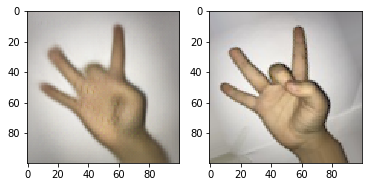

Epoch 33/100
100/100 [==============================] - 32s 323ms/step - loss: 232.2093
86.25951385498047 129.75869146763043 17.905969830295412 257.20579624176025 0.20821238 0.9252042740414833
Digit: 9.0. Predicted: 9. Believability: 0.005


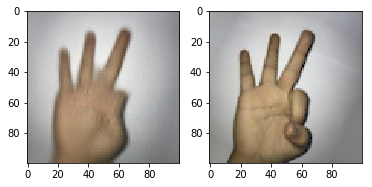

Epoch 34/100
100/100 [==============================] - 32s 323ms/step - loss: 235.0476
84.9808120727539 130.8220949874293 17.906961659333753 291.29490852355957 0.21769302 0.9223758642363293
Digit: 1.0. Predicted: 1. Believability: 0.084


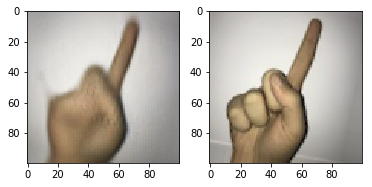

Epoch 35/100
100/100 [==============================] - 32s 322ms/step - loss: 232.2817
86.84235382080078 143.78427482715273 17.94089126335638 312.1662378311157 0.22101071 0.921747328724073
Digit: 2.0. Predicted: 2. Believability: 0.108


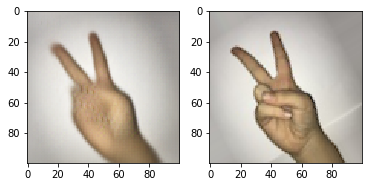

Epoch 36/100
100/100 [==============================] - 32s 324ms/step - loss: 234.1845
83.5539779663086 130.75756206788182 17.906745443117536 347.29011058807373 0.21367952 0.9270898805782527
Digit: 7.0. Predicted: 7. Believability: 0.193


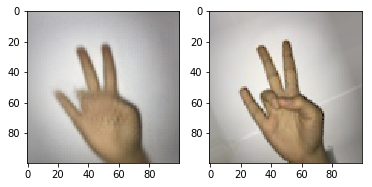

Epoch 37/100
100/100 [==============================] - 32s 322ms/step - loss: 232.5334
86.87290954589844 126.29918290383407 17.896439974858577 308.63780975341797 0.18735138 0.9308610936517914
Digit: 1.0. Predicted: 1. Believability: 0.011


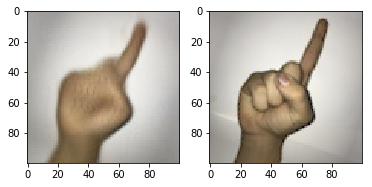

Epoch 38/100
100/100 [==============================] - 32s 323ms/step - loss: 234.3153
87.92256927490234 123.5966962602137 17.890189817724703 314.6817684173584 0.21926454 0.921747328724073
Digit: 2.0. Predicted: 2. Believability: 0.222


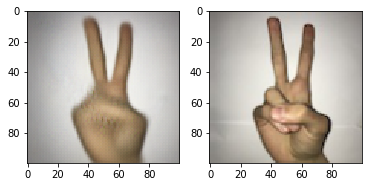

Epoch 39/100
100/100 [==============================] - 32s 323ms/step - loss: 232.1204
88.03252410888672 123.94626021370208 17.89106725329981 274.35152530670166 0.21499488 0.9308610936517914
Digit: 7.0. Predicted: 7. Believability: 0.028


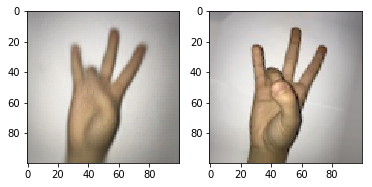

Epoch 40/100
100/100 [==============================] - 32s 324ms/step - loss: 233.1024
83.13448333740234 136.51513395663105 17.919606536769326 163.57896327972412 0.21178746 0.9311753614079196
Digit: 4.0. Predicted: 4. Believability: 0.011


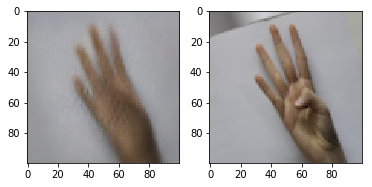

Epoch 41/100
100/100 [==============================] - 32s 322ms/step - loss: 232.5507
86.7525405883789 126.69490493400377 17.897474544311756 316.8527841567993 0.20300291 0.9305468258956631
Digit: 6.0. Predicted: 6. Believability: 0.191


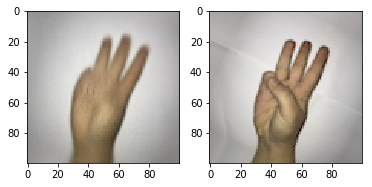

Epoch 42/100
100/100 [==============================] - 32s 324ms/step - loss: 233.0848
87.00765991210938 124.63716805468259 17.89238214959145 269.3428039550781 0.21203934 0.9274041483343809
Digit: 6.0. Predicted: 4. Believability: 0.593


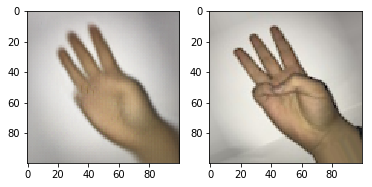

Epoch 43/100
100/100 [==============================] - 32s 322ms/step - loss: 234.1430
84.65391540527344 130.19060339409177 17.90579635449403 317.9130554199219 0.24287772 0.9154619736015085
Digit: 6.0. Predicted: 6. Believability: 0.353


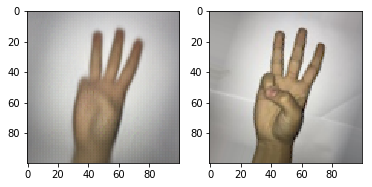

Epoch 44/100
100/100 [==============================] - 32s 323ms/step - loss: 234.3876
84.07880401611328 131.8619873507228 17.909973601508486 309.2318534851074 0.22823608 0.9230043997485858
Digit: 3.0. Predicted: 7. Believability: 0.017


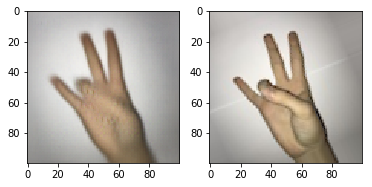

Epoch 45/100
100/100 [==============================] - 32s 322ms/step - loss: 232.1108
83.37863159179688 132.6254222972973 17.91101445631678 232.84063339233398 0.2217132 0.9274041483343809
Digit: 5.0. Predicted: 5. Believability: 0.018


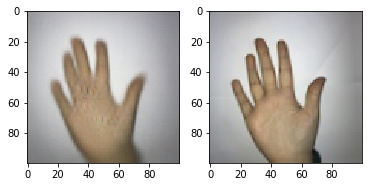

Epoch 46/100
100/100 [==============================] - 32s 324ms/step - loss: 232.5531
86.49469757080078 128.17313207102453 17.90095788812068 217.3806667327881 0.19759476 0.9327467001885607
Digit: 8.0. Predicted: 8. Believability: 0.019


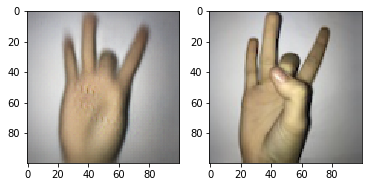

Epoch 47/100
100/100 [==============================] - 32s 322ms/step - loss: 235.2299
87.1915054321289 125.45437225015714 17.89542300439975 312.3180150985718 0.1986171 0.933375235700817
Digit: 6.0. Predicted: 6. Believability: 0.080


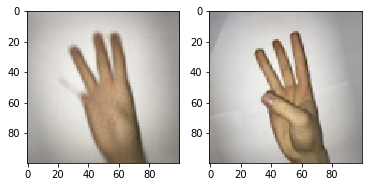

Epoch 48/100
100/100 [==============================] - 32s 323ms/step - loss: 233.0584
88.39279174804688 136.41608068824638 17.922739157762415 253.05535793304443 0.19507793 0.9305468258956631
Digit: 2.0. Predicted: 2. Believability: 0.304


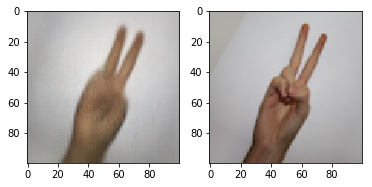

Epoch 49/100
100/100 [==============================] - 32s 324ms/step - loss: 233.5602
88.33609008789062 124.63377003456945 17.89289377749843 230.4394006729126 0.20854627 0.9248900062853551
Digit: 2.0. Predicted: 2. Believability: 0.014


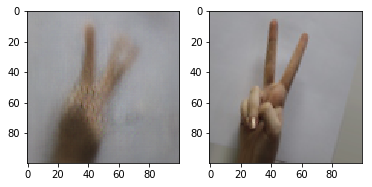

Epoch 50/100
100/100 [==============================] - 32s 322ms/step - loss: 231.6897
86.90087127685547 127.29038340666247 17.898629792583282 259.1594696044922 0.21921425 0.9245757385292269
Digit: 0.0. Predicted: 0. Believability: 0.003


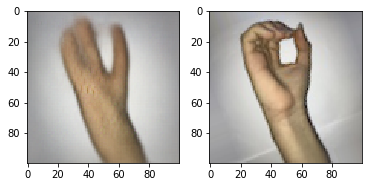

Epoch 51/100
100/100 [==============================] - 32s 324ms/step - loss: 231.3810
86.52361297607422 126.3842610779384 17.89629792583281 315.56761264801025 0.21954024 0.923318667504714
Digit: 8.0. Predicted: 8. Believability: 0.047


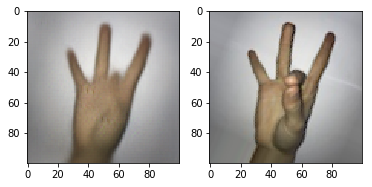

Epoch 52/100
100/100 [==============================] - 32s 322ms/step - loss: 231.8068
85.61553192138672 127.72398452231302 17.899868007542427 248.95877838134766 0.20757896 0.9264613450659962
Digit: 0.0. Predicted: 0. Believability: 0.053


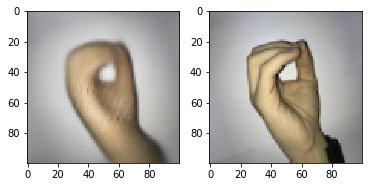

Epoch 53/100
100/100 [==============================] - 32s 324ms/step - loss: 232.3833
86.13327026367188 127.01990689817725 17.89836706473916 209.55448150634766 0.18322472 0.9340037712130735
Digit: 0.0. Predicted: 0. Believability: 0.902


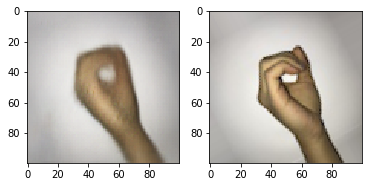

Epoch 54/100
100/100 [==============================] - 32s 322ms/step - loss: 231.9660
85.22726440429688 127.52020152419861 17.899226901319928 335.97075939178467 0.19998771 0.9327467001885607
Digit: 3.0. Predicted: 3. Believability: 0.014


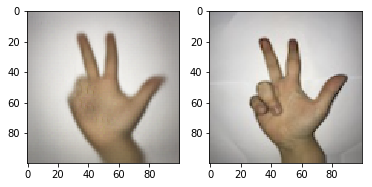

Epoch 55/100
100/100 [==============================] - 32s 324ms/step - loss: 232.0507
88.0027084350586 125.25251414204902 17.89392457573853 371.9841718673706 0.19107588 0.928975487115022
Digit: 6.0. Predicted: 6. Believability: 0.006


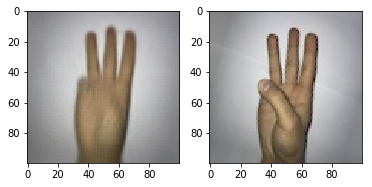

Epoch 56/100
100/100 [==============================] - 32s 322ms/step - loss: 233.4643
85.37522888183594 130.30109797297297 17.905243243243245 284.6545457839966 0.2079917 0.9270898805782527
Digit: 6.0. Predicted: 6. Believability: 0.289


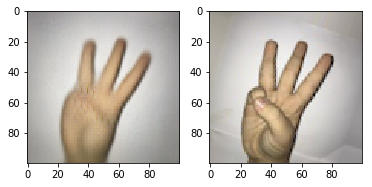

Epoch 57/100
100/100 [==============================] - 32s 324ms/step - loss: 231.4625
89.64551544189453 125.26079313324954 17.894351979886864 282.5498580932617 0.19703245 0.9314896291640478
Digit: 4.0. Predicted: 4. Believability: 0.092


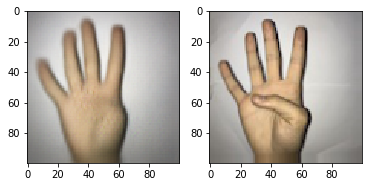

Epoch 58/100
100/100 [==============================] - 32s 322ms/step - loss: 231.7526
85.47042846679688 128.71082456002515 17.903571338780644 238.12849521636963 0.21026264 0.9258328095537398
Digit: 7.0. Predicted: 7. Believability: 0.231


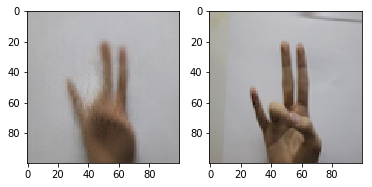

Epoch 59/100
100/100 [==============================] - 32s 323ms/step - loss: 232.0820
82.6220474243164 131.17859247328724 17.908148334380893 305.61683177948 0.20027983 0.931803896920176
Digit: 8.0. Predicted: 8. Believability: 0.058


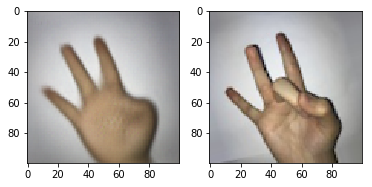

Epoch 60/100
100/100 [==============================] - 32s 322ms/step - loss: 231.1894
87.38002014160156 126.46217001885607 17.896233815210557 298.07915687561035 0.2038456 0.9321181646763043
Digit: 3.0. Predicted: 3. Believability: 0.033


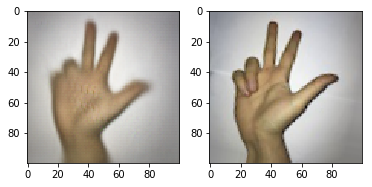

Epoch 61/100
100/100 [==============================] - 32s 323ms/step - loss: 232.3587
84.59326171875 130.98468926775612 17.90792206159648 327.26802825927734 0.19757923 0.9305468258956631
Digit: 5.0. Predicted: 5. Believability: 0.028


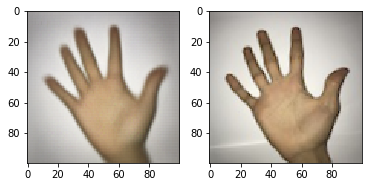

Epoch 62/100
100/100 [==============================] - 32s 324ms/step - loss: 233.2080
86.43600463867188 126.01303229101194 17.895890634820866 353.36596965789795 0.20522715 0.9274041483343809
Digit: 4.0. Predicted: 4. Believability: 0.001


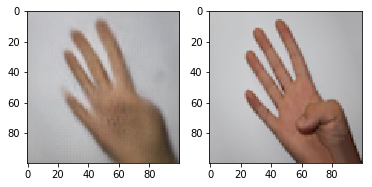

Epoch 63/100
100/100 [==============================] - 32s 322ms/step - loss: 231.4689
86.93412017822266 126.30661730043998 17.89620615964802 260.463285446167 0.21604241 0.9264613450659962
Digit: 4.0. Predicted: 4. Believability: 0.663


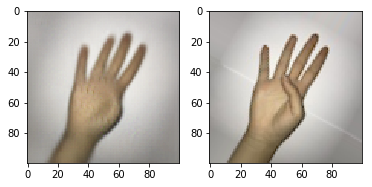

Epoch 64/100
100/100 [==============================] - 32s 323ms/step - loss: 231.2949
83.85498809814453 126.46740454116907 17.897115021998744 274.86846446990967 0.20628792 0.9340037712130735
Digit: 7.0. Predicted: 7. Believability: 0.163


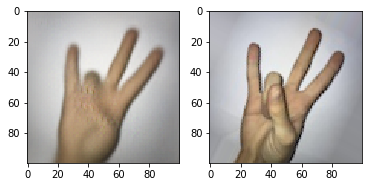

Epoch 65/100
100/100 [==============================] - 32s 323ms/step - loss: 230.6858
86.65662384033203 137.37468573224388 17.925089880578252 220.09687423706055 0.2173665 0.9220615964802011
Digit: 7.0. Predicted: 7. Believability: 0.045


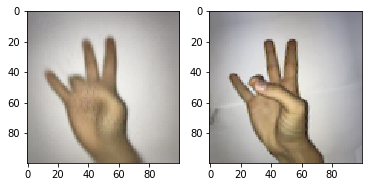

Epoch 66/100
100/100 [==============================] - 32s 323ms/step - loss: 231.2207
85.95398712158203 126.1584498742929 17.895886863607792 284.8980903625488 0.20177388 0.9302325581395349
Digit: 3.0. Predicted: 3. Believability: 0.026


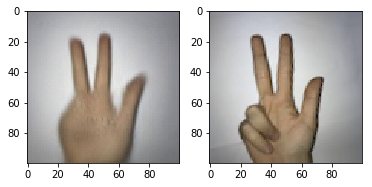

Epoch 67/100
100/100 [==============================] - 32s 323ms/step - loss: 232.9677
83.70783233642578 130.06917818981773 17.90522815839095 185.06479263305664 0.2211425 0.9211187932118164
Digit: 2.0. Predicted: 2. Believability: 0.402


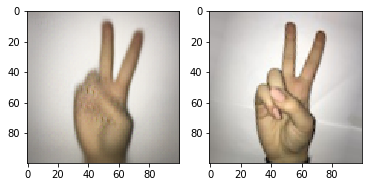

Epoch 68/100
100/100 [==============================] - 32s 323ms/step - loss: 232.0591
84.4363784790039 148.14998428661218 17.947620364550595 273.2133626937866 0.21843587 0.9248900062853551
Digit: 6.0. Predicted: 6. Believability: 0.082


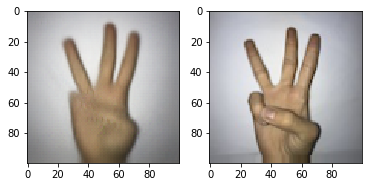

Epoch 69/100
100/100 [==============================] - 32s 323ms/step - loss: 231.5723
87.11914825439453 124.96009781583909 17.893645505971087 334.73284244537354 0.18024684 0.9390320553111251
Digit: 2.0. Predicted: 2. Believability: 0.057


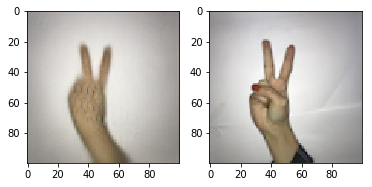

Epoch 70/100
100/100 [==============================] - 32s 323ms/step - loss: 229.5623
84.32787322998047 128.79877042740415 17.901661847894406 171.32554054260254 0.20610464 0.9230043997485858
Digit: 1.0. Predicted: 1. Believability: 0.593


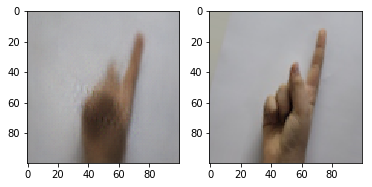

Epoch 71/100
100/100 [==============================] - 32s 322ms/step - loss: 231.0168
85.63623809814453 126.64359090194846 17.89718667504714 260.37399768829346 0.20205396 0.9324324324324325
Digit: 2.0. Predicted: 2. Believability: 0.178


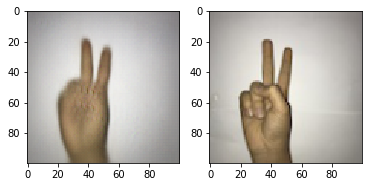

Epoch 72/100
100/100 [==============================] - 32s 324ms/step - loss: 230.7254
85.97405242919922 126.40318588937775 17.896789440603396 279.7961950302124 0.20780206 0.9267756128221244
Digit: 9.0. Predicted: 9. Believability: 0.001


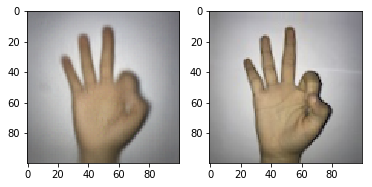

Epoch 73/100
100/100 [==============================] - 32s 322ms/step - loss: 231.4817
82.77643585205078 142.09765870521684 17.93586423632935 397.1740245819092 0.19726257 0.9311753614079196
Digit: 2.0. Predicted: 1. Believability: 0.031


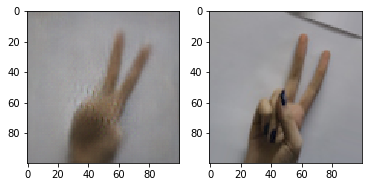

Epoch 74/100
100/100 [==============================] - 32s 323ms/step - loss: 229.7369
87.9333724975586 122.73693824638592 17.888170961659334 225.17311573028564 0.1860879 0.9368321810182275
Digit: 8.0. Predicted: 8. Believability: 0.261


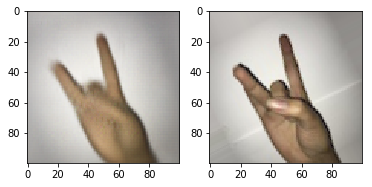

Epoch 75/100
100/100 [==============================] - 32s 324ms/step - loss: 232.0597
82.75833129882812 128.45023766499057 17.90153488372093 245.9047555923462 0.2175792 0.9270898805782527
Digit: 1.0. Predicted: 1. Believability: 0.074


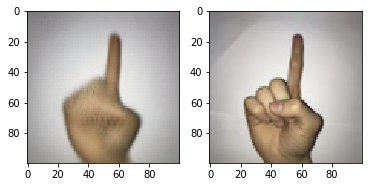

Epoch 76/100
100/100 [==============================] - 32s 322ms/step - loss: 231.6196
86.05073547363281 128.8102608422376 17.902465116279068 232.9709768295288 0.18492068 0.9340037712130735
Digit: 6.0. Predicted: 6. Believability: 0.810


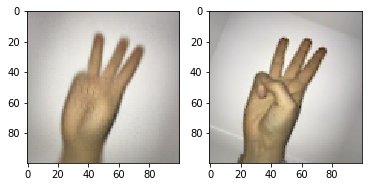

Epoch 77/100
100/100 [==============================] - 32s 324ms/step - loss: 231.6704
83.72183990478516 129.42208123821496 17.904736643620364 290.27626514434814 0.21798594 0.9245757385292269
Digit: 9.0. Predicted: 9. Believability: 0.151


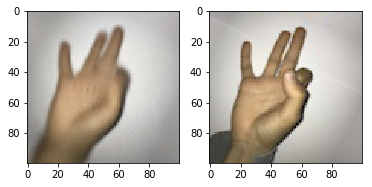

Epoch 78/100
100/100 [==============================] - 32s 322ms/step - loss: 230.3943
86.78876495361328 122.47400416404777 17.887976115650535 294.048547744751 0.19450246 0.9371464487743557
Digit: 0.0. Predicted: 0. Believability: 0.259


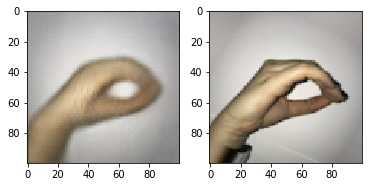

Epoch 79/100
100/100 [==============================] - 32s 324ms/step - loss: 230.2272
88.10820770263672 120.36910747957259 17.88310622250157 216.43052101135254 0.17720832 0.9368321810182275
Digit: 6.0. Predicted: 6. Believability: 0.462


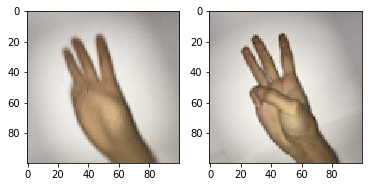

Epoch 80/100
100/100 [==============================] - 32s 322ms/step - loss: 231.2367
83.77653503417969 126.32607243871779 17.896255185417978 193.79371404647827 0.19908811 0.9286612193588938
Digit: 5.0. Predicted: 5. Believability: 0.031


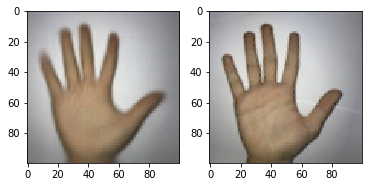

Epoch 81/100
100/100 [==============================] - 32s 323ms/step - loss: 229.3087
83.17621612548828 126.79732675989943 17.89737649277184 211.97924613952637 0.20696977 0.9308610936517914
Digit: 3.0. Predicted: 3. Believability: 0.021


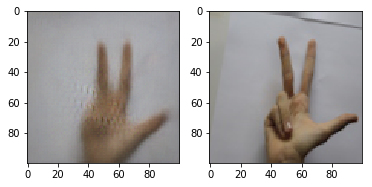

Epoch 82/100
100/100 [==============================] - 32s 322ms/step - loss: 230.3880
86.16400146484375 125.42961384349466 17.895517284726587 176.49418115615845 0.19959077 0.9308610936517914
Digit: 9.0. Predicted: 9. Believability: 0.358


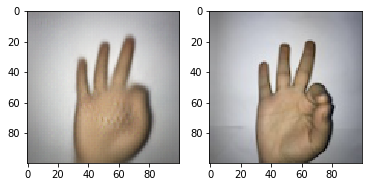

Epoch 83/100
100/100 [==============================] - 32s 323ms/step - loss: 231.5796
85.8250732421875 129.87858461659334 17.90421370207417 197.9625701904297 0.18578856 0.9365179132620993
Digit: 2.0. Predicted: 2. Believability: 0.173


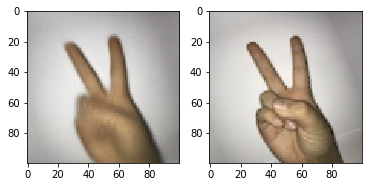

Epoch 84/100
100/100 [==============================] - 32s 322ms/step - loss: 231.5034
84.39492797851562 125.67900494971715 17.894812067881833 181.42905235290527 0.21591094 0.9292897548711502
Digit: 0.0. Predicted: 0. Believability: 0.714


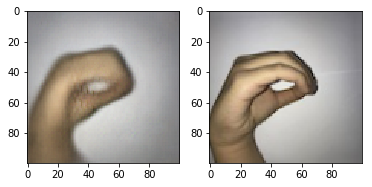

Epoch 85/100
100/100 [==============================] - 32s 324ms/step - loss: 228.9608
85.50464630126953 125.2225899591452 17.894098051539913 282.8361988067627 0.1964381 0.9321181646763043
Digit: 1.0. Predicted: 1. Believability: 0.096


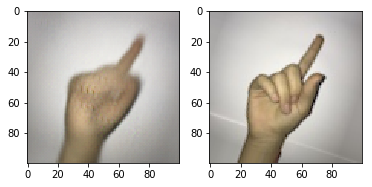

Epoch 86/100
100/100 [==============================] - 32s 322ms/step - loss: 229.5725
87.84893798828125 132.51401437774985 17.91274041483344 111.94820404052734 0.16096434 0.9450031426775612
Digit: 6.0. Predicted: 6. Believability: 0.576


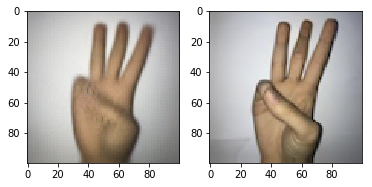

Epoch 87/100
100/100 [==============================] - 32s 322ms/step - loss: 231.2432
84.61747741699219 132.72153912633564 17.912670018856065 176.18591785430908 0.21574098 0.9267756128221244
Digit: 6.0. Predicted: 2. Believability: 0.073


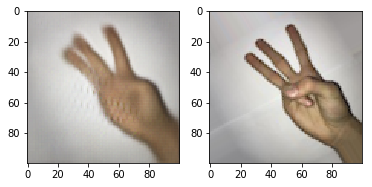

Epoch 88/100
100/100 [==============================] - 32s 323ms/step - loss: 231.1721
85.02361297607422 124.4677679132621 17.892015084852293 254.75590229034424 0.19730775 0.937460716530484
Digit: 9.0. Predicted: 9. Believability: 0.062


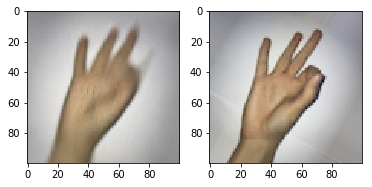

Epoch 89/100
100/100 [==============================] - 32s 323ms/step - loss: 229.0802
86.20250701904297 126.34035197988686 17.897121307353864 329.3886184692383 0.19973214 0.9340037712130735
Digit: 4.0. Predicted: 4. Believability: 0.037


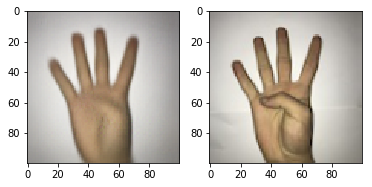

Epoch 90/100
100/100 [==============================] - 32s 324ms/step - loss: 229.5260
84.99342346191406 127.90337248585796 17.90203142677561 170.4362392425537 0.20199078 0.931803896920176
Digit: 3.0. Predicted: 3. Believability: 0.404


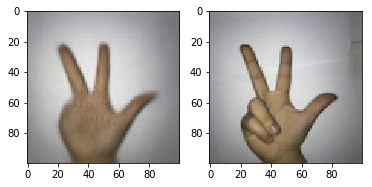

Epoch 91/100
100/100 [==============================] - 32s 323ms/step - loss: 231.3209
85.91141510009766 125.20227058453803 17.89354116907605 189.69167470932007 0.19645199 0.9299182903834067
Digit: 9.0. Predicted: 9. Believability: 0.017


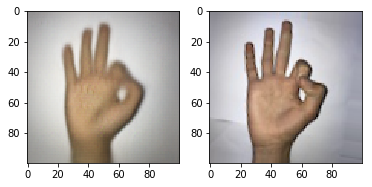

Epoch 92/100
100/100 [==============================] - 32s 324ms/step - loss: 229.4444
86.3885726928711 124.88525298554369 17.89335135135135 328.0494689941406 0.18725626 0.931803896920176
Digit: 2.0. Predicted: 2. Believability: 0.004


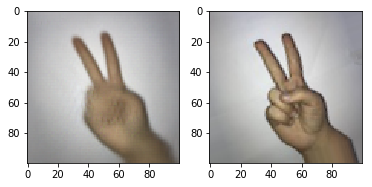

Epoch 93/100
100/100 [==============================] - 32s 322ms/step - loss: 230.6538
87.46284484863281 125.83330059710873 17.896538026398492 192.15797185897827 0.19374093 0.9305468258956631
Digit: 4.0. Predicted: 4. Believability: 0.244


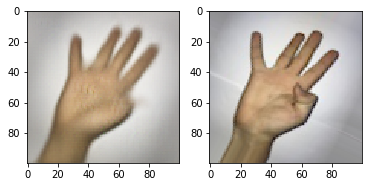

Epoch 94/100
100/100 [==============================] - 32s 324ms/step - loss: 229.1145
86.93600463867188 121.37919351037084 17.884951602765558 226.27549171447754 0.18599084 0.933375235700817
Digit: 6.0. Predicted: 6. Believability: 0.103


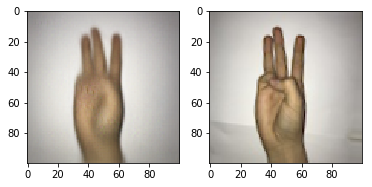

Epoch 95/100
100/100 [==============================] - 32s 322ms/step - loss: 229.9810
88.08380889892578 120.22606654619736 17.882881206788184 257.5155735015869 0.18174067 0.9349465744814582
Digit: 8.0. Predicted: 8. Believability: 0.100


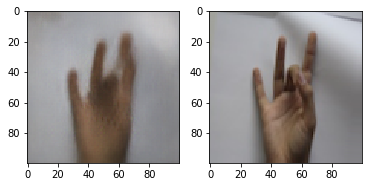

Epoch 96/100
100/100 [==============================] - 32s 323ms/step - loss: 229.6721
86.401611328125 128.52103629792583 17.901891891891893 334.4041585922241 0.2005227 0.9377749842866122
Digit: 6.0. Predicted: 4. Believability: 0.092


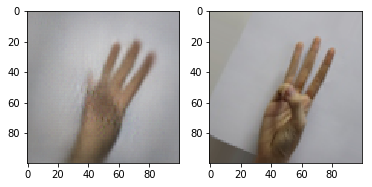

Epoch 97/100
100/100 [==============================] - 32s 323ms/step - loss: 228.4875
85.34266662597656 126.87058060967945 17.89942300439975 183.02607536315918 0.20184186 0.9299182903834067
Digit: 3.0. Predicted: 3. Believability: 0.245


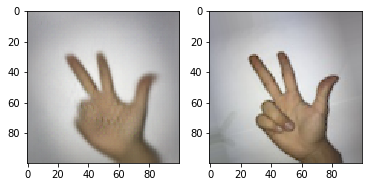

Epoch 98/100
100/100 [==============================] - 32s 324ms/step - loss: 228.4957
86.92832946777344 121.9410060496543 17.88627278441232 306.0335636138916 0.18454874 0.9330609679446888
Digit: 8.0. Predicted: 8. Believability: 0.001


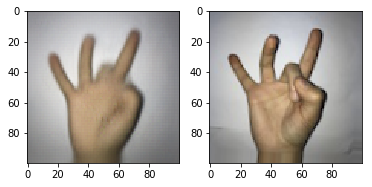

Epoch 99/100
100/100 [==============================] - 32s 323ms/step - loss: 229.7459
86.28172302246094 129.01895427404148 17.902908862350724 278.6202669143677 0.20012566 0.9283469516027656
Digit: 0.0. Predicted: 0. Believability: 0.013


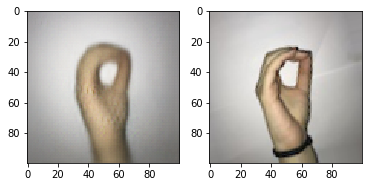

Epoch 100/100
100/100 [==============================] - 32s 322ms/step - loss: 229.0166
87.4295654296875 124.03323381521056 17.89294154619736 209.78882312774658 0.20302033 0.9308610936517914
Digit: 1.0. Predicted: 1. Believability: 0.210


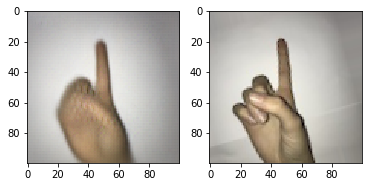

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=100)

 --- Forgerer --- 
Epoch 1/100
100/100 [==============================] - 32s 318ms/step - loss: 228.9158
85.8238525390625 134.094682982401 17.91668258956631 252.68750190734863 0.19809029 0.9311753614079196
Digit: 3.0. Predicted: 3. Believability: 0.111


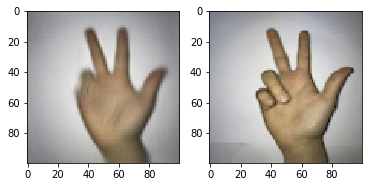

Epoch 2/100
100/100 [==============================] - 32s 325ms/step - loss: 229.9644
87.2544174194336 122.62997917976115 17.88789943431804 264.97135162353516 0.18622091 0.9299182903834067
Digit: 0.0. Predicted: 0. Believability: 0.412


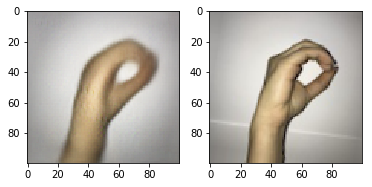

Epoch 3/100
100/100 [==============================] - 32s 324ms/step - loss: 228.2128
87.37635803222656 122.71648137963545 17.887979886863608 158.69243144989014 0.20379727 0.9292897548711502
Digit: 3.0. Predicted: 3. Believability: 0.911


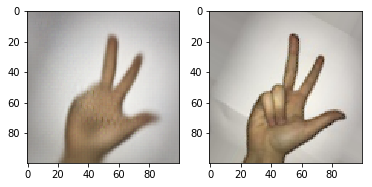

Epoch 4/100
100/100 [==============================] - 32s 322ms/step - loss: 228.2634
87.5852279663086 121.10010410119422 17.884510370835955 202.94172763824463 0.18280873 0.9358893777498428
Digit: 3.0. Predicted: 3. Believability: 0.097


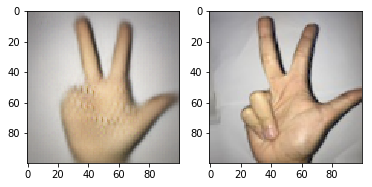

Epoch 5/100
100/100 [==============================] - 32s 324ms/step - loss: 228.6522
85.61981201171875 123.16861447203017 17.889199245757386 224.89163875579834 0.1762831 0.9421747328724073
Digit: 3.0. Predicted: 3. Believability: 0.131


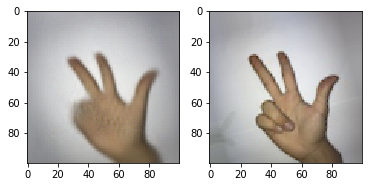

Epoch 6/100
100/100 [==============================] - 32s 323ms/step - loss: 228.5911
85.34822082519531 124.3753731929604 17.892686360779386 271.7154026031494 0.1927681 0.9302325581395349
Digit: 9.0. Predicted: 9. Believability: 0.011


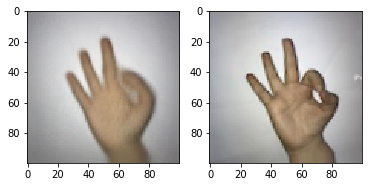

Epoch 7/100
100/100 [==============================] - 32s 324ms/step - loss: 228.2007
87.37193298339844 124.99871346637335 17.893630421118793 239.5268678665161 0.17700015 0.9415461973601509
Digit: 2.0. Predicted: 2. Believability: 0.059


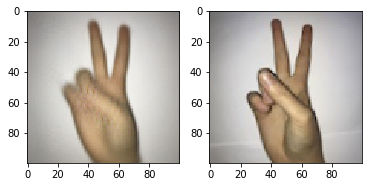

Epoch 8/100
100/100 [==============================] - 32s 323ms/step - loss: 228.7449
88.2538070678711 124.16119971715902 17.89134506599623 313.45837116241455 0.17563368 0.9377749842866122
Digit: 8.0. Predicted: 9. Believability: 0.024


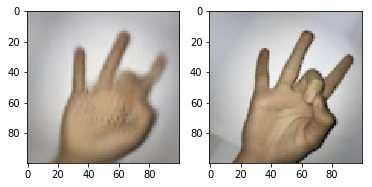

Epoch 9/100
100/100 [==============================] - 32s 324ms/step - loss: 229.1367
85.42758178710938 126.69439424890007 17.898251414204903 310.72683334350586 0.21069969 0.9296040226272785
Digit: 3.0. Predicted: 3. Believability: 0.019


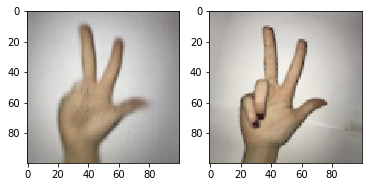

Epoch 10/100
100/100 [==============================] - 32s 323ms/step - loss: 228.4221
85.49552154541016 124.3333202388435 17.891769956002513 201.50933265686035 0.20256051 0.9362036455059711
Digit: 0.0. Predicted: 0. Believability: 0.053


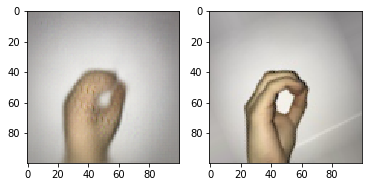

Epoch 11/100
100/100 [==============================] - 32s 323ms/step - loss: 229.5446
84.69258880615234 126.43794193903206 17.897435575109995 252.21095085144043 0.21040314 0.9280326838466373
Digit: 6.0. Predicted: 6. Believability: 0.047


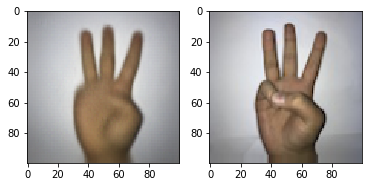

Epoch 12/100
100/100 [==============================] - 32s 323ms/step - loss: 227.6559
83.79964447021484 125.77484679446889 17.89551854179761 235.57164669036865 0.19940299 0.9314896291640478
Digit: 8.0. Predicted: 8. Believability: 0.053


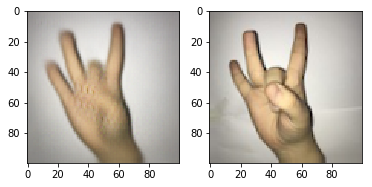

Epoch 13/100
100/100 [==============================] - 32s 322ms/step - loss: 228.8785
85.52384185791016 124.52885370835952 17.892164676304212 273.4633207321167 0.17872387 0.9387177875549969
Digit: 8.0. Predicted: 8. Believability: 0.179


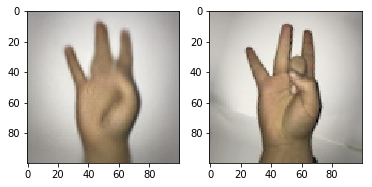

Epoch 14/100
100/100 [==============================] - 32s 324ms/step - loss: 227.8954
83.75587463378906 125.690868557511 17.895488372093023 236.96532249450684 0.19646883 0.9371464487743557
Digit: 8.0. Predicted: 8. Believability: 0.209


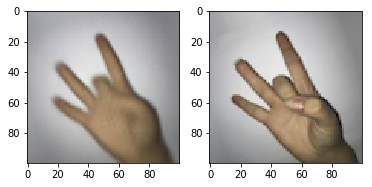

Epoch 15/100
100/100 [==============================] - 32s 322ms/step - loss: 228.0433
87.13439178466797 119.64294272470144 17.881148962916406 279.683256149292 0.18515724 0.9393463230672533
Digit: 8.0. Predicted: 8. Believability: 0.012


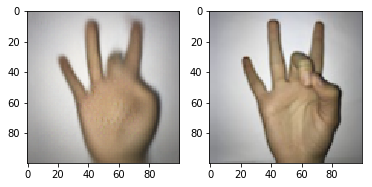

Epoch 16/100
100/100 [==============================] - 32s 324ms/step - loss: 228.2824
86.91944885253906 120.30136313639221 17.88249025769956 271.0402011871338 0.18263516 0.9380892520427404
Digit: 0.0. Predicted: 0. Believability: 0.015


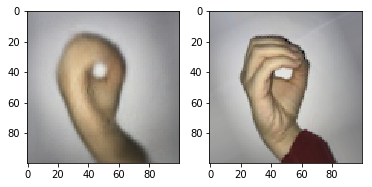

Epoch 17/100
100/100 [==============================] - 32s 323ms/step - loss: 229.2267
86.77796936035156 122.9168663576367 17.888954116907605 177.17738151550293 0.18638389 0.9340037712130735
Digit: 4.0. Predicted: 4. Believability: 0.086


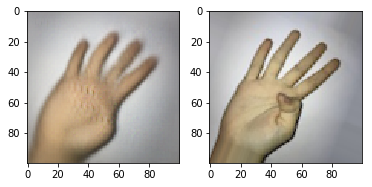

Epoch 18/100
100/100 [==============================] - 32s 325ms/step - loss: 228.6969
87.79810333251953 118.25200345694532 17.87789943431804 259.2721939086914 0.18480699 0.940289126335638
Digit: 4.0. Predicted: 4. Believability: 0.105


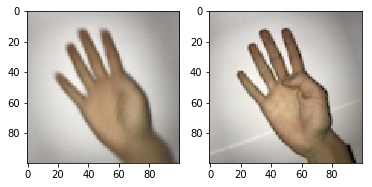

Epoch 19/100
100/100 [==============================] - 32s 323ms/step - loss: 228.5084
85.57295227050781 121.72100879949717 17.88562413576367 256.3600540161133 0.18965912 0.9418604651162791
Digit: 1.0. Predicted: 1. Believability: 0.426


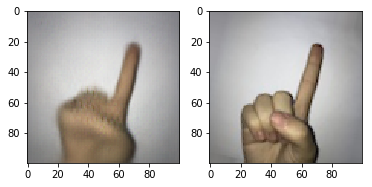

Epoch 20/100
100/100 [==============================] - 32s 324ms/step - loss: 228.1587
84.97053527832031 124.31067331866751 17.89146197360151 182.93867111206055 0.18826081 0.9377749842866122
Digit: 4.0. Predicted: 4. Believability: 0.281


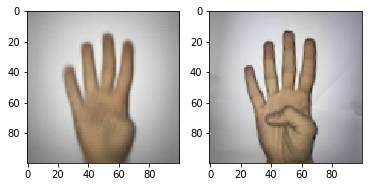

Epoch 21/100
100/100 [==============================] - 32s 323ms/step - loss: 228.4480
86.53606414794922 126.02791090509113 17.895365179132618 165.2395725250244 0.17776282 0.9424890006285355
Digit: 3.0. Predicted: 3. Believability: 0.004


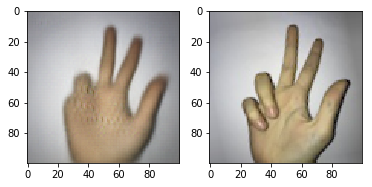

Epoch 22/100
100/100 [==============================] - 32s 322ms/step - loss: 228.4330
88.09447479248047 124.82054329038341 17.89332746700189 194.22576427459717 0.18014081 0.9418604651162791
Digit: 4.0. Predicted: 5. Believability: 0.542


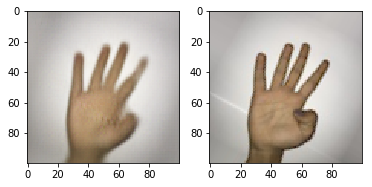

Epoch 23/100
100/100 [==============================] - 32s 324ms/step - loss: 227.8411
82.86515045166016 123.6203645505971 17.890778126964175 232.7819585800171 0.19660898 0.9299182903834067
Digit: 8.0. Predicted: 8. Believability: 0.164


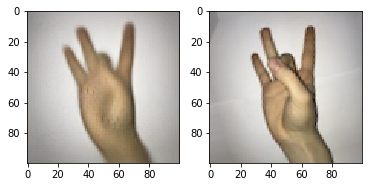

Epoch 24/100
100/100 [==============================] - 32s 322ms/step - loss: 227.4132
86.26775360107422 123.34897470144563 17.88966561910748 227.9033660888672 0.18522002 0.9349465744814582
Digit: 2.0. Predicted: 2. Believability: 0.005


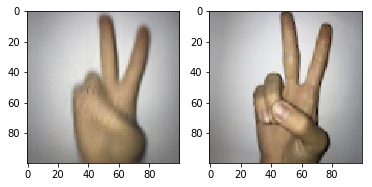

Epoch 25/100
100/100 [==============================] - 33s 325ms/step - loss: 227.0077
84.2989273071289 132.70806489629163 17.911855436832184 205.85143566131592 0.19920608 0.9296040226272785
Digit: 8.0. Predicted: 8. Believability: 0.207


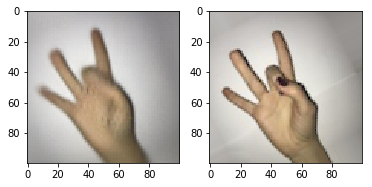

Epoch 26/100
100/100 [==============================] - 32s 322ms/step - loss: 228.4479
86.36881256103516 120.73976665619108 17.883578881206788 226.1359691619873 0.17587896 0.9428032683846638
Digit: 3.0. Predicted: 3. Believability: 0.020


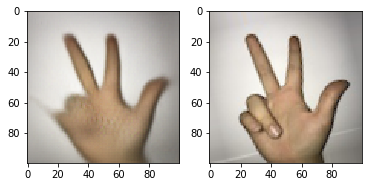

Epoch 27/100
100/100 [==============================] - 32s 324ms/step - loss: 228.3195
85.86235809326172 122.3524512884978 17.88760150848523 218.14990043640137 0.16076916 0.9462602137020741
Digit: 9.0. Predicted: 9. Believability: 0.059


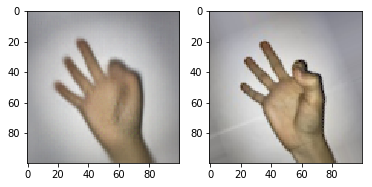

Epoch 28/100
100/100 [==============================] - 32s 323ms/step - loss: 227.3866
84.9002914428711 124.77094791011942 17.893240729101194 281.9334030151367 0.18539329 0.9390320553111251
Digit: 9.0. Predicted: 9. Believability: 0.270


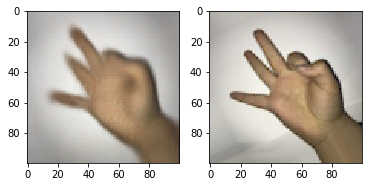

Epoch 29/100
100/100 [==============================] - 32s 324ms/step - loss: 226.1537
86.02922821044922 122.01808021684475 17.88668761785041 227.1512746810913 0.18701434 0.9346323067253299
Digit: 4.0. Predicted: 4. Believability: 0.119


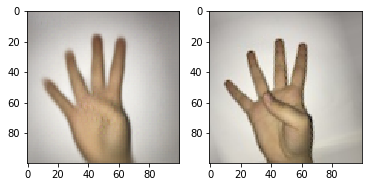

Epoch 30/100
100/100 [==============================] - 32s 323ms/step - loss: 227.7604
87.28201293945312 122.52599583595223 17.888329352608423 236.44542694091797 0.16401006 0.9465744814582024
Digit: 4.0. Predicted: 4. Believability: 0.086


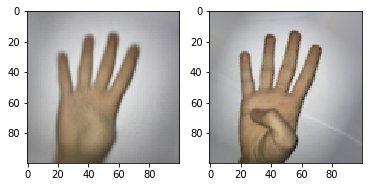

Epoch 31/100
100/100 [==============================] - 32s 324ms/step - loss: 227.6853
84.87858581542969 122.4244480672533 17.887532369578885 201.09503269195557 0.19354247 0.9321181646763043
Digit: 2.0. Predicted: 2. Believability: 0.094


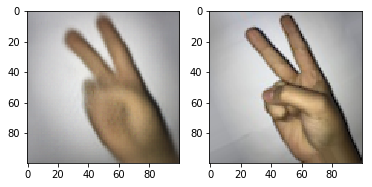

Epoch 32/100
100/100 [==============================] - 32s 322ms/step - loss: 227.6992
86.6651840209961 124.16591373350094 17.89301068510371 197.47061729431152 0.1617424 0.9450031426775612
Digit: 9.0. Predicted: 9. Believability: 0.623


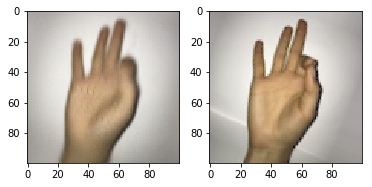

Epoch 33/100
100/100 [==============================] - 32s 324ms/step - loss: 227.1330
87.41316223144531 121.69499332181019 17.88586926461345 177.4996280670166 0.15462714 0.9478315524827152
Digit: 8.0. Predicted: 8. Believability: 0.238


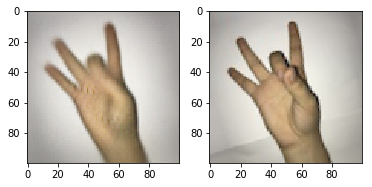

Epoch 34/100
100/100 [==============================] - 32s 323ms/step - loss: 226.7022
84.77454376220703 121.98644720301697 17.88647642991829 253.41777801513672 0.19141665 0.9296040226272785
Digit: 5.0. Predicted: 5. Believability: 0.061


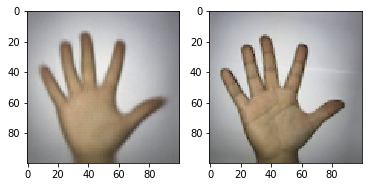

Epoch 35/100
100/100 [==============================] - 32s 322ms/step - loss: 227.0260
84.50279235839844 127.15663301382779 17.897820238843494 298.5119342803955 0.191985 0.9346323067253299
Digit: 2.0. Predicted: 2. Believability: 0.075


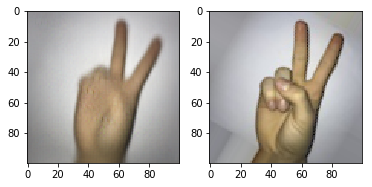

Epoch 36/100
100/100 [==============================] - 32s 324ms/step - loss: 227.0157
84.54798126220703 121.62063953488372 17.885488372093022 230.15100955963135 0.17437884 0.9437460716530484
Digit: 3.0. Predicted: 3. Believability: 0.006


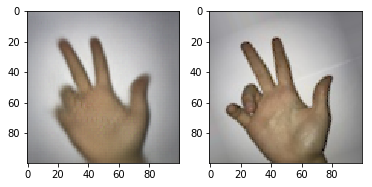

Epoch 37/100
100/100 [==============================] - 32s 322ms/step - loss: 227.0536
84.98544311523438 129.38770820238844 17.903786297925834 213.71653079986572 0.19694497 0.9324324324324325
Digit: 7.0. Predicted: 7. Believability: 0.028


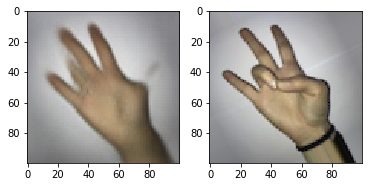

Epoch 38/100
100/100 [==============================] - 32s 324ms/step - loss: 227.1730
86.64588165283203 122.74014967001885 17.88807793840352 208.95390510559082 0.1945883 0.9302325581395349
Digit: 5.0. Predicted: 5. Believability: 0.192


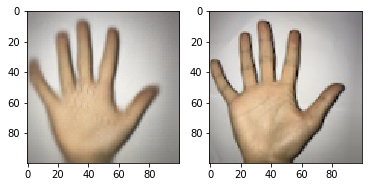

Epoch 39/100
100/100 [==============================] - 32s 323ms/step - loss: 227.2234
85.77400207519531 120.35499489314897 17.88304965430547 207.99059867858887 0.1907497 0.9330609679446888
Digit: 1.0. Predicted: 1. Believability: 0.377


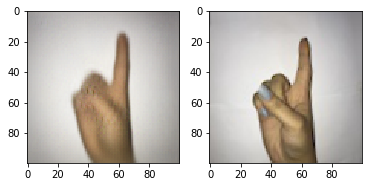

Epoch 40/100
100/100 [==============================] - 32s 324ms/step - loss: 226.9251
85.36734008789062 121.69464959145192 17.88573978629793 255.0947666168213 0.17244196 0.9459459459459459
Digit: 3.0. Predicted: 3. Believability: 0.052


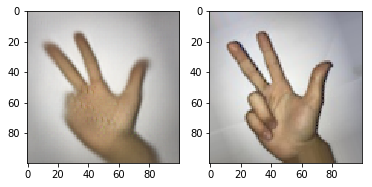

Epoch 41/100
100/100 [==============================] - 32s 324ms/step - loss: 227.5353
88.18832397460938 124.37244657448146 17.892307982401007 203.32705974578857 0.18063621 0.940289126335638
Digit: 3.0. Predicted: 3. Believability: 0.018


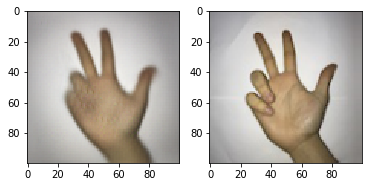

Epoch 42/100
100/100 [==============================] - 32s 324ms/step - loss: 227.9390
86.2990951538086 119.2478001257071 17.880137020741675 199.48196411132812 0.18668608 0.937460716530484
Digit: 0.0. Predicted: 0. Believability: 0.009


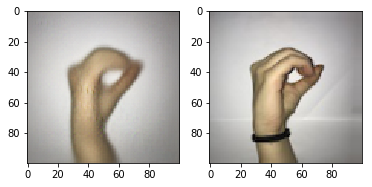

Epoch 43/100
100/100 [==============================] - 32s 323ms/step - loss: 227.0511
85.95828247070312 123.80554682589566 17.89188309239472 143.86062622070312 0.16857812 0.943117536140792
Digit: 0.0. Predicted: 0. Believability: 0.877


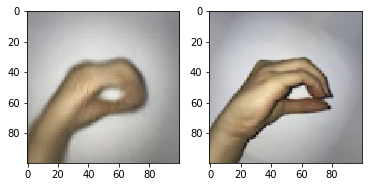

Epoch 44/100
100/100 [==============================] - 32s 324ms/step - loss: 226.3718
85.02075958251953 123.603855672533 17.890873664362037 251.22525691986084 0.16311237 0.9412319296040226
Digit: 2.0. Predicted: 2. Believability: 0.098


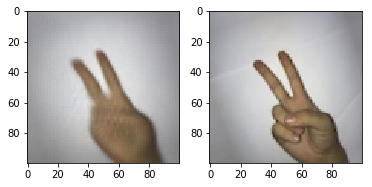

Epoch 45/100
100/100 [==============================] - 32s 323ms/step - loss: 227.2282
84.2472915649414 127.07694649591451 17.8994820867379 307.7856779098511 0.21060155 0.9252042740414833
Digit: 9.0. Predicted: 9. Believability: 0.036


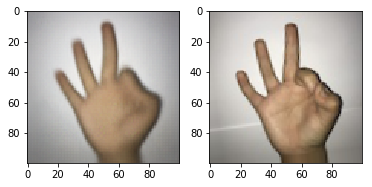

Epoch 46/100
100/100 [==============================] - 32s 324ms/step - loss: 226.5163
86.11908721923828 122.43161730043998 17.887751099937148 243.27600002288818 0.17209181 0.9387177875549969
Digit: 1.0. Predicted: 1. Believability: 0.010


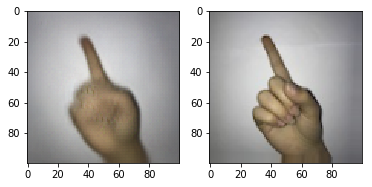

Epoch 47/100
100/100 [==============================] - 32s 323ms/step - loss: 226.7733
84.18621063232422 122.49371464487743 17.887649277184163 218.93444061279297 0.19143003 0.9336895034569453
Digit: 1.0. Predicted: 1. Believability: 0.188


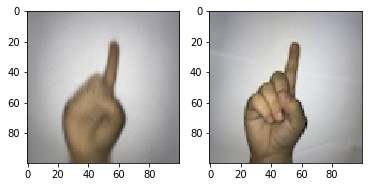

Epoch 48/100
100/100 [==============================] - 32s 323ms/step - loss: 226.5344
85.2367935180664 123.17882817410434 17.88921684475173 220.67558765411377 0.20228805 0.9305468258956631
Digit: 3.0. Predicted: 3. Believability: 0.225


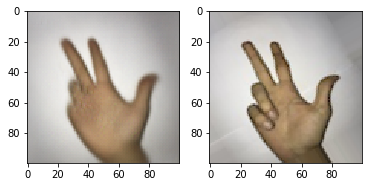

Epoch 49/100
100/100 [==============================] - 32s 324ms/step - loss: 226.6189
89.967041015625 144.15515988372093 17.94906348208674 169.9199914932251 0.19027948 0.9365179132620993
Digit: 5.0. Predicted: 5. Believability: 0.074


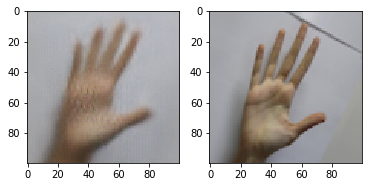

Epoch 50/100
100/100 [==============================] - 32s 323ms/step - loss: 226.6911
85.84703063964844 120.78173122250158 17.88378629792583 288.88099193573 0.19627383 0.9311753614079196
Digit: 9.0. Predicted: 9. Believability: 0.053


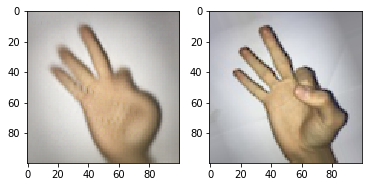

Epoch 51/100
100/100 [==============================] - 32s 324ms/step - loss: 228.1175
85.68080139160156 122.46117811125079 17.887637963544943 222.63176441192627 0.1725283 0.9387177875549969
Digit: 3.0. Predicted: 3. Believability: 0.700


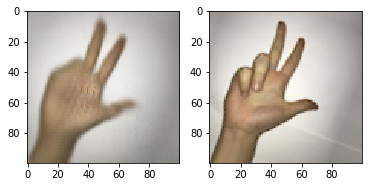

Epoch 52/100
100/100 [==============================] - 32s 322ms/step - loss: 226.8531
85.02143096923828 127.08515674104336 17.898536769327468 218.29512119293213 0.18647364 0.9412319296040226
Digit: 8.0. Predicted: 7. Believability: 0.062


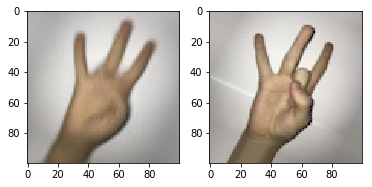

Epoch 53/100
100/100 [==============================] - 32s 324ms/step - loss: 226.5143
84.53189086914062 121.92701131363923 17.886375864236328 226.05774402618408 0.19250953 0.9343180389692017
Digit: 1.0. Predicted: 1. Believability: 0.287


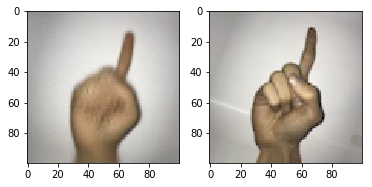

Epoch 54/100
100/100 [==============================] - 32s 321ms/step - loss: 225.8739
85.84037780761719 126.3045942017599 17.89655939660591 203.75041961669922 0.19173945 0.9308610936517914
Digit: 4.0. Predicted: 4. Believability: 0.144


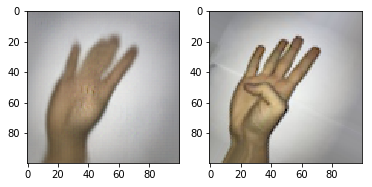

Epoch 55/100
100/100 [==============================] - 32s 323ms/step - loss: 226.1493
86.90032196044922 122.23144838152106 17.88743180389692 213.69893550872803 0.18190768 0.9371464487743557
Digit: 9.0. Predicted: 9. Believability: 0.309


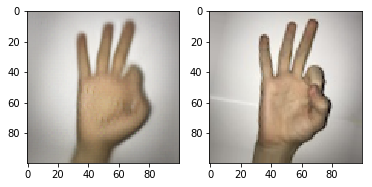

Epoch 56/100
100/100 [==============================] - 32s 322ms/step - loss: 225.7204
83.13654327392578 123.66599230043998 17.89034820867379 210.73548793792725 0.19536988 0.9330609679446888
Digit: 1.0. Predicted: 1. Believability: 0.320


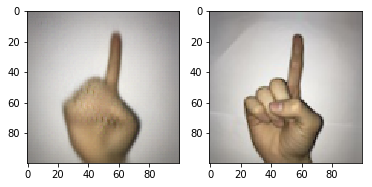

Epoch 57/100
100/100 [==============================] - 32s 323ms/step - loss: 226.4666
86.84355163574219 119.43737232872407 17.881112507856695 239.5726442337036 0.164206 0.9443746071653049
Digit: 3.0. Predicted: 3. Believability: 0.105


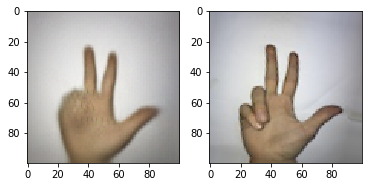

Epoch 58/100
100/100 [==============================] - 32s 322ms/step - loss: 226.5639
84.49693298339844 127.71002906976744 17.89921684475173 321.3693857192993 0.17337357 0.9377749842866122
Digit: 2.0. Predicted: 2. Believability: 0.034


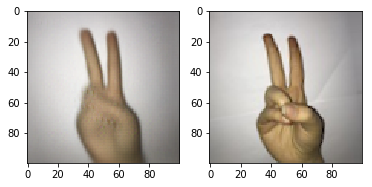

Epoch 59/100
100/100 [==============================] - 32s 323ms/step - loss: 226.5728
82.85890197753906 121.95343926775612 17.88643746071653 173.265540599823 0.19754902 0.937460716530484
Digit: 5.0. Predicted: 5. Believability: 0.433


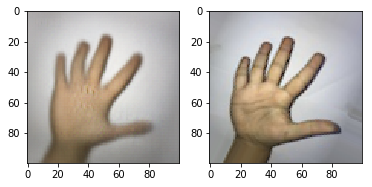

Epoch 60/100
100/100 [==============================] - 32s 321ms/step - loss: 227.4201
85.09298706054688 121.9668349308611 17.88617473287241 230.1539182662964 0.17907628 0.9358893777498428
Digit: 5.0. Predicted: 5. Believability: 0.724


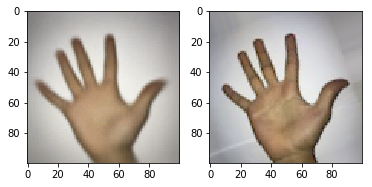

Epoch 61/100
100/100 [==============================] - 32s 321ms/step - loss: 225.3896
80.83379364013672 125.77318706788184 17.895469516027656 186.5149974822998 0.17788537 0.9390320553111251
Digit: 5.0. Predicted: 5. Believability: 0.004


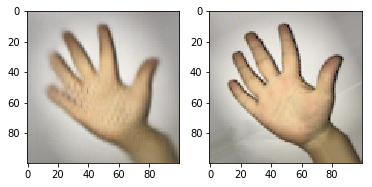

Epoch 62/100
100/100 [==============================] - 32s 324ms/step - loss: 227.4377
86.37274169921875 122.6303327309868 17.88835323695789 289.9034023284912 0.18140028 0.940289126335638
Digit: 3.0. Predicted: 3. Believability: 0.035


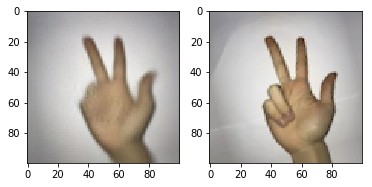

Epoch 63/100
100/100 [==============================] - 32s 321ms/step - loss: 225.3727
87.08318328857422 120.1999430389692 17.882470144563168 223.9506483078003 0.17129461 0.9406033940917662
Digit: 1.0. Predicted: 1. Believability: 0.034


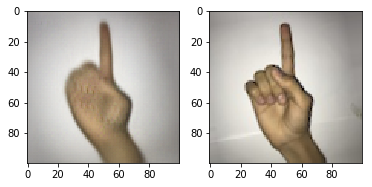

Epoch 64/100
100/100 [==============================] - 32s 324ms/step - loss: 225.3978
85.60623931884766 119.42396684475173 17.88037712130735 261.07099056243896 0.15511107 0.9465744814582024
Digit: 4.0. Predicted: 4. Believability: 0.037


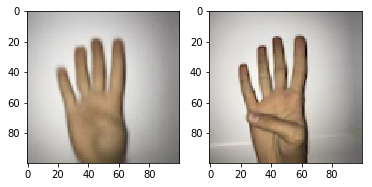

Epoch 65/100
100/100 [==============================] - 32s 322ms/step - loss: 227.1816
83.74108123779297 123.38565564110623 17.889714644877436 187.48505115509033 0.19135211 0.9384035197988686
Digit: 6.0. Predicted: 6. Believability: 0.225


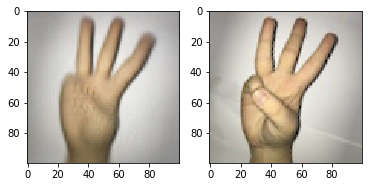

Epoch 66/100
100/100 [==============================] - 32s 322ms/step - loss: 225.9500
85.6150131225586 123.02813678504086 17.890314267756132 268.0365562438965 0.17416677 0.9409176618478944
Digit: 3.0. Predicted: 3. Believability: 0.031


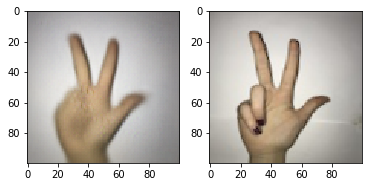

Epoch 67/100
100/100 [==============================] - 32s 322ms/step - loss: 225.3193
83.67933654785156 125.15155562539283 17.89395851665619 205.09569644927979 0.21213469 0.9236329352608422
Digit: 8.0. Predicted: 8. Believability: 0.015


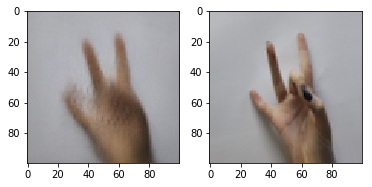

Epoch 68/100
100/100 [==============================] - 32s 324ms/step - loss: 226.7916
86.45576477050781 128.2453154462602 17.902394720301697 169.30655241012573 0.16549289 0.9412319296040226
Digit: 0.0. Predicted: 0. Believability: 0.882


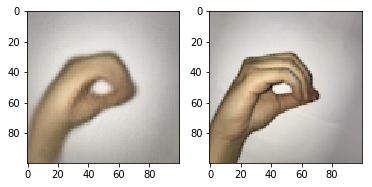

Epoch 69/100
100/100 [==============================] - 32s 322ms/step - loss: 226.3056
86.82891845703125 120.44960912947832 17.883195474544312 195.62171697616577 0.1917013 0.9324324324324325
Digit: 2.0. Predicted: 2. Believability: 0.854


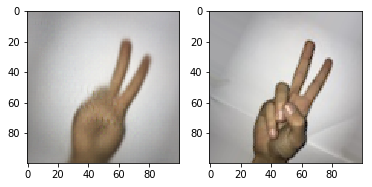

Epoch 70/100
100/100 [==============================] - 32s 322ms/step - loss: 225.3354
84.47698211669922 120.76508485229415 17.88355751099937 232.13257789611816 0.17791608 0.9368321810182275
Digit: 8.0. Predicted: 1. Believability: 0.061


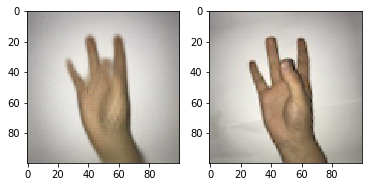

Epoch 71/100
100/100 [==============================] - 32s 322ms/step - loss: 225.5921
85.95650482177734 120.95544272470144 17.884079195474545 139.87112045288086 0.19357605 0.9349465744814582
Digit: 5.0. Predicted: 5. Believability: 0.114


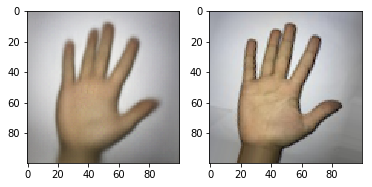

Epoch 72/100
100/100 [==============================] - 32s 323ms/step - loss: 224.8772
83.85899353027344 123.27651634192331 17.889720930232556 199.81070756912231 0.19687629 0.933375235700817
Digit: 0.0. Predicted: 0. Believability: 0.054


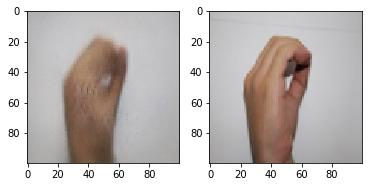

Epoch 73/100
100/100 [==============================] - 32s 322ms/step - loss: 224.5487
83.52809143066406 124.94513081395348 17.893443117536144 223.3217716217041 0.17231178 0.9409176618478944
Digit: 5.0. Predicted: 5. Believability: 0.057


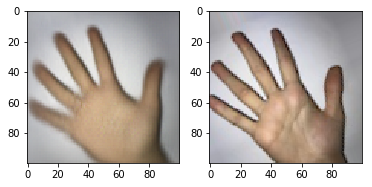

Epoch 74/100
100/100 [==============================] - 32s 322ms/step - loss: 226.8543
84.99165344238281 124.18454391891892 17.8912922690132 278.76508235931396 0.17503686 0.9393463230672533
Digit: 2.0. Predicted: 2. Believability: 0.133


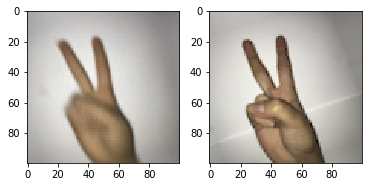

Epoch 75/100
100/100 [==============================] - 32s 323ms/step - loss: 225.3820
85.99378204345703 125.95456866750472 17.896321810182275 263.34853172302246 0.18011169 0.9396605908233815
Digit: 8.0. Predicted: 8. Believability: 0.024


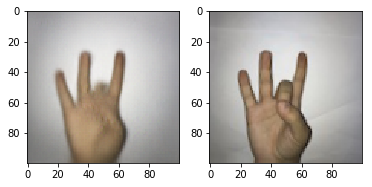

Epoch 76/100
100/100 [==============================] - 32s 322ms/step - loss: 226.6010
87.21526336669922 119.70780955373979 17.88121433060968 167.90592670440674 0.1697061 0.937460716530484
Digit: 9.0. Predicted: 9. Believability: 0.109


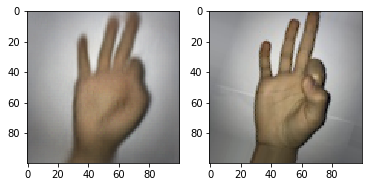

Epoch 77/100
100/100 [==============================] - 32s 322ms/step - loss: 225.5012
86.22859191894531 132.3472167661848 17.916067881835325 175.17470121383667 0.17943533 0.9352608422375864
Digit: 9.0. Predicted: 9. Believability: 0.011


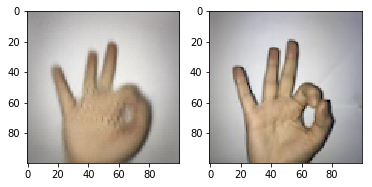

Epoch 78/100
100/100 [==============================] - 32s 322ms/step - loss: 225.0101
85.3128433227539 122.1530680389692 17.88802765556254 188.14667463302612 0.18473199 0.9358893777498428
Digit: 2.0. Predicted: 2. Believability: 0.212


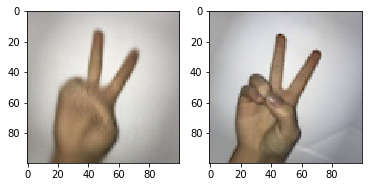

Epoch 79/100
100/100 [==============================] - 32s 323ms/step - loss: 226.0374
84.92899322509766 120.29600094280327 17.882832181018227 278.35564613342285 0.16222422 0.944688874921433
Digit: 2.0. Predicted: 2. Believability: 0.268


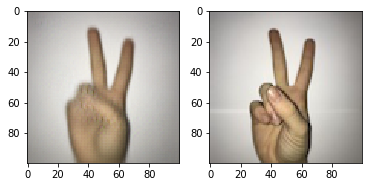

Epoch 80/100
100/100 [==============================] - 32s 322ms/step - loss: 225.7877
83.84088134765625 125.14372839409177 17.894712759270902 299.5285749435425 0.17473122 0.9352608422375864
Digit: 4.0. Predicted: 4. Believability: 0.002


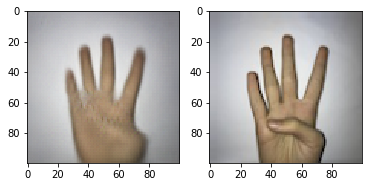

Epoch 81/100
100/100 [==============================] - 32s 322ms/step - loss: 225.4274
85.70576477050781 120.05414244186046 17.882256442489002 177.22461223602295 0.16368687 0.9418604651162791
Digit: 1.0. Predicted: 7. Believability: 0.302


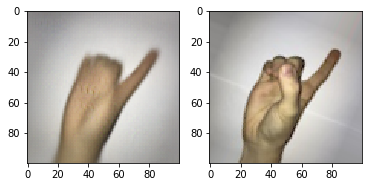

Epoch 82/100
100/100 [==============================] - 32s 322ms/step - loss: 225.8937
84.1556396484375 129.4449343966059 17.904688874921433 235.93356609344482 0.19860625 0.9365179132620993
Digit: 7.0. Predicted: 7. Believability: 0.839


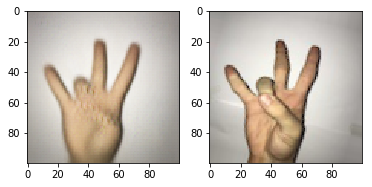

Epoch 83/100
100/100 [==============================] - 32s 323ms/step - loss: 224.9195
86.00872039794922 118.46797415147707 17.878754242614708 240.0888204574585 0.16280039 0.9424890006285355
Digit: 9.0. Predicted: 9. Believability: 0.071


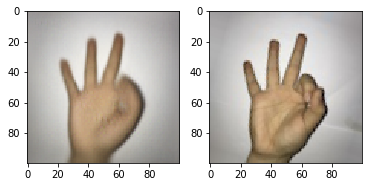

Epoch 84/100
100/100 [==============================] - 32s 321ms/step - loss: 224.7731
84.31684112548828 120.4057393148963 17.88290509113765 285.4696273803711 0.17488326 0.9380892520427404
Digit: 3.0. Predicted: 3. Believability: 0.006


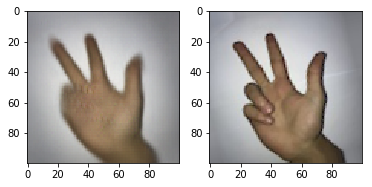

Epoch 85/100
100/100 [==============================] - 32s 322ms/step - loss: 225.5802
88.3670425415039 121.80649945003142 17.885761156505342 296.9431400299072 0.15728003 0.9456316781898177
Digit: 1.0. Predicted: 1. Believability: 0.266


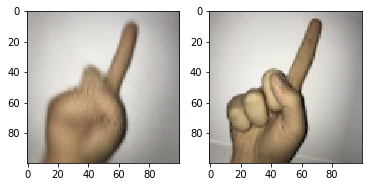

Epoch 86/100
100/100 [==============================] - 32s 322ms/step - loss: 225.5750
85.64439392089844 119.73132071024513 17.881258328095537 232.89453983306885 0.17435004 0.9399748585795098
Digit: 1.0. Predicted: 2. Believability: 0.021


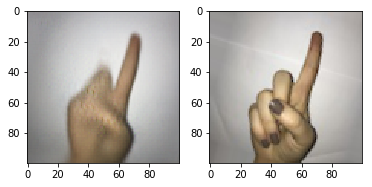

Epoch 87/100
100/100 [==============================] - 32s 323ms/step - loss: 224.7899
87.51838684082031 120.05798240100566 17.882471401634195 229.18822765350342 0.17410566 0.9421747328724073
Digit: 9.0. Predicted: 9. Believability: 0.040


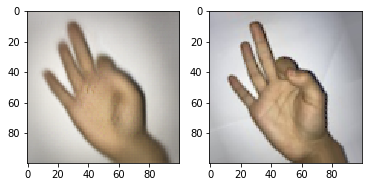

Epoch 88/100
100/100 [==============================] - 32s 324ms/step - loss: 225.2590
84.5216293334961 125.64902184160906 17.896494028912635 198.94235134124756 0.18644764 0.9355751099937146
Digit: 5.0. Predicted: 5. Believability: 0.205


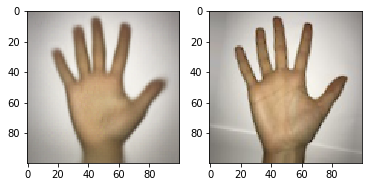

Epoch 89/100
100/100 [==============================] - 32s 322ms/step - loss: 224.5299
84.84516143798828 120.01847305153991 17.881870521684476 273.8316297531128 0.16035946 0.9424890006285355
Digit: 6.0. Predicted: 6. Believability: 0.043


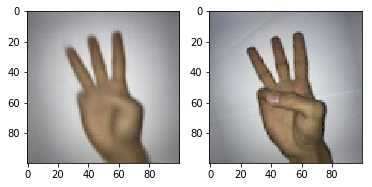

Epoch 90/100
100/100 [==============================] - 32s 324ms/step - loss: 225.9420
85.28032684326172 124.21922140163419 17.89280829666876 280.36930561065674 0.16576922 0.947517284726587
Digit: 0.0. Predicted: 0. Believability: 0.090


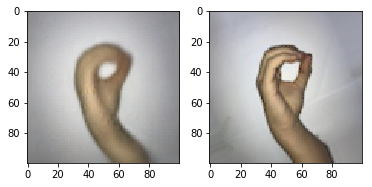

Epoch 91/100
100/100 [==============================] - 32s 321ms/step - loss: 224.6497
88.13094329833984 117.87575620678818 17.87714267756128 194.0887689590454 0.155384 0.947517284726587
Digit: 5.0. Predicted: 5. Believability: 0.004


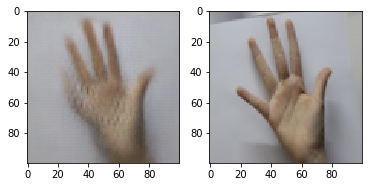

Epoch 92/100
100/100 [==============================] - 32s 324ms/step - loss: 225.2991
84.90621185302734 124.64249096480201 17.89343180389692 310.9055757522583 0.18039297 0.9390320553111251
Digit: 3.0. Predicted: 3. Believability: 0.012


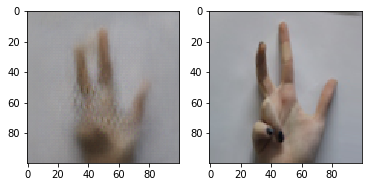

Epoch 93/100
100/100 [==============================] - 32s 322ms/step - loss: 225.0244
83.81006622314453 120.04277969830295 17.88235575109994 227.25145816802979 0.17669849 0.9409176618478944
Digit: 7.0. Predicted: 7. Believability: 0.135


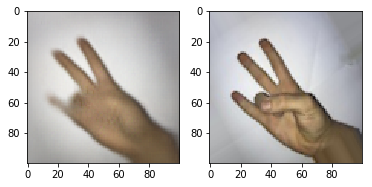

Epoch 94/100
100/100 [==============================] - 32s 324ms/step - loss: 224.0353
86.79943084716797 123.0469241043369 17.88928095537398 241.1062240600586 0.15656689 0.9465744814582024
Digit: 8.0. Predicted: 8. Believability: 0.032


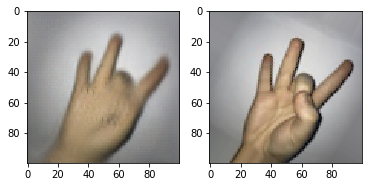

Epoch 95/100
100/100 [==============================] - 32s 322ms/step - loss: 225.9742
84.98799133300781 122.42029384035197 17.888233815210558 150.98938941955566 0.17895703 0.9330609679446888
Digit: 4.0. Predicted: 4. Believability: 0.119


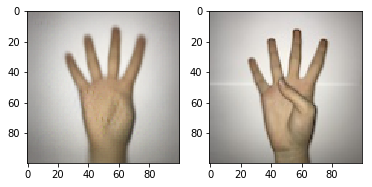

Epoch 96/100
100/100 [==============================] - 32s 324ms/step - loss: 224.3948
87.34884643554688 121.12243675361408 17.88715021998743 225.52719116210938 0.17558761 0.9377749842866122
Digit: 7.0. Predicted: 7. Believability: 0.006


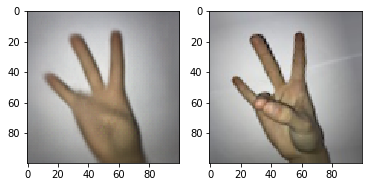

Epoch 97/100
100/100 [==============================] - 32s 322ms/step - loss: 224.1520
85.25154113769531 119.63524316467631 17.881098680075425 201.3911485671997 0.17498386 0.9428032683846638
Digit: 5.0. Predicted: 5. Believability: 0.288


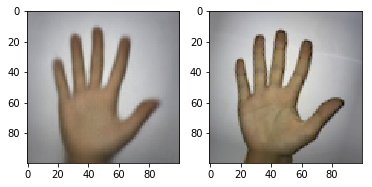

Epoch 98/100
100/100 [==============================] - 32s 324ms/step - loss: 225.1464
86.13542175292969 117.88154069767442 17.877187932118165 172.04065322875977 0.1876087 0.9330609679446888
Digit: 5.0. Predicted: 5. Believability: 0.051


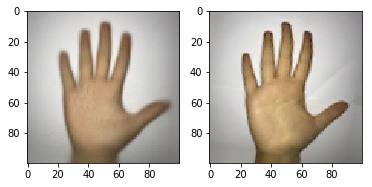

Epoch 99/100
100/100 [==============================] - 32s 322ms/step - loss: 224.4158
85.1482925415039 120.02374685732244 17.88211439346323 176.25553607940674 0.15692368 0.9450031426775612
Digit: 4.0. Predicted: 4. Believability: 0.091


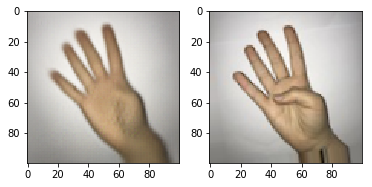

Epoch 100/100
100/100 [==============================] - 32s 322ms/step - loss: 224.4297
83.79908752441406 126.16105240414834 17.897556253928347 304.1372299194336 0.18091574 0.937460716530484
Digit: 5.0. Predicted: 5. Believability: 0.049


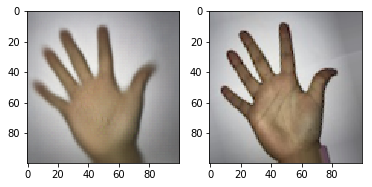

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=100)

In [0]:
# forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
# authenticator.save_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

In [0]:
forgerer.load_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
authenticator.load_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

In [0]:
print(" --- Authenticator --- ")
authenticator.fit_generator(images_gen,\
                            callbacks = [AuthenticatorMetrics()],\
                            steps_per_epoch = 100,\
                            epochs = 1
                           )

 --- Authenticator --- 
Epoch 1/1
100/100 [==============================] - 19s 187ms/step - loss: 0.0564
Accuracy: 0.9902576995600252


 --- Forgerer --- 
Epoch 1/100
100/100 [==============================] - 33s 327ms/step - loss: 246.8012
87.1334228515625 134.331208752357 17.914597108736647 0.8217426016926765 0.15729776 0.9500314267756128
Digit: 5.0. Predicted: 5. Believability: 1.000


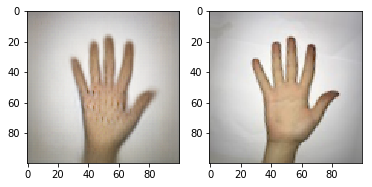

Epoch 2/100
100/100 [==============================] - 32s 322ms/step - loss: 231.8216
85.48057556152344 124.99174065053425 17.89306348208674 7.4841611087322235 0.14831758 0.9478315524827152
Digit: 6.0. Predicted: 6. Believability: 0.945


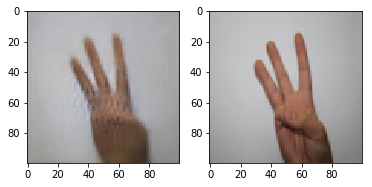

Epoch 3/100
100/100 [==============================] - 32s 323ms/step - loss: 230.1814
84.0933609008789 124.75302482715273 17.892555625392834 4.484796524047852 0.16654709 0.9384035197988686
Digit: 4.0. Predicted: 4. Believability: 0.959


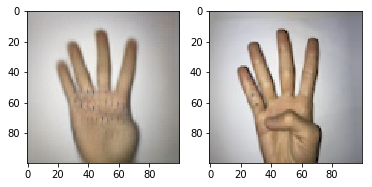

Epoch 4/100
100/100 [==============================] - 32s 323ms/step - loss: 230.5107
87.12824249267578 121.76022352294154 17.885780012570713 6.099652871489525 0.16653681 0.9421747328724073
Digit: 0.0. Predicted: 0. Believability: 0.881


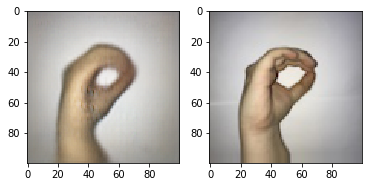

Epoch 5/100
100/100 [==============================] - 32s 323ms/step - loss: 230.5828
87.3510971069336 126.38405483972345 17.897596480201134 8.77818837761879 0.17036535 0.9424890006285355
Digit: 2.0. Predicted: 6. Believability: 0.756


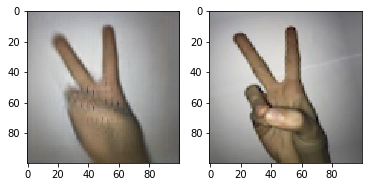

Epoch 6/100
100/100 [==============================] - 32s 322ms/step - loss: 229.9294
87.30924224853516 121.08569688874921 17.884711502199874 5.8808427304029465 0.1589037 0.9409176618478944
Digit: 4.0. Predicted: 4. Believability: 0.959


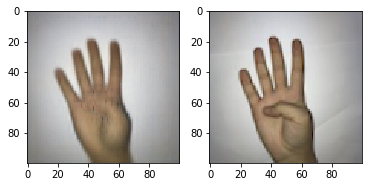

Epoch 7/100
100/100 [==============================] - 32s 323ms/step - loss: 228.7237
84.11430358886719 125.49774120050283 17.89423884349466 1.8783386796712875 0.17101565 0.9409176618478944
Digit: 4.0. Predicted: 4. Believability: 0.999


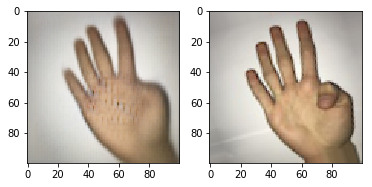

Epoch 8/100
100/100 [==============================] - 32s 322ms/step - loss: 230.7015
86.75004577636719 123.50597108736643 17.890750471401635 3.174217790365219 0.16663177 0.9424890006285355
Digit: 7.0. Predicted: 7. Believability: 0.961


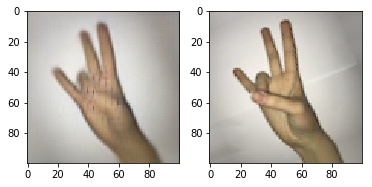

Epoch 9/100
100/100 [==============================] - 32s 323ms/step - loss: 228.4159
87.25308227539062 123.91895820238844 17.8913588937775 3.555581718683243 0.17653406 0.9393463230672533
Digit: 0.0. Predicted: 0. Believability: 0.998


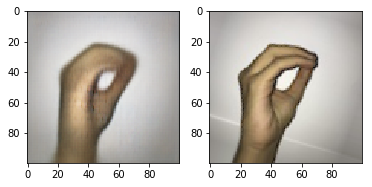

Epoch 10/100
100/100 [==============================] - 32s 323ms/step - loss: 230.3336
86.73778533935547 121.19761549340038 17.884438717787553 4.11309152841568 0.1596971 0.9456316781898177
Digit: 9.0. Predicted: 9. Believability: 0.973


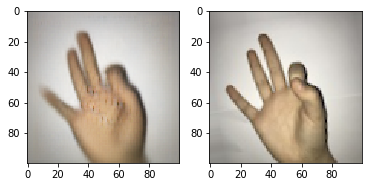

Epoch 11/100
100/100 [==============================] - 32s 323ms/step - loss: 227.9622
84.65201568603516 129.3885233343809 17.90411187932118 4.132722690701485 0.1768789 0.9399748585795098
Digit: 6.0. Predicted: 6. Believability: 0.935


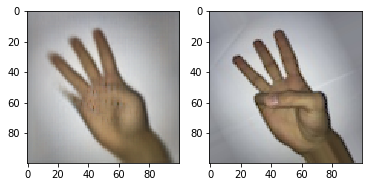

Epoch 12/100
100/100 [==============================] - 32s 322ms/step - loss: 230.3229
84.13615417480469 124.87470537397863 17.89348460087995 3.499862551689148 0.1860075 0.9355751099937146
Digit: 5.0. Predicted: 5. Believability: 0.998


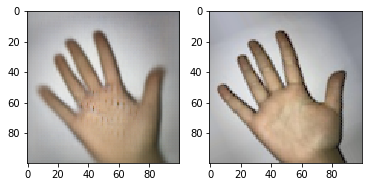

Epoch 13/100
100/100 [==============================] - 32s 324ms/step - loss: 229.0551
86.07909393310547 121.31103669076053 17.884995600251415 5.384464934468269 0.17132036 0.9428032683846638
Digit: 2.0. Predicted: 2. Believability: 0.993


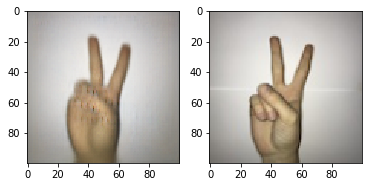

Epoch 14/100
100/100 [==============================] - 32s 322ms/step - loss: 228.0041
85.86311340332031 120.29310378692647 17.88230546825896 2.6358587667346 0.16807008 0.943117536140792
Digit: 7.0. Predicted: 7. Believability: 0.933


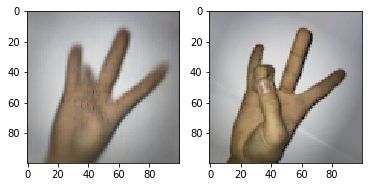

Epoch 15/100
100/100 [==============================] - 32s 323ms/step - loss: 228.1955
84.68622589111328 123.8457141734758 17.891766184789443 6.253349035978317 0.15988067 0.9393463230672533
Digit: 2.0. Predicted: 6. Believability: 0.989


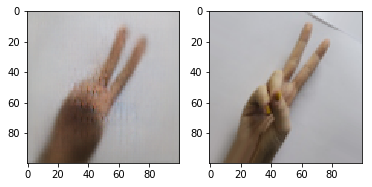

Epoch 16/100
100/100 [==============================] - 32s 322ms/step - loss: 227.6672
85.8746109008789 130.51294390320552 17.908364550597106 4.105936363339424 0.16567059 0.9428032683846638
Digit: 9.0. Predicted: 9. Believability: 0.958


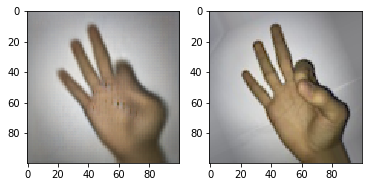

Epoch 17/100
100/100 [==============================] - 32s 321ms/step - loss: 227.9388
86.11611938476562 123.86418722501571 17.890511627906978 2.9439937323331833 0.17312956 0.9365179132620993
Digit: 3.0. Predicted: 3. Believability: 0.906


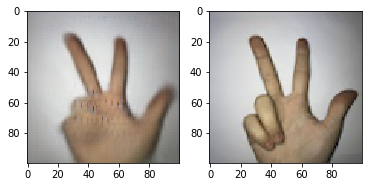

Epoch 18/100
100/100 [==============================] - 32s 323ms/step - loss: 227.1960
84.88854217529297 121.29981143934633 17.88518416090509 4.205412417650223 0.17369436 0.9409176618478944
Digit: 1.0. Predicted: 1. Believability: 0.984


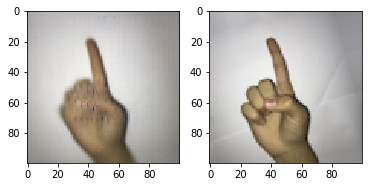

Epoch 19/100
100/100 [==============================] - 32s 322ms/step - loss: 228.2274
83.18682861328125 125.17647116593338 17.89364676304211 4.013477265834808 0.17360784 0.937460716530484
Digit: 8.0. Predicted: 8. Believability: 0.945


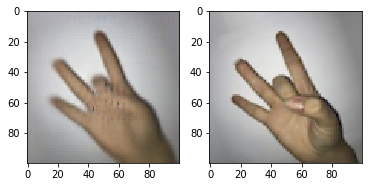

Epoch 20/100
100/100 [==============================] - 32s 322ms/step - loss: 228.0713
86.01655578613281 129.88122642991829 17.904967944688874 8.476027101278305 0.18224134 0.9393463230672533
Digit: 0.0. Predicted: 0. Believability: 0.909


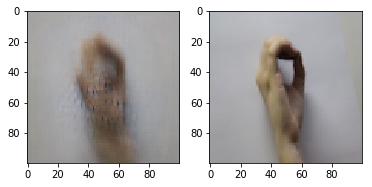

Epoch 21/100
100/100 [==============================] - 32s 322ms/step - loss: 228.6821
86.58679962158203 119.75128653362665 17.881522313010688 2.086998336017132 0.17241074 0.9390320553111251
Digit: 5.0. Predicted: 5. Believability: 0.992


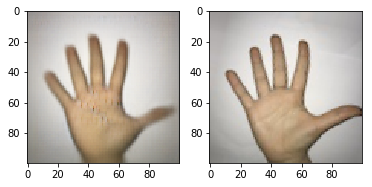

Epoch 22/100
100/100 [==============================] - 32s 324ms/step - loss: 228.0192
87.1187515258789 123.00179721873036 17.888301697045886 2.4977637454867363 0.16217312 0.9443746071653049
Digit: 6.0. Predicted: 6. Believability: 0.993


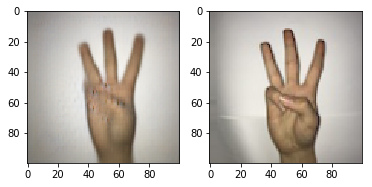

Epoch 23/100
100/100 [==============================] - 32s 322ms/step - loss: 227.4142
85.70832061767578 134.37872210873664 17.917483343808925 4.103356599807739 0.16318104 0.9459459459459459
Digit: 3.0. Predicted: 3. Believability: 0.946


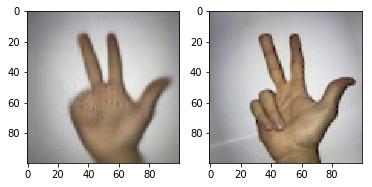

Epoch 24/100
100/100 [==============================] - 32s 324ms/step - loss: 227.8668
84.56515502929688 127.16401830609679 17.89944814582024 4.0336329489946365 0.17871742 0.9346323067253299
Digit: 0.0. Predicted: 0. Believability: 0.994


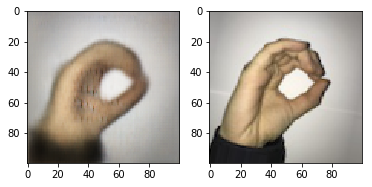

Epoch 25/100
100/100 [==============================] - 32s 322ms/step - loss: 227.9468
85.24708557128906 124.80907251728473 17.89363293526084 8.38288739323616 0.1769442 0.9409176618478944
Digit: 3.0. Predicted: 3. Believability: 0.843


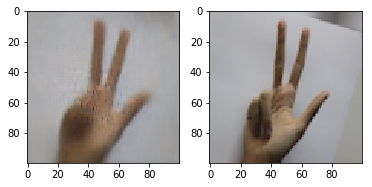

Epoch 26/100
100/100 [==============================] - 32s 323ms/step - loss: 228.2084
86.73884582519531 130.34121621621622 17.908351979886863 1.799633912742138 0.1665786 0.9406033940917662
Digit: 9.0. Predicted: 9. Believability: 0.937


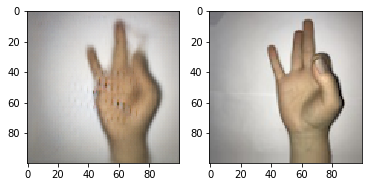

Epoch 27/100
100/100 [==============================] - 32s 322ms/step - loss: 227.1642
84.9153823852539 120.69898059396606 17.883415461973602 5.258158594369888 0.16478664 0.9478315524827152
Digit: 5.0. Predicted: 5. Believability: 1.000


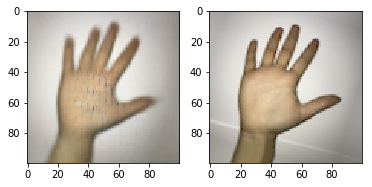

Epoch 28/100
100/100 [==============================] - 32s 323ms/step - loss: 227.7141
85.8852310180664 129.59102961973602 17.905093651791326 3.828861564397812 0.17728429 0.9390320553111251
Digit: 5.0. Predicted: 5. Believability: 0.977


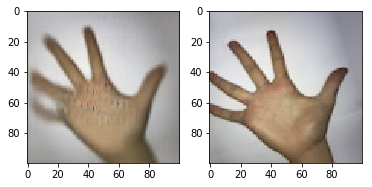

Epoch 29/100
100/100 [==============================] - 32s 322ms/step - loss: 228.4364
88.30938720703125 130.2219319610308 17.908494028912635 2.8483476489782333 0.15045387 0.9478315524827152
Digit: 0.0. Predicted: 0. Believability: 0.998


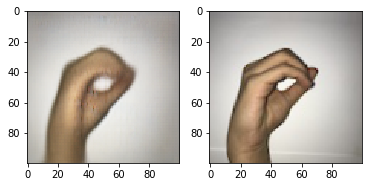

Epoch 30/100
100/100 [==============================] - 32s 322ms/step - loss: 228.1985
86.1326904296875 121.85344319610309 17.886972972972973 2.1895308047533035 0.17980295 0.9393463230672533
Digit: 1.0. Predicted: 1. Believability: 0.991


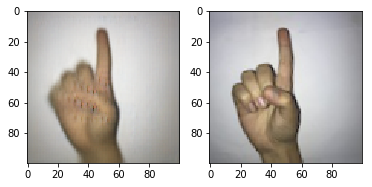

Epoch 31/100
100/100 [==============================] - 32s 323ms/step - loss: 227.7571
87.47004699707031 118.90500274984286 17.879861722187304 4.3610841035842896 0.14063561 0.9472030169704588
Digit: 5.0. Predicted: 5. Believability: 0.974


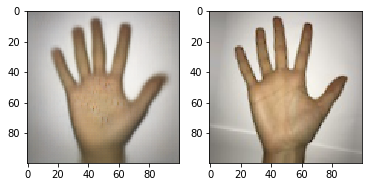

Epoch 32/100
100/100 [==============================] - 32s 322ms/step - loss: 226.3404
82.9459457397461 125.6857224230044 17.894959145191706 10.714752227067947 0.18250164 0.9390320553111251
Digit: 2.0. Predicted: 2. Believability: 0.892


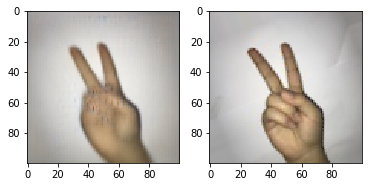

Epoch 33/100
100/100 [==============================] - 32s 323ms/step - loss: 228.2465
86.23949432373047 119.17841569767442 17.88018604651163 3.6057207733392715 0.17257269 0.9424890006285355
Digit: 4.0. Predicted: 4. Believability: 0.898


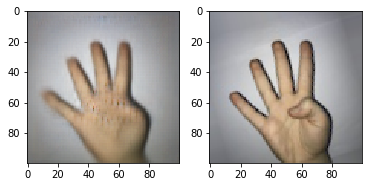

Epoch 34/100
100/100 [==============================] - 32s 322ms/step - loss: 227.7696
84.83934020996094 125.36759506599623 17.895321181646764 5.152065306901932 0.17431656 0.9421747328724073
Digit: 6.0. Predicted: 6. Believability: 0.992


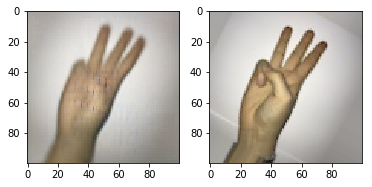

Epoch 35/100
100/100 [==============================] - 32s 324ms/step - loss: 227.8423
84.26283264160156 122.4016145505971 17.887562539283472 1.778079941868782 0.15913099 0.9437460716530484
Digit: 8.0. Predicted: 8. Believability: 0.993


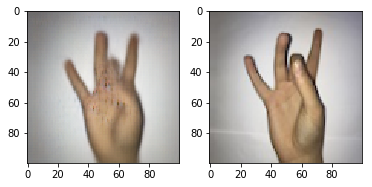

Epoch 36/100
100/100 [==============================] - 32s 322ms/step - loss: 226.5405
86.6091079711914 122.24653323381521 17.88766561910748 4.0943533182144165 0.14822868 0.9506599622878693
Digit: 7.0. Predicted: 7. Believability: 0.966


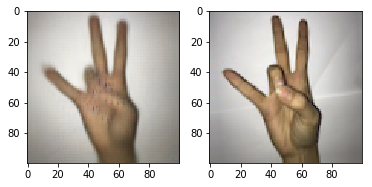

Epoch 37/100
100/100 [==============================] - 32s 323ms/step - loss: 228.2956
85.17591094970703 126.9643502514142 17.899218101822754 5.93402236700058 0.19062965 0.9324324324324325
Digit: 7.0. Predicted: 7. Believability: 0.913


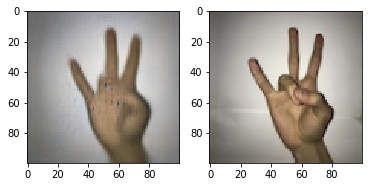

Epoch 38/100
100/100 [==============================] - 32s 322ms/step - loss: 226.3267
85.17346954345703 122.09223758642364 17.886695160276556 3.1158996745944023 0.18298882 0.9406033940917662
Digit: 7.0. Predicted: 7. Believability: 0.978


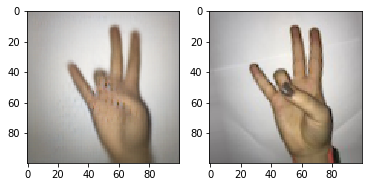

Epoch 39/100
100/100 [==============================] - 32s 323ms/step - loss: 227.6428
85.9893798828125 123.41994028912633 17.890471401634194 3.859085962176323 0.15185392 0.9494028912633564
Digit: 9.0. Predicted: 9. Believability: 0.867


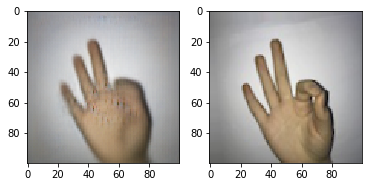

Epoch 40/100
100/100 [==============================] - 32s 322ms/step - loss: 226.7524
86.72750091552734 120.01367064739158 17.882143306096793 5.60525469481945 0.17394246 0.9396605908233815
Digit: 3.0. Predicted: 3. Believability: 0.912


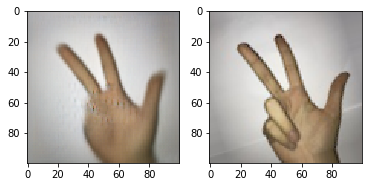

Epoch 41/100
100/100 [==============================] - 32s 323ms/step - loss: 228.3483
83.98123931884766 124.38170765241986 17.892325581395347 4.918007552623749 0.18944095 0.9324324324324325
Digit: 0.0. Predicted: 0. Believability: 0.967


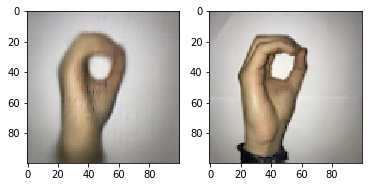

Epoch 42/100
100/100 [==============================] - 32s 322ms/step - loss: 226.5885
87.08106231689453 121.50909412319297 17.88639094908862 2.694033645093441 0.18419221 0.9336895034569453
Digit: 1.0. Predicted: 1. Believability: 0.999


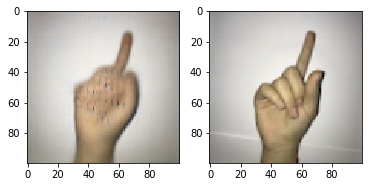

Epoch 43/100
100/100 [==============================] - 32s 321ms/step - loss: 227.5446
86.5379867553711 132.40275377121307 17.91377624135764 1.705959439277649 0.16982244 0.9428032683846638
Digit: 4.0. Predicted: 6. Believability: 0.998


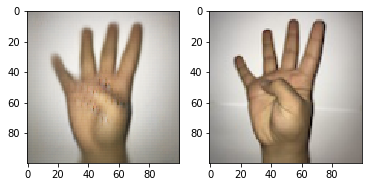

Epoch 44/100
100/100 [==============================] - 32s 323ms/step - loss: 227.7096
87.85881805419922 120.30824756442489 17.883752357008174 1.7840547487139702 0.15081769 0.947517284726587
Digit: 5.0. Predicted: 5. Believability: 0.999


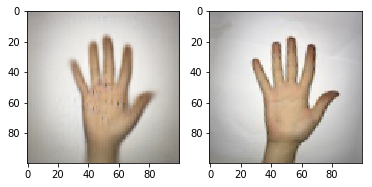

Epoch 45/100
100/100 [==============================] - 32s 321ms/step - loss: 226.6138
85.77681732177734 121.49909648020113 17.885546197360153 4.009471088647842 0.16564615 0.9412319296040226
Digit: 8.0. Predicted: 8. Believability: 0.996


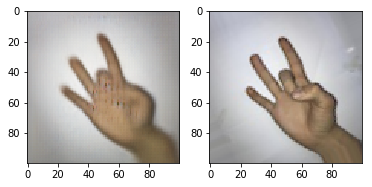

Epoch 46/100
100/100 [==============================] - 32s 323ms/step - loss: 225.9863
84.88313293457031 125.60278519798868 17.894318038969203 9.498339891433716 0.16490433 0.943117536140792
Digit: 0.0. Predicted: 0. Believability: 0.804


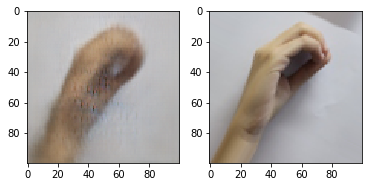

Epoch 47/100
100/100 [==============================] - 32s 322ms/step - loss: 228.1377
85.47600555419922 121.82905798240101 17.887240729101194 3.0584508553147316 0.16061305 0.9450031426775612
Digit: 0.0. Predicted: 0. Believability: 0.996


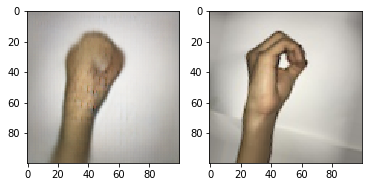

Epoch 48/100
100/100 [==============================] - 32s 323ms/step - loss: 225.8925
85.36511993408203 123.66047297297297 17.891939660590822 1.893499493598938 0.15143882 0.9487743557510999
Digit: 1.0. Predicted: 1. Believability: 0.972


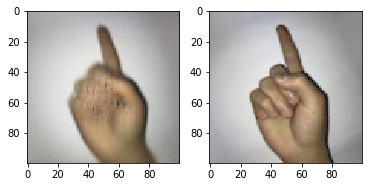

Epoch 49/100
100/100 [==============================] - 32s 322ms/step - loss: 225.3223
85.5024642944336 123.53768266813324 17.889709616593336 5.334777012467384 0.16038264 0.9434318038969202
Digit: 7.0. Predicted: 7. Believability: 0.919


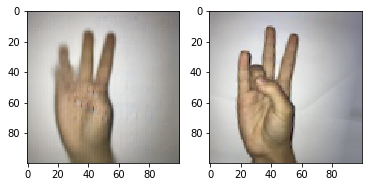

Epoch 50/100
100/100 [==============================] - 32s 323ms/step - loss: 227.1098
87.84793090820312 117.68867850408549 17.876670018856064 1.441328413784504 0.1581235 0.9418604651162791
Digit: 2.0. Predicted: 2. Believability: 0.995


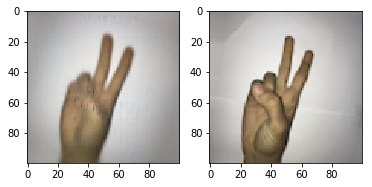

Epoch 51/100
100/100 [==============================] - 32s 322ms/step - loss: 226.5559
84.58026885986328 122.71530287554997 17.889208045254556 4.992412030696869 0.16455974 0.9484600879949717
Digit: 4.0. Predicted: 4. Believability: 0.993


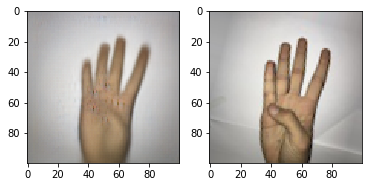

Epoch 52/100
100/100 [==============================] - 32s 323ms/step - loss: 227.0712
83.74388885498047 126.97552639849151 17.89865996228787 6.891588121652603 0.18310419 0.9387177875549969
Digit: 5.0. Predicted: 5. Believability: 0.925


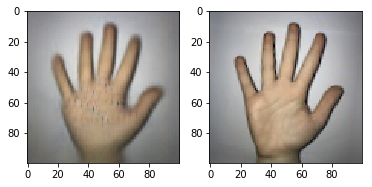

Epoch 53/100
100/100 [==============================] - 32s 323ms/step - loss: 226.5684
85.4277572631836 122.70460795097424 17.887738529226905 4.103976488113403 0.16292714 0.943117536140792
Digit: 6.0. Predicted: 6. Believability: 0.996


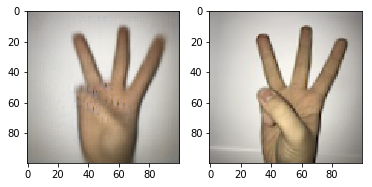

Epoch 54/100
100/100 [==============================] - 32s 323ms/step - loss: 225.4322
85.5751724243164 120.2513061753614 17.882585795097423 3.2293207943439484 0.15660602 0.9440603394091767
Digit: 3.0. Predicted: 3. Believability: 0.991


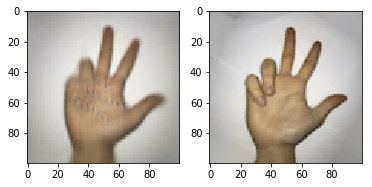

Epoch 55/100
100/100 [==============================] - 32s 321ms/step - loss: 226.4606
86.1771469116211 124.95063049968573 17.895034569453177 2.5449497625231743 0.17054357 0.9424890006285355
Digit: 9.0. Predicted: 9. Believability: 0.998


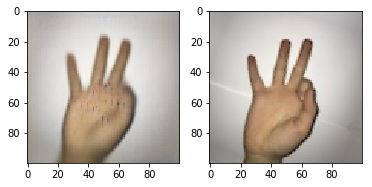

Epoch 56/100
100/100 [==============================] - 32s 322ms/step - loss: 226.5621
87.26326751708984 126.0082298868636 17.895689503456946 4.346330836415291 0.16928166 0.9428032683846638
Digit: 5.0. Predicted: 5. Believability: 0.993


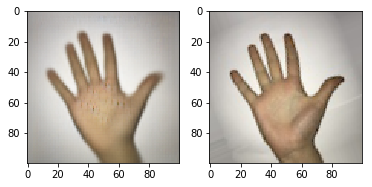

Epoch 57/100
100/100 [==============================] - 32s 322ms/step - loss: 225.7999
84.76337432861328 122.02049615021998 17.886805782526714 2.7618953958153725 0.16428652 0.9465744814582024
Digit: 9.0. Predicted: 9. Believability: 0.992


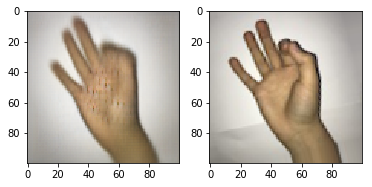

Epoch 58/100
100/100 [==============================] - 32s 322ms/step - loss: 226.7049
85.93756103515625 120.80861093651791 17.88437837837838 7.523135095834732 0.16057006 0.947517284726587
Digit: 5.0. Predicted: 5. Believability: 0.970


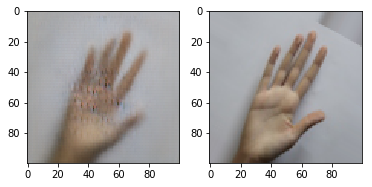

Epoch 59/100
100/100 [==============================] - 32s 324ms/step - loss: 226.4014
84.9442367553711 118.89192135449403 17.879421747328724 1.791161671280861 0.15001297 0.947517284726587
Digit: 4.0. Predicted: 4. Believability: 0.994


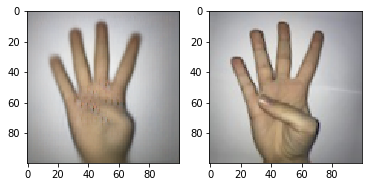

Epoch 60/100
100/100 [==============================] - 32s 322ms/step - loss: 226.2498
85.53347778320312 120.33717983972345 17.883258328095536 2.6091646403074265 0.16070467 0.9424890006285355
Digit: 6.0. Predicted: 6. Believability: 0.989


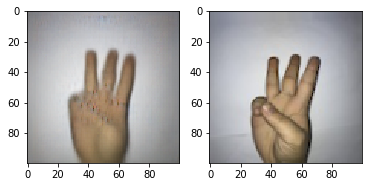

Epoch 61/100
100/100 [==============================] - 32s 323ms/step - loss: 225.4011
86.17662048339844 117.70215273412948 17.876812067881833 3.4914709627628326 0.15947543 0.944688874921433
Digit: 8.0. Predicted: 8. Believability: 0.930


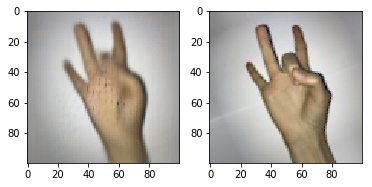

Epoch 62/100
100/100 [==============================] - 32s 322ms/step - loss: 226.6397
85.37804412841797 124.43863922061597 17.89258328095537 4.069255664944649 0.15683977 0.9453174104336896
Digit: 7.0. Predicted: 7. Believability: 0.945


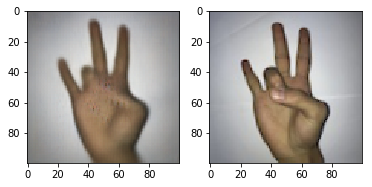

Epoch 63/100
100/100 [==============================] - 32s 324ms/step - loss: 226.1227
85.09555053710938 126.04089409176619 17.896318038969202 10.973521322011948 0.13843077 0.9578881206788183
Digit: 1.0. Predicted: 1. Believability: 0.974


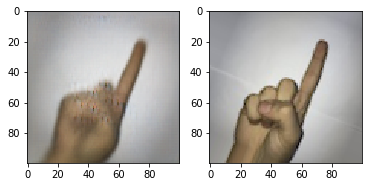

Epoch 64/100
100/100 [==============================] - 32s 322ms/step - loss: 225.2118
83.56379699707031 122.07884192331866 17.887112507856695 3.0955584719777107 0.17970625 0.9377749842866122
Digit: 3.0. Predicted: 3. Believability: 0.997


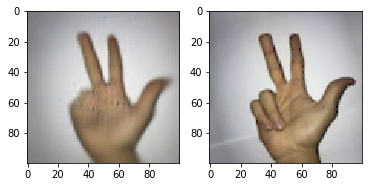

Epoch 65/100
100/100 [==============================] - 32s 323ms/step - loss: 226.7802
85.19020080566406 120.6285060496543 17.883165304839725 1.4773364178836346 0.17624383 0.9437460716530484
Digit: 5.0. Predicted: 5. Believability: 0.997


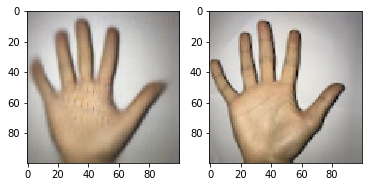

Epoch 66/100
100/100 [==============================] - 32s 321ms/step - loss: 225.4542
85.00526428222656 118.2212248585795 17.877905719673162 4.473507776856422 0.16379005 0.9468887492143306
Digit: 4.0. Predicted: 4. Believability: 0.979


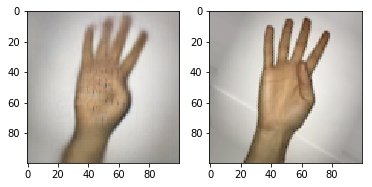

Epoch 67/100
100/100 [==============================] - 32s 323ms/step - loss: 225.9134
87.97640991210938 120.11301854179762 17.882428661219357 2.5374559685587883 0.1634 0.9421747328724073
Digit: 6.0. Predicted: 6. Believability: 0.987


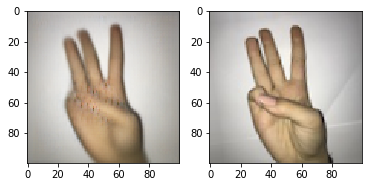

Epoch 68/100
100/100 [==============================] - 32s 322ms/step - loss: 226.3194
83.66665649414062 122.13516459773727 17.887065996228788 1.8369564786553383 0.17010085 0.9412319296040226
Digit: 4.0. Predicted: 4. Believability: 0.995


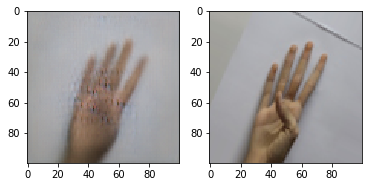

Epoch 69/100
100/100 [==============================] - 32s 322ms/step - loss: 225.2489
89.1903076171875 119.54645270270271 17.883201759899436 1.746431179344654 0.14321324 0.9481458202388435
Digit: 7.0. Predicted: 7. Believability: 0.999


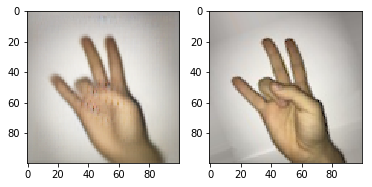

Epoch 70/100
100/100 [==============================] - 32s 324ms/step - loss: 226.7581
85.96467590332031 121.98923632935261 17.887494657448148 4.164217039942741 0.17257036 0.9421747328724073
Digit: 7.0. Predicted: 7. Believability: 0.989


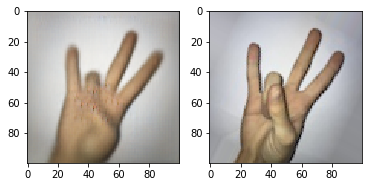

Epoch 71/100
100/100 [==============================] - 32s 321ms/step - loss: 225.3644
86.08647918701172 121.27401202074167 17.885157762413577 12.00704500079155 0.16812095 0.9415461973601509
Digit: 7.0. Predicted: 7. Believability: 0.989


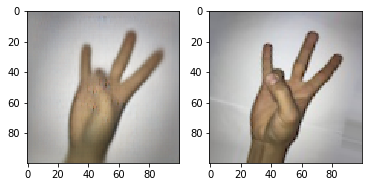

Epoch 72/100
100/100 [==============================] - 32s 323ms/step - loss: 225.8873
86.79779815673828 117.68166640477688 17.876770584538026 2.081667259335518 0.15533783 0.944688874921433
Digit: 5.0. Predicted: 5. Believability: 0.985


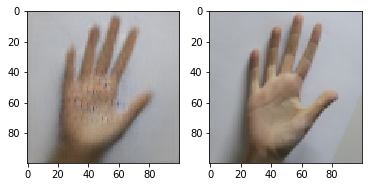

Epoch 73/100
100/100 [==============================] - 32s 322ms/step - loss: 227.5077
86.62733459472656 125.58216137649278 17.894730358265242 4.029608890414238 0.17340894 0.943117536140792
Digit: 6.0. Predicted: 6. Believability: 0.970


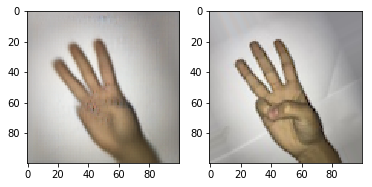

Epoch 74/100
100/100 [==============================] - 32s 323ms/step - loss: 224.8644
84.175048828125 122.87255460402262 17.88800879949717 4.951136559247971 0.16726859 0.9368321810182275
Digit: 1.0. Predicted: 1. Believability: 0.989


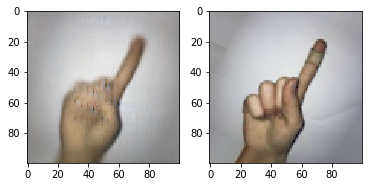

Epoch 75/100
100/100 [==============================] - 32s 322ms/step - loss: 225.7583
84.60798645019531 122.39106693903206 17.887805153991202 2.006240375339985 0.17702259 0.9399748585795098
Digit: 5.0. Predicted: 5. Believability: 0.995


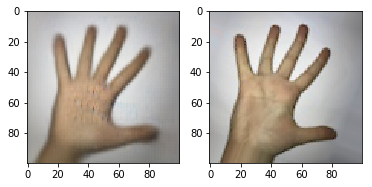

Epoch 76/100
100/100 [==============================] - 32s 323ms/step - loss: 226.8262
83.79808044433594 123.099554132621 17.889753614079197 5.204813182353973 0.17666845 0.9421747328724073
Digit: 1.0. Predicted: 1. Believability: 0.952


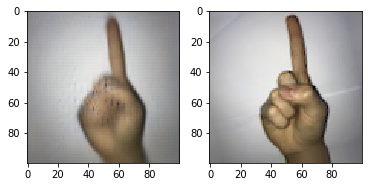

Epoch 77/100
100/100 [==============================] - 32s 322ms/step - loss: 225.2465
88.15775299072266 117.15944178189818 17.875474544311754 7.616327702999115 0.15719333 0.9462602137020741
Digit: 3.0. Predicted: 3. Believability: 0.936


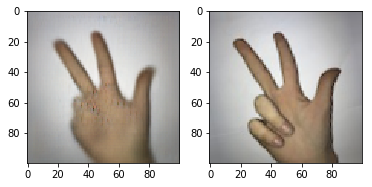

Epoch 78/100
100/100 [==============================] - 32s 323ms/step - loss: 225.0143
84.74457550048828 127.76208948774355 17.900663733500945 3.766579180955887 0.14919765 0.9459459459459459
Digit: 7.0. Predicted: 7. Believability: 0.996


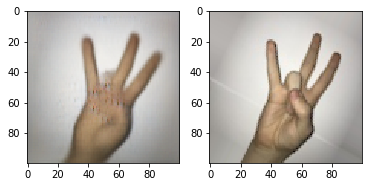

Epoch 79/100
100/100 [==============================] - 32s 322ms/step - loss: 225.4899
82.64572143554688 124.71833752357009 17.892329352608424 5.084367468953133 0.1585205 0.9428032683846638
Digit: 8.0. Predicted: 9. Believability: 0.963


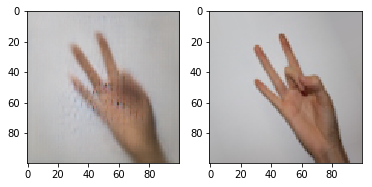

Epoch 80/100
100/100 [==============================] - 32s 324ms/step - loss: 224.5208
88.58499908447266 128.05818863922062 17.9054820867379 1.730061136186123 0.15746948 0.9456316781898177
Digit: 9.0. Predicted: 9. Believability: 0.997


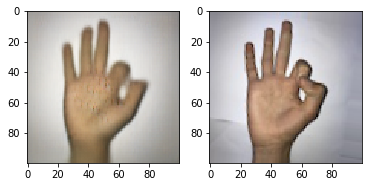

Epoch 81/100
100/100 [==============================] - 32s 322ms/step - loss: 224.7795
83.74938201904297 140.32116200502827 17.93104714016342 8.729927986860275 0.16810939 0.9437460716530484
Digit: 1.0. Predicted: 1. Believability: 0.961


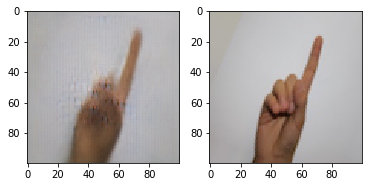

Epoch 82/100
100/100 [==============================] - 32s 323ms/step - loss: 225.3524
85.74571990966797 128.91399866436203 17.906144563167818 3.0721060931682587 0.16433804 0.9456316781898177
Digit: 5.0. Predicted: 5. Believability: 0.988


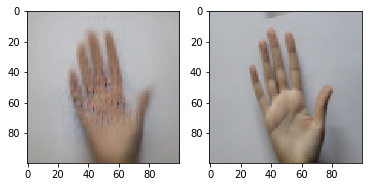

Epoch 83/100
100/100 [==============================] - 32s 323ms/step - loss: 225.7106
84.86389923095703 119.77898137963545 17.881229415461974 6.091611087322235 0.174319 0.9415461973601509
Digit: 1.0. Predicted: 1. Believability: 0.998


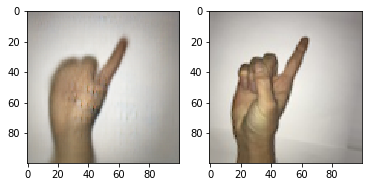

Epoch 84/100
100/100 [==============================] - 32s 322ms/step - loss: 224.4300
84.41386413574219 137.56290265556254 17.924569453174104 5.639698728919029 0.16644113 0.9418604651162791
Digit: 6.0. Predicted: 6. Believability: 0.871


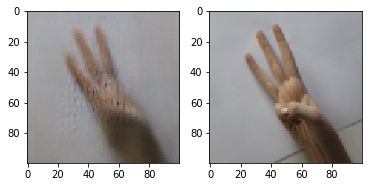

Epoch 85/100
100/100 [==============================] - 32s 323ms/step - loss: 224.4740
85.20455169677734 119.47495678818353 17.880705216844753 3.3575206995010376 0.15777867 0.9443746071653049
Digit: 7.0. Predicted: 7. Believability: 0.997


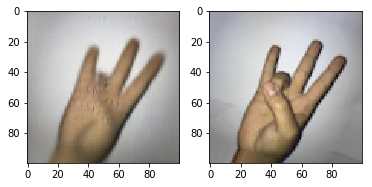

Epoch 86/100
100/100 [==============================] - 32s 322ms/step - loss: 223.8454
83.71437072753906 122.25591216216216 17.88749088623507 7.86726251244545 0.15705706 0.9453174104336896
Digit: 6.0. Predicted: 6. Believability: 0.993


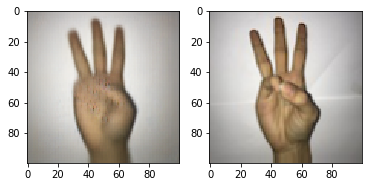

Epoch 87/100
100/100 [==============================] - 32s 323ms/step - loss: 225.7113
86.1527328491211 121.55981890320552 17.886795725958518 5.149266868829727 0.14731368 0.9490886235072281
Digit: 4.0. Predicted: 4. Believability: 0.992


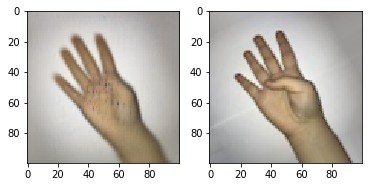

Epoch 88/100
100/100 [==============================] - 32s 322ms/step - loss: 223.1497
86.28556823730469 119.6362743557511 17.88097800125707 1.2986249290406704 0.1545244 0.9472030169704588
Digit: 2.0. Predicted: 2. Believability: 0.976


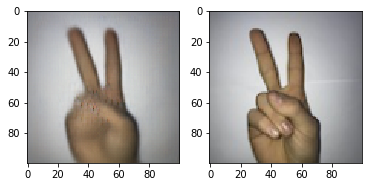

Epoch 89/100
100/100 [==============================] - 32s 323ms/step - loss: 224.6261
84.69135284423828 120.47556568196103 17.88363167818982 3.578750789165497 0.17742057 0.9421747328724073
Digit: 5.0. Predicted: 5. Believability: 0.999


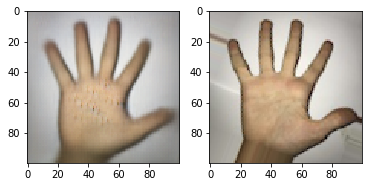

Epoch 90/100
100/100 [==============================] - 32s 321ms/step - loss: 225.2127
85.09909057617188 131.87851587052168 17.910802011313642 3.1452666968107224 0.16743882 0.9428032683846638
Digit: 1.0. Predicted: 1. Believability: 0.988


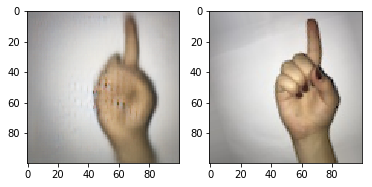

Epoch 91/100
100/100 [==============================] - 32s 323ms/step - loss: 225.4199
84.4174575805664 122.59305271841609 17.887964802011314 4.104156792163849 0.15731935 0.9443746071653049
Digit: 5.0. Predicted: 5. Believability: 0.995


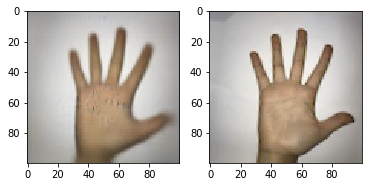

Epoch 92/100
100/100 [==============================] - 32s 322ms/step - loss: 225.0907
88.5778579711914 117.45973444374607 17.876221244500314 4.042263329029083 0.14451829 0.9516027655562539
Digit: 7.0. Predicted: 7. Believability: 0.990


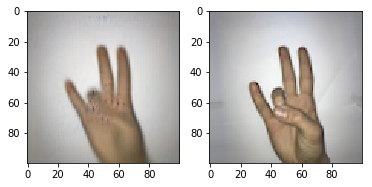

Epoch 93/100
100/100 [==============================] - 32s 324ms/step - loss: 224.9951
86.11276245117188 128.25106065367694 17.904424890006286 4.333425685763359 0.14381252 0.9506599622878693
Digit: 8.0. Predicted: 8. Believability: 0.975


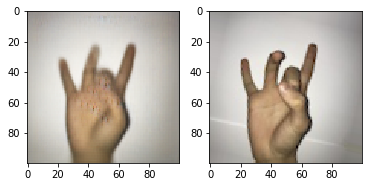

Epoch 94/100
100/100 [==============================] - 32s 322ms/step - loss: 225.2449
86.93572998046875 118.67054918290384 17.879373978629793 4.9473583698272705 0.14812072 0.9500314267756128
Digit: 4.0. Predicted: 6. Believability: 0.997


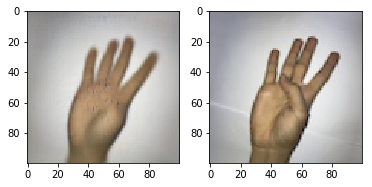

Epoch 95/100
100/100 [==============================] - 32s 322ms/step - loss: 225.0912
85.70525360107422 122.61447203016971 17.88938780641106 6.196014955639839 0.15700552 0.9443746071653049
Digit: 8.0. Predicted: 8. Believability: 0.909


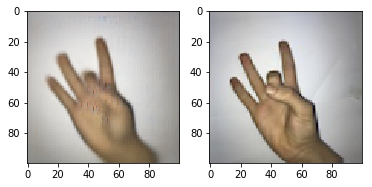

Epoch 96/100
100/100 [==============================] - 32s 324ms/step - loss: 224.1292
83.54009246826172 120.54127710559396 17.88333752357008 4.810643196105957 0.1573067 0.9434318038969202
Digit: 8.0. Predicted: 8. Believability: 0.982


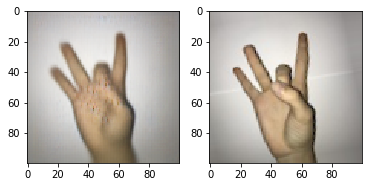

Epoch 97/100
100/100 [==============================] - 32s 322ms/step - loss: 224.4488
87.87579345703125 118.12915422690132 17.877778755499687 7.282158732414246 0.14889057 0.9459459459459459
Digit: 9.0. Predicted: 9. Believability: 0.996


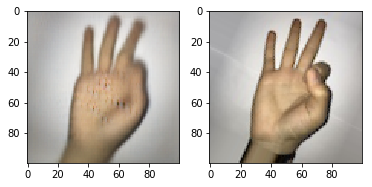

Epoch 98/100
100/100 [==============================] - 32s 323ms/step - loss: 225.0659
84.99180603027344 118.73759624450031 17.879208045254558 3.6531124264001846 0.16163011 0.9450031426775612
Digit: 1.0. Predicted: 1. Believability: 0.966


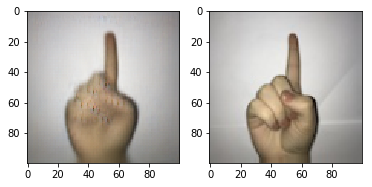

Epoch 99/100
100/100 [==============================] - 32s 323ms/step - loss: 225.5302
87.28488159179688 123.07397077309868 17.890189817724703 4.656420275568962 0.15966424 0.9453174104336896
Digit: 3.0. Predicted: 3. Believability: 0.988


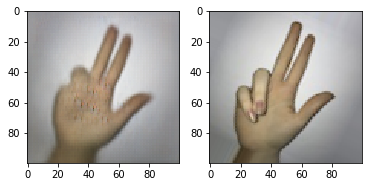

Epoch 100/100
100/100 [==============================] - 32s 323ms/step - loss: 225.4069
85.68511962890625 119.57884192331866 17.88139157762414 3.9439667016267776 0.13228482 0.9509742300439975
Digit: 0.0. Predicted: 0. Believability: 0.977


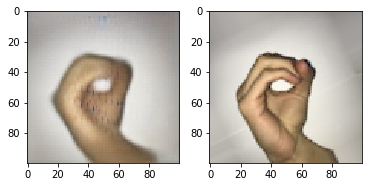

In [0]:
print(" --- Forgerer --- ")
forgerer.fit_generator(images_classes_gen,\
                       callbacks=[ForgererMetrics()],\
                       steps_per_epoch=100,\
                       epochs=100)

In [0]:
forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
authenticator.save_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

NameError: ignored

< 0 >
 --- Authenticator --- 
Epoch 1/1
100/100 [==============================] - 30s 302ms/step - loss: 5.2386
Accuracy: 0.64487743557511
Digit: 0.0. Predicted: 0. Believability: 1.000


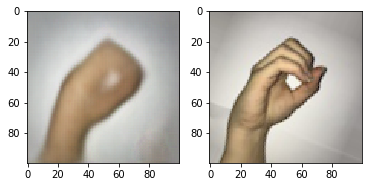

Digit: 0.0. Predicted: 0. Believability: 1.000


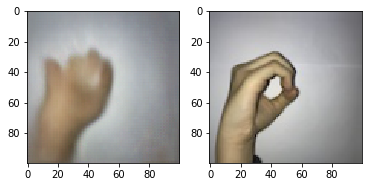

Digit: 7.0. Predicted: 7. Believability: 0.000


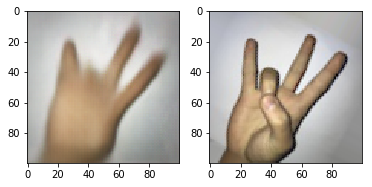

Digit: 7.0. Predicted: 7. Believability: 1.000


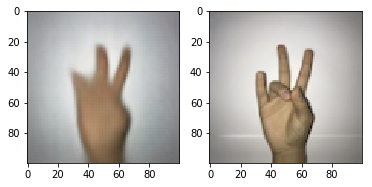

Digit: 2.0. Predicted: 7. Believability: 1.000


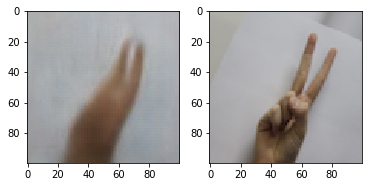

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 43s 433ms/step - loss: 417.4429
91.89511108398438 283.3578134820867 18.267148962916405 2.3841860752327193e-06 0.5515006 0.8199245757385293
Epoch 2/20
100/100 [==============================] - 30s 295ms/step - loss: 382.7478
79.2322998046875 292.33622721558766 18.27767944688875 2.3841860752327193e-06 0.60316604 0.8010685103708359
Epoch 3/20
100/100 [==============================] - 30s 296ms/step - loss: 350.6623
91.66658020019531 218.20081709616593 18.10644248900063 2.3841860752327193e-06 0.50086856 0.838152105593966
Epoch 4/20
100/100 [==============================] - 30s 297ms/step - loss: 349.9254
94.57514190673828 810.6046511627907 19.69603519798869 2.3841860752327193e-06 0.5153275 0.8318667504714017
Epoch 5/20
100/100 [==============================] - 30s 299ms/step - loss: 405.5353
88.84184265136719 231.91428346951602 18.14263984915148 2.3841860752327193e-06 0.50601196 0.8372093023255814
Epoch 6/20
100/1

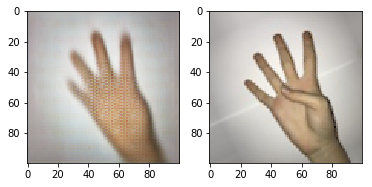

Digit: 1.0. Predicted: 1. Believability: 1.000


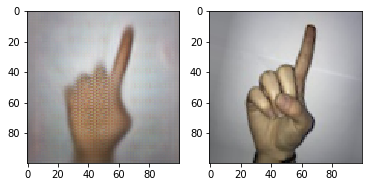

Digit: 1.0. Predicted: 1. Believability: 1.000


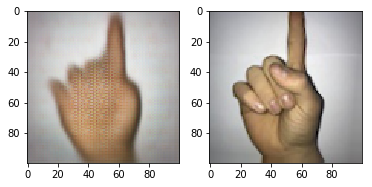

Digit: 9.0. Predicted: 9. Believability: 1.000


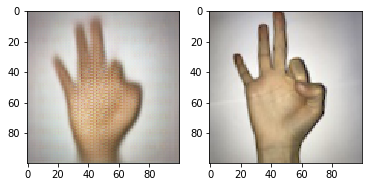

Digit: 4.0. Predicted: 4. Believability: 1.000


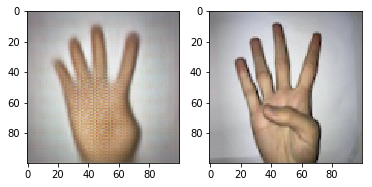

< 1 >
 --- Authenticator --- 
Epoch 1/1
100/100 [==============================] - 19s 187ms/step - loss: 0.9839
Accuracy: 0.9311753614079196
Digit: 1.0. Predicted: 1. Believability: 0.000


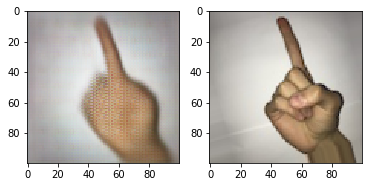

Digit: 3.0. Predicted: 3. Believability: 0.000


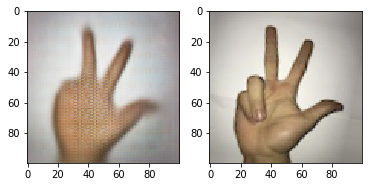

Digit: 8.0. Predicted: 8. Believability: 0.000


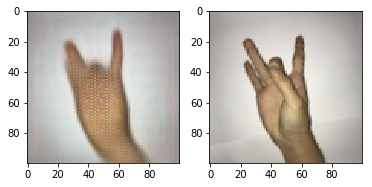

Digit: 5.0. Predicted: 3. Believability: 0.000


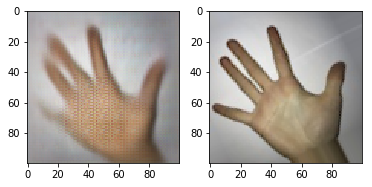

Digit: 7.0. Predicted: 7. Believability: 0.000


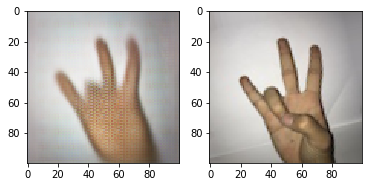

 --- Forgerer --- 
Epoch 1/20
100/100 [==============================] - 28s 283ms/step - loss: nan


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in log
  del sys.path[0]
/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: invalid value encountered in multiply
  del sys.path[0]


nan 13372.20615964802 nan 2.3841860752327193e-06 2.306104 0.09805153991200503
Epoch 2/20
100/100 [==============================] - 27s 273ms/step - loss: nan
nan 13372.20615964802 nan 2.3841860752327193e-06 2.304671 0.09805153991200503
Epoch 3/20
100/100 [==============================] - 27s 273ms/step - loss: nan
nan 13372.20615964802 nan 2.3841860752327193e-06 2.3038325 0.09805153991200503
Epoch 4/20
100/100 [==============================] - 27s 274ms/step - loss: nan
nan 13372.20615964802 nan 2.3841860752327193e-06 2.303265 0.09805153991200503
Epoch 5/20
100/100 [==============================] - 27s 273ms/step - loss: nan
nan 13372.20615964802 nan 2.3841860752327193e-06 2.3030741 0.09805153991200503
Epoch 6/20
100/100 [==============================] - 27s 273ms/step - loss: nan
nan 13372.20615964802 nan 2.3841860752327193e-06 2.3029175 0.09805153991200503
Epoch 7/20
100/100 [==============================] - 27s 272ms/step - loss: nan
nan 13372.20615964802 nan 2.384186075232719

In [0]:
for iteration in range(5):
  
  print(f"< {iteration} >")
  print(" --- Authenticator --- ")
  authenticator.fit_generator(images_gen,\
                              callbacks = [AuthenticatorMetrics()],\
                              steps_per_epoch = 100,\
                              epochs = 2
                             )
  print_fake_images(5)
  print(" --- Forgerer --- ")
  forgerer.fit_generator(images_classes_gen,\
                         callbacks=[ForgererMetrics()],\
                         steps_per_epoch=100,\
                         epochs=20)
  print_fake_images(5)

In [0]:
# forgerer.save_weights("/content/gdrive/My Drive/Colab Notebooks/forgerer_sign_lang.h5")
# authenticator.save_weights("/content/gdrive/My Drive/Colab Notebooks/authenticator_sign_lang.h5")

In [0]:
MNIST_image_dim = 28
MNIST_image_shape = (MNIST_image_dim, MNIST_image_dim, 1)

In [0]:
MNIST_data_gen = ImageDataGenerator(rescale=1./255,\
                                    rotation_range=30,\
                                    height_shift_range=0.1,\
                                    width_shift_range=0.1,\
                                    shear_range=0.1,\
                                    zoom_range=0.1)

(MNIST_images_train, MNIST_classes_train), (MNIST_images_test, MNIST_classes_test) = mnist.load_data()
MNIST_images = np.reshape( np.concatenate([MNIST_images_train, MNIST_images_test]), (-1, *MNIST_image_shape))
MNIST_classes = np.concatenate([MNIST_classes_train, MNIST_classes_test])

MNIST_Xy_gen =\
MNIST_data_gen.flow(MNIST_images, MNIST_classes,
                    batch_size = 32,
                    shuffle=True,
                    seed=123)

def get_MNIST_images_classes_gen():
  while True:
    images, classes = next(MNIST_Xy_gen)
    yield [images, classes], None

MNIST_images_classes_gen = get_MNIST_images_classes_gen()
    
def get_MNIST_images_gen():
  while True:
    images, _ = next(MNIST_Xy_gen)
    yield images, None
    
MNIST_images_gen = get_MNIST_images_gen()

In [0]:
MNIST_image_batches = []
MNIST_class_batches = []

for _ in range(100):
  images, labels = next(MNIST_Xy_gen)
  MNIST_image_batches.append(images)
  MNIST_class_batches.append(labels)
    
MNIST_sample_images = np.concatenate(MNIST_image_batches)
MNIST_sample_classes = np.concatenate(MNIST_class_batches)

MNIST_Xy_gen.reset()

MNIST_sample_images.shape, MNIST_sample_classes.shape

((3200, 28, 28, 1), (3200,))

In [0]:
# encoder
MNIST_real_images = Input(shape=MNIST_image_shape, name='MNIST_real_images')
x = Conv2D(filters=32,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='same')(MNIST_real_images)
x = LeakyReLU(alpha=0.2)(x)
x = Conv2D(filters=64,
           kernel_size=3,
           activation=None,
           strides=2,
           padding='same')(x)
x = LeakyReLU(alpha=0.2)(x)
x = Conv2D(filters=128,
           kernel_size=7,
           activation=None,
           strides=1,
           padding='valid')(x)
x = LeakyReLU(alpha=0.2)(x)
MNIST_narrow_shape = K.int_shape(x)
x = Flatten()(x)

MNIST_z_mean = Dense(latent_dim, name='MNIST_z_mean')(x)
MNIST_z_log_sigma2 = Dense(latent_dim, name='MNIST_z_log_sigma2')(x)

MNIST_encoder = Model(inputs=MNIST_real_images,\
                      outputs=[MNIST_z_mean, MNIST_z_log_sigma2],\
                      name='MNIST_encoder')

In [0]:
MNIST_encoder.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
MNIST_real_images (InputLayer)  (None, 28, 28, 1)    0                                            
__________________________________________________________________________________________________
conv2d_8 (Conv2D)               (None, 14, 14, 32)   320         MNIST_real_images[0][0]          
__________________________________________________________________________________________________
leaky_re_lu_5 (LeakyReLU)       (None, 14, 14, 32)   0           conv2d_8[0][0]                   
__________________________________________________________________________________________________
conv2d_9 (Conv2D)               (None, 7, 7, 64)     18496       leaky_re_lu_5[0][0]              
__________________________________________________________________________________________________
leaky_re_l

In [0]:
# image decoder

MNIST_z = Input(shape=(latent_dim,), name='MNIST_z_from_outside')

x = Dense(MNIST_narrow_shape[1] * MNIST_narrow_shape[2] * MNIST_narrow_shape[3],\
          activation=None)(MNIST_z)
x = Reshape(MNIST_narrow_shape[1:])(x)

x = BatchNormalization()(x)
x = ELU(alpha=2.0)(x)
x = Conv2DTranspose(filters=128,
                    kernel_size=7,
                    activation=None,
                    strides=1,
                    padding='valid')(x)
x = BatchNormalization()(x)
x = ELU(alpha=2.0)(x)
x = Conv2DTranspose(filters=64,
                    kernel_size=3,
                    activation=None,
                    strides=2,
                    padding='same')(x)
x = BatchNormalization()(x)
x = ELU(alpha=2.0)(x)
x = Conv2DTranspose(filters=32,
                    kernel_size=3,
                    activation='elu',
                    strides=2,
                    padding='same')(x)
x = BatchNormalization()(x)
x = ELU(alpha=2.0)(x)
MNIST_fake_images = Conv2DTranspose(filters=1,
                                    kernel_size=3,
                                    activation='sigmoid',
                                    padding='same',
                                    name='MNIST_fake_images')(x)

MNIST_decoder = Model(inputs=MNIST_z,\
                      outputs=MNIST_fake_images,\
                      name='MNIST_decoder')

In [0]:
MNIST_decoder.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
MNIST_z_from_outside (InputL (None, 64)                0         
_________________________________________________________________
dense_5 (Dense)              (None, 128)               8320      
_________________________________________________________________
reshape_2 (Reshape)          (None, 1, 1, 128)         0         
_________________________________________________________________
batch_normalization_9 (Batch (None, 1, 1, 128)         512       
_________________________________________________________________
elu_6 (ELU)                  (None, 1, 1, 128)         0         
_________________________________________________________________
conv2d_transpose_5 (Conv2DTr (None, 7, 7, 128)         802944    
_________________________________________________________________
batch_normalization_10 (Batc (None, 7, 7, 128)         512       
__________

In [0]:
MNIST_true_classes = Input(shape=(1,), name='MNIST_sparse_class_labels')

MNIST_z_mean, MNIST_z_log_sigma2 = MNIST_encoder(MNIST_real_images)
MNIST_z = LatentSamplingLayer([MNIST_z_mean, MNIST_z_log_sigma2])
MNIST_fake_images = MNIST_decoder(MNIST_z)
MNIST_predicted_latent_classes = latent_clf(MNIST_z)  # <==== same clf as before!

In [0]:
MNIST_simple_vae = Model(inputs=[MNIST_real_images, MNIST_true_classes],\
                         outputs=[MNIST_fake_images,\
                                  MNIST_z_mean, MNIST_z_log_sigma2,\
                                  MNIST_predicted_latent_classes])

MNIST_simple_vae.get_layer('latent_classifier').trainable = False

# MNIST_falsifier = Model(inputs=MNIST_real_images,\
#                         outputs=MNIST_fake_images,\
#                         name='MNIST_falsifier')

# MNIST_classifier = Model(inputs=MNIST_real_images,\
#                          outputs=MNIST_predicted_latent_classes,\
#                          name='MNIST_classifier')

In [0]:
MNIST_simple_vae.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
MNIST_real_images (InputLayer)  (None, 28, 28, 1)    0                                            
__________________________________________________________________________________________________
MNIST_encoder (Model)           [(None, 64), (None,  436864      MNIST_real_images[0][0]          
__________________________________________________________________________________________________
latent_sampling (Lambda)        (None, 64)           0           MNIST_encoder[1][0]              
                                                                 MNIST_encoder[1][1]              
__________________________________________________________________________________________________
MNIST_decoder (Model)           (None, 28, 28, 1)    905217      latent_sampling[1][0]            
__________

In [0]:
MNIST_kl_loss = 1 + MNIST_z_log_sigma2 - K.square(MNIST_z_mean) - K.exp(MNIST_z_log_sigma2)
MNIST_kl_loss = -0.5 * K.sum(MNIST_kl_loss, axis=-1)

MNIST_reconstruction_loss_1 = mse(K.flatten(MNIST_real_images), K.flatten(MNIST_fake_images))
MNIST_reconstruction_loss_1 *= MNIST_image_dim * MNIST_image_dim * 1

MNIST_reconstruction_loss_2 = binary_crossentropy(K.flatten(MNIST_real_images), K.flatten(MNIST_fake_images))
MNIST_reconstruction_loss_2 *= MNIST_image_dim * MNIST_image_dim * 1

MNIST_classification_loss = sparse_categorical_crossentropy(MNIST_true_classes,\
                                                            MNIST_predicted_latent_classes)

MNIST_simple_vae_loss = K.mean(10 * MNIST_kl_loss + MNIST_reconstruction_loss_1 +\
                               0.005 * MNIST_reconstruction_loss_2  +\
                               100 * MNIST_classification_loss)

MNIST_simple_vae.add_loss(MNIST_simple_vae_loss)

In [0]:
MNIST_simple_vae.compile(optimizer=Adam(lr=0.0012))

In [0]:
MNIST_simple_vae.fit_generator(MNIST_images_classes_gen,
                               steps_per_epoch = 500,
                               epochs=100,\
                               callbacks=[SimpleVAEMetrics(MNIST_sample_images,\
                                                           MNIST_sample_classes)]
                              )

Epoch 1/100
500/500 [==============================] - 11s 23ms/step - loss: 402.1475
77.52971172332764 46.6861279296875 1.1087041015625 170.48077583312988 0.585
Epoch 2/100
500/500 [==============================] - 8s 17ms/step - loss: 258.6130
72.77589797973633 44.77177734375 1.08238056640625 132.0945143699646 0.7003125
Epoch 3/100
500/500 [==============================] - 8s 16ms/step - loss: 223.2660
79.9848985671997 44.3040234375 1.073481640625 88.92655968666077 0.775625
Epoch 4/100
500/500 [==============================] - 8s 16ms/step - loss: 204.2111
71.61169528961182 44.037412109375 1.066504296875 70.56538462638855 0.8171875
Epoch 5/100
500/500 [==============================] - 8s 16ms/step - loss: 192.4529
62.26945877075195 44.935 1.078941015625 80.61894178390503 0.795
Epoch 6/100
500/500 [==============================] - 8s 16ms/step - loss: 181.3650
66.1867904663086 43.7795654296875 1.06241494140625 66.91455245018005 0.831875
Epoch 7/100
500/500 [======================

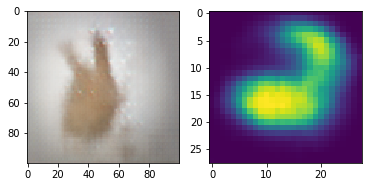

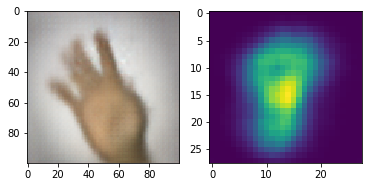

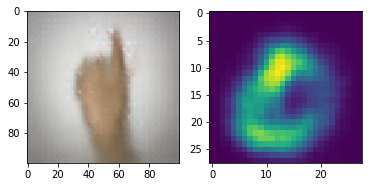

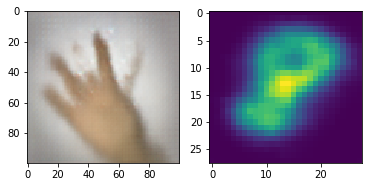

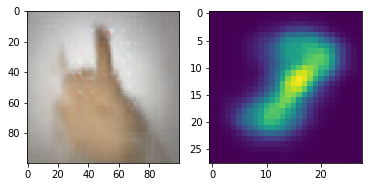

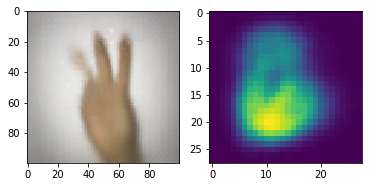

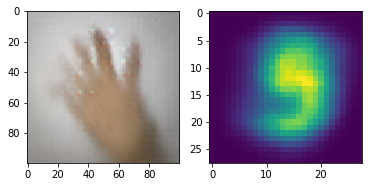

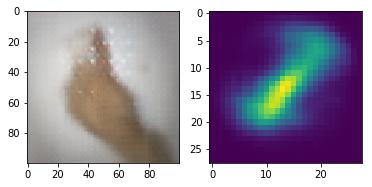

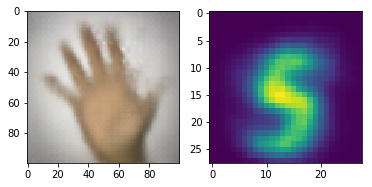

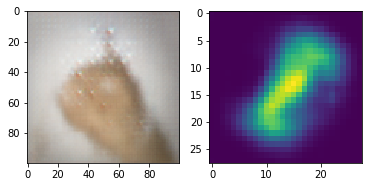

In [0]:
for _ in range(10):
  vec = np.random.multivariate_normal(np.zeros(latent_dim), np.eye(latent_dim))
  vec = vec[np.newaxis,:]

  fig, axes = plt.subplots(1, 2, figsize=(6, 3))
  axes[0].imshow(decoder.predict(vec).reshape(100, 100, 3))
  axes[1].imshow(MNIST_decoder.predict(vec).reshape(28, 28))
plt.show()